In [90]:
# IMPORT PACKAGES
import pandas as pd
from pandas import json_normalize
import requests
from datetime import datetime
import matplotlib.pyplot as plt
from mplsoccer.pitch import Pitch, VerticalPitch
import numpy as np
from matplotlib.patches import FancyArrowPatch
import seaborn as sns
from adjustText import adjust_text
import matplotlib.patches as mpatches
import matplotlib.cm as cm
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import matplotlib.image as mpimg
from PIL import Image, ImageOps

import warnings
warnings.filterwarnings("ignore")

In [138]:
# escludo (...) per vedere tutte le colonne del DataFrame
pd.set_option("display.max.columns",None)

In [3]:
#scegliamo di analizzare la stagione 2015/2016
competition_id = 12
season_id = 27

In [4]:
# MATCH RESULTS
matches = requests.get("https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/matches/"+str(competition_id)+"/"+str(season_id)+".json")
matches = matches.json()

matches_sorted = sorted(matches, key=lambda x: datetime.strptime(x["match_date"], "%Y-%m-%d"))

In [5]:
# MATCH RESULTS
matches = requests.get("https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/matches/"+str(competition_id)+"/"+str(season_id)+".json")
matches = matches.json()

matches_sorted = sorted(matches, key=lambda x: datetime.strptime(x["match_date"], "%Y-%m-%d"))

#focus sulla AS Roma
asroma = "AS Roma"
asroma_matches = []

#visualizziamo le partite della AS Roma e le aggiungiamo ad una nuova lista
for match in matches_sorted:
    if match["home_team"]["home_team_name"] == asroma or match["away_team"]["away_team_name"] == asroma:
        asroma_matches.append(match)
        print(match['home_team']['home_team_name'],"-", match['away_team']['away_team_name'],
          str(match['home_score']) , ":" , str(match['away_score']) , "(match_id: " , str(match['match_id']) , ")")

Hellas Verona - AS Roma 1 : 1 (match_id:  3878541 )
AS Roma - Juventus 2 : 1 (match_id:  3878555 )
Frosinone - AS Roma 0 : 2 (match_id:  3878593 )
AS Roma - Sassuolo 2 : 2 (match_id:  3878607 )
Sampdoria - AS Roma 2 : 1 (match_id:  3879545 )
AS Roma - Carpi 5 : 1 (match_id:  3879547 )
Palermo - AS Roma 2 : 4 (match_id:  3879564 )
AS Roma - Empoli 3 : 1 (match_id:  3879567 )
Fiorentina - AS Roma 1 : 2 (match_id:  3879583 )
AS Roma - Udinese 3 : 1 (match_id:  3879592 )
Inter Milan - AS Roma 1 : 0 (match_id:  3879598 )
AS Roma - Lazio 2 : 0 (match_id:  3879610 )
Bologna - AS Roma 2 : 2 (match_id:  3879617 )
AS Roma - Atalanta 0 : 2 (match_id:  3879632 )
Torino - AS Roma 1 : 1 (match_id:  3879639 )
Napoli - AS Roma 0 : 0 (match_id:  3879651 )
AS Roma - Genoa 2 : 0 (match_id:  3879657 )
Chievo - AS Roma 3 : 3 (match_id:  3879672 )
AS Roma - AC Milan 1 : 1 (match_id:  3879676 )
AS Roma - Hellas Verona 1 : 1 (match_id:  3879691 )
Juventus - AS Roma 1 : 0 (match_id:  3879701 )
AS Roma - Frosin

In [ ]:
# DATA SOURCE
#Trasformo il JSON in un DataFrame con la funzione di Pandas
asroma_df = json_normalize(asroma_matches,sep="_")

asroma_df

,match_id,match_date,kick_off,home_score,away_score,match_status,match_status_360,last_updated,last_updated_360,match_week,competition_competition_id,competition_country_name,competition_competition_name,season_season_id,season_season_name,home_team_home_team_id,home_team_home_team_name,home_team_home_team_gender,home_team_home_team_group,home_team_country_id,home_team_country_name,home_team_managers,away_team_away_team_id,away_team_away_team_name,away_team_away_team_gender,away_team_away_team_group,away_team_country_id,away_team_country_name,away_team_managers,metadata_data_version,metadata_shot_fidelity_version,metadata_xy_fidelity_version,competition_stage_id,competition_stage_name,stadium_id,stadium_name,stadium_country_id,stadium_country_name,referee_id,referee_name,referee_country_id,referee_country_name
0,3878541,2015-08-22,18:00:00.000,1,1,available,unscheduled,2023-03-11T20:21:10.529895,None,1,12,Italy,Serie A,27,2015/2016,226,Hellas Verona,male,None,112,Italy,"[{'id': 1002096, 'name': 'Rafael Márquez Álvar...",229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",1.1.0,2,2,1,Regular Season,4488,Stadio Marc''Antonio Bentegodi,112,Italy,261,Marco Guida,112,Italy
1,3878555,2015-08-30,18:00:00.000,2,1,available,unscheduled,2023-03-17T20:16:12.869818,None,2,12,Italy,Serie A,27,2015/2016,229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",224,Juventus,male,None,112,Italy,"[{'id': 181, 'name': 'Massimiliano Allegri', '...",1.1.0,2,2,1,Regular Season,381,Estadio Olímpico,112,Italy,419,Nicola Rizzoli,112,Italy
2,3878593,2015-09-12,18:00:00.000,0,2,available,unscheduled,2023-08-10T15:16:29.937231,None,3,12,Italy,Serie A,27,2015/2016,291,Frosinone,male,None,112,Italy,"[{'id': 3282, 'name': 'Roberto Stellone', 'nic...",229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",1.1.0,2,2,1,Regular Season,1001324,Stadio Comunale Matusa,112,Italy,1008197,Andrea Gervasoni,112,Italy
3,3878607,2015-09-20,15:00:00.000,2,2,available,unscheduled,2023-03-24T07:23:06.575117,None,4,12,Italy,Serie A,27,2015/2016,229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",232,Sassuolo,male,None,112,Italy,"[{'id': 107, 'name': 'Eusebio Di Francesco', '...",1.1.0,2,2,1,Regular Season,381,Estadio Olímpico,112,Italy,251,Davide Massa,112,Italy
4,3879545,2015-09-23,20:45:00.000,2,1,available,unscheduled,2023-03-29T20:04:17.201245,None,5,12,Italy,Serie A,27,2015/2016,234,Sampdoria,male,None,112,Italy,"[{'id': 273, 'name': 'Walter Zenga', 'nickname...",229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",1.1.0,2,2,1,Regular Season,387,Stadio Comunale Luigi Ferraris,112,Italy,258,Luca Banti,112,Italy
5,3879547,2015-09-26,18:00:00.000,5,1,available,unscheduled,2023-06-24T17:21:49.629250,None,6,12,Italy,Serie A,27,2015/2016,229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",1683,Carpi,male,None,112,Italy,"[{'id': 4149, 'name': 'Fabrizio Castori', 'nic...",1.1.0,2,2,1,Regular Season,381,Estadio Olímpico,112,Italy,270,Massimiliano Irrati,112,Italy
6,3879564,2015-10-04,15:00:00.000,2,4,available,unscheduled,2023-06-17T11:54:54.329674,None,7,12,Italy,Serie A,27,2015/2016,2256,Palermo,male,None,112,Italy,"[{'id': 102, 'name': 'Giuseppe Iachini', 'nick...",229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",1.1.0,2,2,1,Regular Season,4983,Stadio Renzo Barbera,112,Italy,266,Antonio Damato,112,Italy
7,3879567,2015-10-17,18:00:00.000,3,1,available,unscheduled,2023-07-30T12:58:29.091199,None,8,12,Italy,Serie A,27,2015/2016,229,AS Roma,male,None,112,Italy,"[{'id': 265, 'name': 'Rudi Garcia', 'nickname'...",290,Empoli,male,None,112,Italy,"[{'id': 605, 'name': 'Marco Giampaolo', 'nickn...",1.1.0,2,2,1,Regular Season,381,Estadio Olímpico,112,Italy,250,Piero Giacomelli,112,Italy
8,3879583,2015-10-25,18:00:00.000,1,2,available,unscheduled,2023-06-19T13:49:39.642512,

In [8]:
# BUILD TEAM SEASON OVERVIEW
team_season_overview = pd.DataFrame()
for index,row in asroma_df.iterrows():
    
    team_season_overview.at[index,"match_id"] = str(row["match_id"])

    if row["home_team_home_team_name"] == asroma:
        team_season_overview.at[index,"home/away"] = "home"
        current_coach = row["home_team_managers"][0]["name"]
        opponent = row["away_team_away_team_name"]
        gol_scored = str(row["home_score"])
        gol_conceded = str(row["away_score"])

    if row["away_team_away_team_name"] == asroma:
        team_season_overview.at[index,"home/away"] = "away"
        current_coach = row["away_team_managers"][0]["name"]
        opponent = row["home_team_home_team_name"]
        gol_scored = str(row["away_score"])
        gol_conceded = str(row["home_score"])

    team_season_overview.at[index,"coach"] = current_coach
    team_season_overview.at[index,"opponent"] = opponent
    
    if gol_scored > gol_conceded:
        team_season_overview.at[index,"result"] = "Win"
    elif gol_scored < gol_conceded:
        team_season_overview.at[index,"result"] = "Lose"
    else:
        team_season_overview.at[index,"result"] = "Draw"

    team_season_overview.at[index,"goal_scored"] = gol_scored
    team_season_overview.at[index,"goal_conceded"] = gol_conceded
    
    if index == 0:
        if team_season_overview.loc[index,"result"] == "Win":
            team_season_overview.at[index,"points_tracker"] = str(3)
        elif team_season_overview.loc[index,"result"] == "Lose":
            team_season_overview.at[index,"points_tracker"] = str(0)
        else:
            team_season_overview.at[index,"points_tracker"] = str(1)
    
    else:
        punti_prec = team_season_overview.loc[index - 1,"points_tracker"]
        if team_season_overview.loc[index,"result"] == "Win":
            team_season_overview.at[index,"points_tracker"] = str(3 + int(punti_prec ))
        elif team_season_overview.at[index,"result"] == "Lose":
            team_season_overview.at[index,"points_tracker"] = str(0 + int(punti_prec))
        else:
            team_season_overview.at[index,"points_tracker"] = str(1 + int(punti_prec))

team_season_overview

,match_id,home/away,coach,opponent,result,goal_scored,goal_conceded,points_tracker
0,3878541,away,Rudi Garcia,Hellas Verona,Draw,1,1,1
1,3878555,home,Rudi Garcia,Juventus,Win,2,1,4
2,3878593,away,Rudi Garcia,Frosinone,Win,2,0,7
3,3878607,home,Rudi Garcia,Sassuolo,Draw,2,2,8
4,3879545,away,Rudi Garcia,Sampdoria,Lose,1,2,8
5,3879547,home,Rudi Garcia,Carpi,Win,5,1,11
6,3879564,away,Rudi Garcia,Palermo,Win,4,2,14
7,3879567,home,Rudi Garcia,Empoli,Win,3,1,17
8,3879583,away,Rudi Garcia,Fiorentina,Win,2,1,20
9,3879592,home,Rudi Garcia,Udinese,Win,3,1,23


In [6]:
# COACHES
# numero di partite per ogni allenatore
team_season_overview.groupby(by="coach").size()

coach
Luciano Spalletti    19
Rudi Garcia          19
dtype: int64

In [7]:
# BUILD TEAM SEASON OVERVIEW
# per ogni match id carichiamo in un dizionario gli eventi di ciascun match
asroma_events = {}

match_id_lst = list(asroma_df["match_id"])
match_id_lst

for mtc in match_id_lst:
    events = requests.get("https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/"+str(mtc)+".json")
    events = events.json()
    # ogni partita avrà come chiave l'id della partita
    asroma_events[str(mtc)] = json_normalize(events, sep="_")

In [8]:
# aggiungo % possesso palla al team_season_overview
for index,row in team_season_overview.iterrows():
    m_id = row["match_id"]
    m_events = asroma_events[m_id]

    formazione = m_events.loc[:,"team_name":"tactics_formation"]
    formazione = formazione[(formazione["team_name"] == asroma) & formazione["tactics_formation"].notna()]
    modulo = "-".join(str(int(formazione.iloc[0,1])))
    team_season_overview.at[index,"formation"] = modulo

    possession_counts = m_events["possession_team_name"].value_counts()
    total_possession = m_events["possession_team_name"].count()
    possession_percentage = round((possession_counts / total_possession) * 100,1)
    team_season_overview.at[index,"%possession"] = float(possession_percentage["AS Roma"])
    
team_season_overview

,match_id,home/away,coach,opponent,result,goal_scored,goal_conceded,points_tracker,formation,%possession
0,3878541,away,Rudi Garcia,Hellas Verona,Draw,1,1,1,4-3-3,64.7
1,3878555,home,Rudi Garcia,Juventus,Win,2,1,4,4-3-3,63.0
2,3878593,away,Rudi Garcia,Frosinone,Win,2,0,7,4-2-3-1,54.4
3,3878607,home,Rudi Garcia,Sassuolo,Draw,2,2,8,4-2-3-1,66.0
4,3879545,away,Rudi Garcia,Sampdoria,Lose,1,2,8,4-3-3,67.3
5,3879547,home,Rudi Garcia,Carpi,Win,5,1,11,4-3-3,68.3
6,3879564,away,Rudi Garcia,Palermo,Win,4,2,14,4-4-1-1,59.2
7,3879567,home,Rudi Garcia,Empoli,Win,3,1,17,4-4-2,57.2
8,3879583,away,Rudi Garcia,Fiorentina,Win,2,1,20,4-3-3,28.0
9,3879592,home,Rudi Garcia,Udinese,Win,3,1,23,4-3-3,63.0


In [9]:
# aggiungo tiri totali - tiri in porta - tiri fuori al team_season_overview
# aggiungo pali/traverse colpite
# aggiungo totale xG per ogni partita
for index,row in team_season_overview.iterrows():
    m_id = row["match_id"]
    m_events = asroma_events[m_id]
    m_shots = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == asroma)]
    team_season_overview.at[index,"total_shots"] = str(len(m_shots)) #tiri totali

    onT = ["Saved", "Saved to Post","Goal"]
    m_shotsOnT = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == asroma) & (m_events["shot_outcome_name"].isin(onT))]
    team_season_overview.at[index,"on_target"] = str(len(m_shotsOnT)) #tiri in porta

    team_season_overview.at[index,"off_target"] = str(len(m_shots) - len(m_shotsOnT)) #tiri fuori

    post = ["Saved to Post","Post"]
    m_shotsOnPost = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == asroma) & (m_events["shot_outcome_name"].isin(post))]
    team_season_overview.at[index,"on_post"] = str(len(m_shotsOnPost)) #palo/traversa

    m_goalPenalty = m_shots[m_shots["shot_type_name"] == "Penalty"]
    team_season_overview.at[index,"penalties"] = str(len(m_goalPenalty)) #rigori

    shotOnT_percentage = round((len(m_shotsOnT) / len(m_shots)) * 100, 1)
    team_season_overview.at[index,"%shot_precision"] = float(shotOnT_percentage)

    # xG_mean = np.mean(m_shots["shot_statsbomb_xg"])
    # team_season_overview.at[index,"xG_mean"] = xG_mean # media xG

    xG_sum = np.sum(m_shots["shot_statsbomb_xg"])
    xG_mean = np.mean(m_shots["shot_statsbomb_xg"])
    xG_goals_sum = np.sum(m_shots[m_shots["shot_outcome_name"] == "Goal"]["shot_statsbomb_xg"])
    xG_goals_mean = np.mean(m_shots[m_shots["shot_outcome_name"] == "Goal"]["shot_statsbomb_xg"])
    team_season_overview.at[index,"total_xG"] = xG_sum # xG totale
    team_season_overview.at[index,"mean_xG"] = xG_mean #  xG medio, per capire che tipi di tiri eseguono mediamente
    team_season_overview.at[index,"total_xG_goals"] = xG_goals_sum # xG totale
    team_season_overview.at[index,"mean_xG_goals"] = xG_goals_mean #  xG medio, per capire che tipi di tiri eseguono mediamente

team_season_overview

,match_id,home/away,coach,opponent,result,goal_scored,goal_conceded,points_tracker,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals
0,3878541,away,Rudi Garcia,Hellas Verona,Draw,1,1,1,4-3-3,64.7,21,7,14,1,0,33.3,1.114252,0.053060,0.013221,0.013221
1,3878555,home,Rudi Garcia,Juventus,Win,2,1,4,4-3-3,63.0,18,7,11,1,0,38.9,1.203531,0.066863,0.271479,0.135739
2,3878593,away,Rudi Garcia,Frosinone,Win,2,0,7,4-2-3-1,54.4,20,3,17,1,0,15.0,1.537926,0.076896,0.490753,0.245377
3,3878607,home,Rudi Garcia,Sassuolo,Draw,2,2,8,4-2-3-1,66.0,21,7,14,0,0,33.3,2.405741,0.114559,0.423324,0.211662
4,3879545,away,Rudi Garcia,Sampdoria,Lose,1,2,8,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813
5,3879547,home,Rudi Garcia,Carpi,Win,5,1,11,4-3-3,68.3,17,10,7,1,0,58.8,3.369605,0.198212,2.067332,0.413466
6,3879564,away,Rudi Garcia,Palermo,Win,4,2,14,4-4-1-1,59.2,13,8,5,0,0,61.5,2.376904,0.182839,1.243286,0.310822
7,3879567,home,Rudi Garcia,Empoli,Win,3,1,17,4-4-2,57.2,10,5,5,0,0,50.0,1.009133,0.100913,0.473221,0.157740
8,3879583,away,Rudi Garcia,Fiorentina,Win,2,1,20,4-3-3,28.0,6,3,3,0,0,50.0,1.130542,0.188424,0.591478,0.295739
9,3879592,home,Rudi Garcia,Udinese,Win,3,1,23,4-3-3,63.0,19,8,11,0,0,42.1,1.497169,0.078798,0.472224,0.157408


In [10]:
# aggiungo passaggi totali - completati - non completati al team_season_overview
# aggiungo numero di passaggi in fuorigioco
for index,row in team_season_overview.iterrows():
    m_id = row["match_id"]
    m_events = asroma_events[m_id]
    m_passes = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == asroma)]
    team_season_overview.at[index,"total_passes"] = str(len(m_passes)) #passaggi totali

    m_passes_completed = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == asroma) & (m_events["pass_outcome_name"].isna())]
    team_season_overview.at[index,"correct_passes"] = str(len(m_passes_completed)) #passaggi corretti

    team_season_overview.at[index,"uncorrect_passes"] = str(len(m_passes) - len(m_passes_completed)) #passaggi non corretti

    team_season_overview.at[index,"offsides"] = str(len(m_passes[m_passes["pass_outcome_name"] == "Pass Offside"]))

    passes_percentage = round((len(m_passes_completed) / len(m_passes)) * 100, 1)
    team_season_overview.at[index,"%pass_precision"] = float(passes_percentage)

team_season_overview["team_name"] = asroma
team_season_overview = team_season_overview.set_index("team_name")
team_season_overview

,match_id,home/away,coach,opponent,result,goal_scored,goal_conceded,points_tracker,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision
team_name,,,,,,,,,,,,,,,,,,,,,,,,,
AS Roma,3878541,away,Rudi Garcia,Hellas Verona,Draw,1,1,1,4-3-3,64.7,21,7,14,1,0,33.3,1.114252,0.053060,0.013221,0.013221,591,503,88,1,85.1
AS Roma,3878555,home,Rudi Garcia,Juventus,Win,2,1,4,4-3-3,63.0,18,7,11,1,0,38.9,1.203531,0.066863,0.271479,0.135739,614,511,103,1,83.2
AS Roma,3878593,away,Rudi Garcia,Frosinone,Win,2,0,7,4-2-3-1,54.4,20,3,17,1,0,15.0,1.537926,0.076896,0.490753,0.245377,451,338,113,0,74.9
AS Roma,3878607,home,Rudi Garcia,Sassuolo,Draw,2,2,8,4-2-3-1,66.0,21,7,14,0,0,33.3,2.405741,0.114559,0.423324,0.211662,607,512,95,2,84.3
AS Roma,3879545,away,Rudi Garcia,Sampdoria,Lose,1,2,8,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813,582,481,101,0,82.6
AS Roma,3879547,home,Rudi Garcia,Carpi,Win,5,1,11,4-3-3,68.3,17,10,7,1,0,58.8,3.369605,0.198212,2.067332,0.413466,729,633,96,0,86.8
AS Roma,3879564,away,Rudi Garcia,Palermo,Win,4,2,14,4-4-1-1,59.2,13,8,5,0,0,61.5,2.376904,0.182839,1.243286,0.310822,632,536,96,4,84.8
AS Roma,3879567,home,Rudi Garcia,Empoli,Win,3,1,17,4-4-2,57.2,10,5,5,0,0,50.0,1.009133,0.100913,0.473221,0.157740,623,513,110,4,82.3
AS Roma,3879583,away,Rudi Garcia,Fiorentina,Win,2,1,20,4-3-3,28.0,6,3,3,0,0,50.0,1.130542,0.188424,0.591478,0.295739,313,205,108,0,65.5


In [75]:
# PLAYERS SEASON OVERVIEW
# creo il dataframe che conterrà tutti i dati di interesse
players_season_overview = pd.DataFrame()

# popoliamo il dataframe dei giocatori (players_season_overview)
# iniziamo ad aggiungere i giocatori , se titolari , se subentrati (primo o secondo tempo) ed i minuti giocati
for index,row in team_season_overview.iterrows():
    m_id = row["match_id"]
    m_events = asroma_events[m_id]
    m_events = m_events[m_events["team_name"] == asroma]
    m_events["timestamp"] = pd.to_timedelta(m_events["timestamp"])
    m_players = m_events[(m_events["team_name"] == asroma) & (m_events["player_name"].notna())]["player_name"].unique()
    m_overview = pd.DataFrame(index=m_players)


    for p in m_players:
        #aggiungo id della partita
        m_overview.at[p,"match_id"] = m_id

        min_tot = m_events.groupby("period")["timestamp"].max() #minuti raggruppati per tempo
        min_1Half = min_tot.values[0] #estratto i minuti del primo e secondo tempo
        min_2Half = min_tot.values[1]

        if (m_events["substitution_replacement_name"] == p).any():
            sub = m_events[m_events["substitution_replacement_name"] == p] #prendo la riga che come evento la sostituzione del player p
            m_overview.at[p,"is_starter"] = False #non è titolare
            m_overview.at[p,"period_subbedIn"] = str(sub["period"].values[0]) #salvo il tempo in cui è subentrato
            min_subbedIn = sub["timestamp"]
            
            if (sub["period"] == 1).any():
                fullTime_min = ((min_1Half - min_subbedIn) + min_2Half).sum().total_seconds() / 60
            else:
                fullTime_min = ((min_2Half - min_subbedIn)).sum().total_seconds() / 60
        else:
            m_overview.at[p,"is_starter"] = True
            fullTime_min = min_tot.sum().total_seconds() / 60
        m_overview.at[p,"min_played"] = round(fullTime_min,2)
    
    # aggiungiamo i ruoli ricoperti durante la partita
    m_overview["positions"] = m_events[m_events["team_name"] == asroma].groupby("player_name")["position_name"].unique()

    # aggiungiamo i tiri, gol, ecc...
    m_shots = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == asroma)]
    total_shots = m_shots["player_name"].value_counts()

    m_shotsOnT = m_shots[m_shots["shot_outcome_name"].isin(onT)]
    total_shotsOnT = m_shotsOnT["player_name"].value_counts()
    
    m_shotsOnPost = m_shots[m_shots["shot_outcome_name"].isin(post)]
    total_shotsOnPost = m_shotsOnPost["player_name"].value_counts()

    m_goals = m_shots[m_shots["shot_outcome_name"] == "Goal"]
    total_goals = m_goals["player_name"].value_counts()

    # m_goals_pattern = m_goals[["player_name","play_pattern_name"]].set_index("player_name")
    # m_goals_typename = m_goals[["player_name","shot_type_name"]].set_index("player_name")

    m_goalPenalty = m_goals[m_goals["shot_type_name"] == "Penalty"]
    total_pen = m_goalPenalty["player_name"].value_counts()

    for player, nshot in total_shots.items():
        m_overview.at[player,"total_shots"] = str(nshot)
    
    for player, nshot in total_shotsOnT.items():
        p_shots = m_overview.loc[player,"total_shots"]
        m_overview.at[player,"on_target"] = str(nshot)
        m_overview.at[player,"off_target"] = str(int(p_shots)-nshot)
        m_overview.at[player,"%shots_precision"] = str(round(nshot/int(p_shots) * 100,1))

    for player, nshot in total_shotsOnPost.items():
        m_overview.at[player,"on_post"] = str(nshot)
    
    if list(total_goals.items()) == []:
        m_overview.at[player,"goals"] = np.nan
    else:
        for player, goal in total_goals.items():
            m_overview.at[player,"goals"] = str(goal)    
    
    if list(total_pen.items()) == []:
        m_overview.at[player,"goals_penalties"] = np.nan
    else:
        for player, pen in total_pen.items():
            m_overview.at[player,"goals_penalties"] = str(pen)

    xG_sum = m_shots.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei tiri per ogni giocatore
    xG_mean = m_shots.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei tiri per ogni giocatore
    xG_goals_sum = m_goals.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei goal per ogni giocatore
    xG_goals_mean = m_goals.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei goal per ogni giocatore

    m_overview["total_xG"] = xG_sum                 #altro metodo per assegnare la colonna senza ciclo for
    m_overview["mean_xG"] = xG_mean
    m_overview["total_xG_goals"] = xG_goals_sum
    m_overview["mean_xG_goals"] = xG_goals_mean
    
    # aggiungiamo i passaggi, assist...
    m_passes = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == asroma)]
    total_passes = m_passes["player_name"].value_counts()
    correct_passes = m_passes[m_passes["pass_outcome_name"].isna()]["player_name"].value_counts()
    offsides = m_passes[m_passes["pass_outcome_name"] == "Pass Offside"]["pass_recipient_name"].value_counts()

    m_overview["total_passes"] = total_passes
    m_overview["correct_passes"] = correct_passes
    m_overview["wrong_passes"] = total_passes - correct_passes
    m_overview["%pass_precision"] = round((correct_passes/total_passes) * 100,2)

    for player, offs in offsides.items():
        m_overview.at[player, "offsides"] = offs

    if "pass_goal_assist" in m_passes.columns:
        m_assists = m_passes[m_passes['pass_goal_assist'] == True]

    if not m_assists.empty:
        total_assists = m_assists["player_name"].value_counts()

        for player, assist in total_assists.items():
            m_overview.at[player,"assists"] = assist
    else:
        m_overview.at[player,"assists"] = np.nan
        
    
    # aggiungiamo dribbling, ...
    m_dribblings = m_events[(m_events["type_name"] == "Dribble") & (m_events["team_name"] == asroma)]
    total_dribblings = m_dribblings["player_name"].value_counts()
    completed_dribblings = m_dribblings[m_dribblings["dribble_outcome_name"] == "Complete"]["player_name"].value_counts()

    m_overview["total_dribblings"] = total_dribblings
    m_overview["completed_dribblings"] = completed_dribblings
    m_overview["uncompleted_dribblings"] = total_dribblings - completed_dribblings
    m_overview["%dribbling_precision"] = round((completed_dribblings/total_dribblings)*100,2)

    # aggiungiamo la posizione media occupata dal giocatore
    for p,l in m_events[["player_name","location"]].groupby("player_name"):
        x_loc_mean = round(l["location"].apply(lambda loc: loc[0]if isinstance(loc, list) else None).mean(),1)
        y_loc_mean = round(l["location"].apply(lambda loc: loc[1]if isinstance(loc, list) else None).mean(),1)
        m_overview.at[p,"x_location_mean"] = x_loc_mean
        m_overview.at[p,"y_location_mean"] = y_loc_mean

    # aggiungiamo la colonna con tutte le posizioni in cui il giocatore ha effettuato un evento (qualsiasi) - per HeatMap
    player_positions = []
    m_overview["all_positions"] = None

    for p, l in m_events[["player_name", "location"]].groupby("player_name"):
        # Raccogliamo tutte le posizioni per ciascun evento (anche le ripetizioni)
        positions_list = l["location"].apply(lambda loc: loc if isinstance(loc, list) else None).dropna().tolist()
        #print(positions_list)
        #player_positions.append((p, positions_list))
        m_overview.at[p, "all_positions"] = positions_list

    players_season_overview = pd.concat([players_season_overview,m_overview])

players_season_overview

,match_id,is_starter,min_played,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,on_post,goals,goals_penalties,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,wrong_passes,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions
Vassilis Torosidis,3878541,True,94.02,NaN,[Left Back],1,NaN,NaN,NaN,NaN,NaN,NaN,0.009657,0.009657,NaN,NaN,39.0,31.0,8.0,79.49,NaN,NaN,NaN,NaN,NaN,NaN,64.1,16.6,"[[47.4, 16.4], [31.5, 5.6], [26.6, 1.6], [72.5..."
Wojciech Szczęsny,3878541,True,94.02,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.0,27.0,1.0,96.43,NaN,NaN,NaN,NaN,NaN,NaN,10.5,40.6,"[[6.0, 36.0], [2.8, 41.6], [6.0, 36.0], [8.2, ..."
Edin Džeko,3878541,True,94.02,NaN,[Center Forward],6,1,5,16.7,NaN,NaN,NaN,0.294617,0.049103,NaN,NaN,37.0,28.0,9.0,75.68,1.0,1.0,NaN,NaN,NaN,NaN,83.8,44.1,"[[72.5, 25.2], [72.5, 25.2], [72.8, 25.2], [71..."
Gervais Lombe Yao Kouassi,3878541,True,94.02,NaN,"[Right Wing, Left Wing]",1,NaN,NaN,NaN,NaN,NaN,NaN,0.031721,0.031721,NaN,NaN,31.0,25.0,6.0,80.65,NaN,NaN,4.0,3.0,1.0,75.00,84.3,43.8,"[[80.8, 14.4], [81.7, 75.8], [81.7, 75.8], [82..."
Daniele De Rossi,3878541,True,94.02,NaN,[Center Defensive Midfield],1,NaN,NaN,NaN,NaN,NaN,NaN,0.005715,0.005715,NaN,NaN,69.0,59.0,10.0,85.51,NaN,NaN,NaN,NaN,NaN,NaN,53.2,44.9,"[[62.7, 32.6], [26.6, 42.0], [30.9, 40.8], [48..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Konstantinos Manolas,3879869,True,93.31,NaN,"[Right Center Back, Center Back]",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49.0,45.0,4.0,91.84,NaN,NaN,NaN,NaN,NaN,NaN,38.6,50.7,"[[65.2, 53.6], [65.2, 53.6], [56.0, 55.8], [76..."
Wojciech Szczęsny,3879869,True,93.31,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.0,30.0,4.0,88.24,NaN,NaN,NaN,NaN,NaN,NaN,9.3,38.8,"[[3.7, 29.3], [3.7, 29.3], [4.5, 25.2], [21.2,..."
Francesco Totti,3879869,False,31.13,2,"[Center Attacking Midfield, Left Center Forwar...",3,1,2,33.3,NaN,NaN,NaN,0.136230,0.045410,NaN,NaN,28.0,20.0,8.0,71.43,NaN,NaN,1.0,1.0,0.0,100.00,74.4,49.5,"[[104.7, 51.4], [104.3, 49.3], [98.7, 20.9], [..."
Emerson Palmieri dos Santos,3879869,False,15.37,2,"[Left Center Midfield, Left Wing Back]",1,1,0,100.0,NaN,1,NaN,0.856661,0.856661,0.856661,0.856661,3.0,2.0,1.0,66.67,NaN,NaN,1.0,NaN,NaN,NaN,57.9,14.6,"[[22.9, 46.3], [35.5, 4.3], [56.0, 4.3], [56.2..."


In [12]:

season_merged = pd.merge(team_season_overview[["match_id","home/away","coach","opponent","result"]], players_season_overview.reset_index(), on="match_id").set_index("index").infer_objects().fillna(0)
players_overview = pd.merge(team_season_overview["match_id"], players_season_overview.reset_index(), on="match_id").set_index("index").infer_objects().fillna(0)


In [13]:
# CONVERTING DATA TYPES
cols_to_convert = [
    "total_passes", 
    "correct_passes", 
    "wrong_passes", 
    "offsides", 
    "total_dribblings", 
    "completed_dribblings", 
    "uncompleted_dribblings",
    "goals",
    "goals_penalties",
    "on_post",
    "total_shots",
    "on_target",
    "off_target",
    "assists"
]

season_merged[cols_to_convert] = season_merged[cols_to_convert].astype('int64')
team_season_overview["points_tracker"] = team_season_overview["points_tracker"].astype("int64")
team_season_overview["goal_conceded"] = team_season_overview["goal_conceded"].astype("int64")
team_season_overview["goal_scored"] = team_season_overview["goal_scored"].astype("int64")
team_season_overview["total_shots"] = team_season_overview["total_shots"].astype("int64")
team_season_overview["total_passes"] = team_season_overview["total_passes"].astype("int64")
team_season_overview["offsides"] = team_season_overview["offsides"].astype("int64")

In [124]:
# CREATING PLAYERS DIMENSION

# dizionario contenente tutte le informazioni sui giocatori
players_info = {
    "Vassilis Torosidis": {"birthday": "1985-05-10", "role": "Defender", "nationality": "Greece", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Torosidis1516.jpg"},
    "Wojciech Szczęsny": {"birthday": "1990-04-18", "role": "Goalkeeper", "nationality": "Poland", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Szczesny1516.jpg"},
    "Edin Džeko": {"birthday": "1986-03-17", "role": "Attacker", "nationality": "Bosnia and Herzegovina", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Dzeko1516.jpg"},
    "Gervais Lombe Yao Kouassi": {"birthday": "1987-05-27", "role": "Attacker", "nationality": "Ivory Coast", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Gervinho1516.jpg"},
    "Daniele De Rossi": {"birthday": "1983-07-24", "role": "Midfielder", "nationality": "Italy", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/DeRossi1516.jpg"},
    "Miralem Pjanić": {"birthday": "1990-04-02", "role": "Midfielder", "nationality": "Bosnia and Herzegovina", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Pjanic1516.jpg"},
    "Radja Nainggolan": {"birthday": "1988-05-04", "role": "Midfielder", "nationality": "Belgium", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Nainggolan1516.jpg"},
    "Mohamed Salah": {"birthday": "1992-06-15", "role": "Attacker", "nationality": "Egypt", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Salah1516.jpg"},
    "Leandro Castán da Silva": {"birthday": "1986-11-05", "role": "Defender", "nationality": "Brazil", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Castan1516.jpg"},
    "Konstantinos Manolas": {"birthday": "1991-03-14", "role": "Defender", "nationality": "Greece", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Manolas1516.jpg"},
    "Alessandro Florenzi": {"birthday": "1991-03-11", "role": "Midfielder", "nationality": "Italy", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Florenzi1516.jpg"},
    "Seydou Kéita": {"birthday": "1980-01-16", "role": "Midfielder", "nationality": "Mali", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Keita1516.jpg"},
    "Iago Falqué Silva": {"birthday": "1990-01-04", "role": "Midfielder", "nationality": "Spain", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/IagoFalque1516.jpg"},
    "Segundo Víctor Ibarbo Guerrero": {"birthday": "1990-05-19", "role": "Attacker", "nationality": "Colombia", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Ibarbo1516.jpg"},
    "Lucas Digne": {"birthday": "1993-07-20", "role": "Defender", "nationality": "France", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Digne1516.jpg"},
    "Juan Manuel Iturbe Arévalo": {"birthday": "1993-06-04", "role": "Attacker", "nationality": "Paraguay", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Iturbe1516.jpg"},
    "Adem Ljajić": {"birthday": "1991-09-29", "role": "Midfielder", "nationality": "Serbia", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Ljajic1516.jpg"},
    "Francesco Totti": {"birthday": "1976-09-27", "role": "Attacker", "nationality": "Italy", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Totti1516.jpg"},
    "Antonio Rüdiger": {"birthday": "1993-03-03", "role": "Defender", "nationality": "Germany", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Rudiger1516.jpg"},
    "Maicon Douglas Sisenando": {"birthday": "1981-07-26", "role": "Defender", "nationality": "Brazil", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Maicon1516.jpg"},
    "Morgan De Sanctis": {"birthday": "1977-03-26", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/DeSanctis1516.jpg"},
    "Salih Uçan": {"birthday": "1994-01-06", "role": "Midfielder", "nationality": "Turkey", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Ucan1516.jpg"},
    "William Vainqueur": {"birthday": "1988-11-19", "role": "Midfielder", "nationality": "France", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Vainqueur1516.jpg"},
    "Emerson Palmieri dos Santos": {"birthday": "1994-08-03", "role": "Defender", "nationality": "Brazil", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/EmersonPalmieri1516.jpg"},
    "Norbert Gyömbér": {"birthday": "1992-07-03", "role": "Defender", "nationality": "Slovakia", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Gyomber1516.jpg"},
    "Umar Sadiq Mesbah": {"birthday": "1997-02-02", "role": "Attacker", "nationality": "Nigeria", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Sadiq1516.jpg"},
    "Lorenzo Di Livio": {"birthday": "1997-01-11", "role": "Midfielder", "nationality": "Italy", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/DiLivioLorenzo1617.jpg"},
    "Marco Tumminello": {"birthday": "1998-11-06", "role": "Attacker", "nationality": "Italy", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Tumminello1617.jpg"},
    "Ervin Zukanović": {"birthday": "1987-02-11", "role": "Defender", "nationality": "Bosnia and Herzegovina", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Zukanovic1516.jpg"},
    "Stephan El Shaarawy": {"birthday": "1992-10-27", "role": "Attacker", "nationality": "Italy", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/ElShaarawy1516.jpg"},
    "Diego Perotti": {"birthday": "1988-07-26", "role": "Attacker", "nationality": "Argentina", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Perotti1516.jpg"},
    "Kevin Strootman": {"birthday": "1990-02-13", "role": "Midfielder", "nationality": "Netherlands", "image_url": "https://www.almanaccogiallorosso.it/Giocatori/Strootman1516.jpg"}
    }


players_info.update({
    'Kingsley Coman': {"birthday": "1996-06-13", "role": "Attacker", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/big/243714-1700040256.jpg?lm=1"},
    'Mario Mandžukić': {"birthday": "1986-05-21", "role": "Attacker", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/34572-1669305573.jpg?lm=1"},
    'Simone Padoin': {"birthday": "1984-01-18", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56703-1448465244.jpg?lm=1"},
    'Andrea Barzagli': {"birthday": "1981-05-08", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/7109-1416219029.jpg?lm=1"},
    'Leonardo Bonucci': {"birthday": "1987-05-01", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39983-1693590039.jpg?lm=1"},
    'Patrice Evra': {"birthday": "1981-05-15", "role": "Defender", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5285-1416219199.jpg?lm=1"},
    'Giorgio Chiellini': {"birthday": "1984-08-14", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/29260-1678025858.jpg?lm=1"},
    'Gianluigi Buffon': {"birthday": "1978-01-28", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/header/5023-1713425275.jpg?lm=1"},
    'Paul Pogba': {"birthday": "1993-03-15", "role": "Midfielder", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/122153-1730124602.jpg?lm=1"},
    'Stephan Lichtsteiner': {"birthday": "1984-01-16", "role": "Defender", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/2865-1410245791.jpg?lm=1"},
    'Roberto Maximiliano Pereyra': {"birthday": "1991-01-07", "role": "Midfielder", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/112302-1728415731.png?lm=1"},
    'Paulo Bruno Exequiel Dybala': {"birthday": "1993-11-15", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/206050-1725530843.jpg?lm=1"},
    'Fernando Llorente Torres': {"birthday": "1985-02-26", "role": "Attacker", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/35564-1447240179.jpg?lm=1"},
    'Mauricio Aníbal Isla Isla': {"birthday": "1988-06-12", "role": "Defender", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/43722-1718986946.jpg?lm=1"},
    'José Martín Cáceres Silva': {"birthday": "1987-04-07", "role": "Defender", "nationality": "Uruguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/54935-1709930415.jpg?lm=1"},
    'Stefano Sturaro': {"birthday": "1993-03-09", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/167859-1701772192.png?lm=1"},
    'Álvaro Borja Morata Martín': {"birthday": "1992-10-23", "role": "Attacker", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/128223-1719989301.jpg?lm=1"},
    'Rubens Fernando Moedim': {"birthday": "1982-08-04", "role": "Goalkeeper", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/37598-1455553896.jpg?lm=1"},
    'Juan Guillermo Cuadrado Bello': {"birthday": "1988-05-26", "role": "Attacker", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/91970-1663576912.jpg?lm=1"},
    'Anderson Hernanes de Carvalho Andrade': {"birthday": "1985-05-29", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/52897-1410955079.jpg?lm=1"},
    'Claudio Marchisio': {"birthday": "1986-01-19", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/44716-1557249476.png?lm=1"},
    'Alex Sandro Lobo Silva': {"birthday": "1991-01-26", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/79960-1661351746.jpg?lm=1"},
    'Mario Lemina': {"birthday": "1993-09-01", "role": "Midfielder", "nationality": "Gabon", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/170934-1667549900.jpg?lm=1"},
    'Simone Zaza': {"birthday": "1991-06-25", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/96828-1596184084.jpg?lm=1"},
    'Norberto Murara Neto': {"birthday": "1989-07-19", "role": "Goalkeeper", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/header/111819-1725051877.jpg?lm=1"},
    'Sami Khedira': {"birthday": "1987-04-04", "role": "Midfielder", "nationality": "Germany", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/29401-1595418857.jpg?lm=1"},
    'Kwadwo Asamoah': {"birthday": "1988-12-09", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/63531-1455553903.jpg?lm=1"},
    'Daniele Rugani': {"birthday": "1994-07-29", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/162959-1595858253.jpg?lm=1"},
    'Gonzalo Gerardo Higuaín': {"birthday": "1987-12-10", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39153-1595579337.jpg?lm=1"},
    'Dries Mertens': {"birthday": "1987-05-06", "role": "Attacker", "nationality": "Belgium", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56416-1671109411.png?lm=1"},
    'Raúl Albiol i Tortajada': {"birthday": "1985-09-04", "role": "Defender", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/15452-1664974689.jpg?lm=1"},
    'Vlad Iulian Chiricheș': {"birthday": "1989-11-14", "role": "Defender", "nationality": "Romania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/123261-1732266370.png?lm=1"},
    'Christian Maggio': {"birthday": "1982-02-11", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21151-1455552087.jpg?lm=1"},
    'Lorenzo Insigne': {"birthday": "1991-06-04", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/133964-1740819475.jpg?lm=1"},
    'Mirko Valdifiori': {"birthday": "1986-04-21", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84903-1700049819.jpg?lm=1"},
    'Elseid Hysaj': {"birthday": "1994-02-02", "role": "Defender", "nationality": "Albania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/200056-1661350737.jpg?lm=1"},
    'Marek Hamšík': {"birthday": "1987-07-27", "role": "Midfielder", "nationality": "Slovakia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/38593-1630526043.png?lm=1"}
})

players_info.update({
    'David López Silva': {"birthday": "1989-10-09", "role": "Midfielder", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/129444-1448529645.jpg?lm=1"},
    'José Manuel Reina Páez': {"birthday": "1982-08-31", "role": "Goalkeeper", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/7825-1724826388.jpg?lm=1"},
    'Manolo Gabbiadini': {"birthday": "1991-11-26", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/112343-1663679945.jpg?lm=1"},
    'Omar El Kaddouri': {"birthday": "1990-08-21", "role": "Midfielder", "nationality": "Morocco", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/73097-1613847346.jpg?lm=1"},
    'José María Callejón Bueno': {"birthday": "1987-02-11", "role": "Attacker", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/61253-1602070711.jpg?lm=1"},
    'Kalidou Koulibaly': {"birthday": "1991-06-20", "role": "Defender", "nationality": "Senegal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/93128-1697050549.png?lm=1"},
    'Allan Marques Loureiro': {"birthday": "1991-01-08", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/126422-1448529525.jpg?lm=1"},
    'Jorge Luiz Frello Filho': {"birthday": "1992-12-20", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/102017-1682590896.jpg?lm=1"},
    'Faouzi Ghoulam': {"birthday": "1991-02-01", "role": "Defender", "nationality": "Algeria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/126656-1696432810.png?lm=1"},
    'Nathaniel Chalobah': {"birthday": "1995-12-12", "role": "Midfielder", "nationality": "England", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/128900-1651652768.jpg?lm=1"},
    'Ivan Strinić': {"birthday": "1987-07-17", "role": "Defender", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39799-1448529312.jpg?lm=1"},
    'Gabriel Vasconelos Ferreira': {"birthday": "1992-09-27", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/79242-1633101492.jpg?lm=1"},
    'Vasco Regini': {"birthday": "1990-09-09", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/72274-1663959711.jpg?lm=1"},
    'Rodrigo Sebastián Palacio': {"birthday": "1982-02-05", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39099-1410955127.jpg?lm=1"},
    'Juan Guilherme Nunes Jesus': {"birthday": "1994-06-10", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/121985-1630496408.jpg?lm=1"},
    'Geoffrey Kondogbia': {"birthday": "1993-02-15", "role": "Midfielder", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/127189-1703066053.jpg?lm=1"},
    'Jeison Fabián Murillo Cerón': {"birthday": "1992-05-27", "role": "Defender", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/131102-1739290856.jpg?lm=1"},
    'Assane Demoya Gnoukouri': {"birthday": "1996-09-28", "role": "Midfielder", "nationality": "Ivory Coast", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/336704-1448967514.jpg?lm=1"},
    'João Miranda de Souza Filho': {"birthday": "1984-09-07", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/33357-1448967043.jpg?lm=1"},
    'Samir Handanovič': {"birthday": "1984-07-14", "role": "Goalkeeper", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/28021-1686929975.jpg?lm=1"},
    'Davide Santon': {"birthday": "1991-01-02", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84344-1595927717.jpg?lm=1"},
    'Gary Alexis Medel Soto': {"birthday": "1987-08-03", "role": "Midfielder", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/60889-1630574292.jpg?lm=1"},
    'Mauro Emanuel Icardi Rivero': {"birthday": "1993-02-19", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/68863-1671105169.png?lm=1"},
    'Marcelo Brozović': {"birthday": "1992-11-16", "role": "Midfielder", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/156617-1661352678.jpg?lm=1"},
    'Stevan Jovetić': {"birthday": "1989-11-02", "role": "Attacker", "nationality": "Montenegro", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/46104-1732288884.jpg?lm=1"},
    'Rey Manaj': {"birthday": "1997-02-24", "role": "Attacker", "nationality": "Albania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/308278-1724077102.png?lm=1"},
    'Fredy Alejandro Guarín Vásquez': {"birthday": "1986-06-30", "role": "Midfielder", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39090-1410339957.jpg?lm=1"},
    'Yuto Nagatomo': {"birthday": "1986-09-12", "role": "Defender", "nationality": "Japan", "image_url": "https://img.a.transfermarkt.technology/portrait/small/79522-1572951921.jpg?lm=1"},
    'Andrea Ranocchia': {"birthday": "1988-02-16", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/44327-1663659408.jpg?lm=1"},
    'Ivan Perišić': {"birthday": "1989-02-02", "role": "Attacker", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/42460-1667991317.jpg?lm=1"},
    'Felipe Melo de Carvalho': {"birthday": "1983-06-26", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/35537-1448967266.jpg?lm=1"},
    'Alex Nicolao Telles': {"birthday": "1992-12-15", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/255755-1659559306.jpg?lm=1"},
    'Jonathan Ludovic Biabiany': {"birthday": "1988-04-28", "role": "Attacker", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/45567-1448967724.jpg?lm=1"},
    "Danilo D''Ambrosio": {"birthday": "1988-09-09", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/55769-1595925735.jpg?lm=1"},
    'Martín Montoya Torralbo': {"birthday": "1991-04-14", "role": "Defender", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/68645-1691487947.jpg?lm=1"},
    'Eder Citadin Martins': {"birthday": "1986-11-15", "role": "Attacker", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/37418-1609843623.jpg?lm=1"}
})

players_info.update({
    'Juan Pablo Carrizo': {"birthday": "1984-05-06", "role": "Goalkeeper", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39118-1410340416.jpg?lm=1"},
    'Ionuț Andrei Radu': {"birthday": "1997-05-28", "role": "Goalkeeper", "nationality": "Romania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/303657-1699432718.jpg?lm=1"},
    'Fabio Della Giovanna': {"birthday": "1997-03-21", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/291392-1505224934.jpg?lm=1"},
    'Ştefan Daniel Radu': {"birthday": "1986-10-22", "role": "Defender", "nationality": "Romania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/44420-1688474820.jpg?lm=1"},
    'Ricardo Kishna': {"birthday": "1995-01-04", "role": "Attacker", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/159026-1448468222.jpg?lm=1"},
    'Antonio Candreva': {"birthday": "1987-02-28", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/25488-1630591271.jpg?lm=1"},
    'Keita Baldé Diao': {"birthday": "1995-03-08", "role": "Attacker", "nationality": "Senegal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/238752-1726065554.png?lm=1"},
    'Santiago Juan Gentiletti Selak': {"birthday": "1985-01-09", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/30782-1411570442.jpg?lm=1"},
    'Lucas Rodrigo Biglia': {"birthday": "1986-01-30", "role": "Midfielder", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/26721-1669376509.jpg?lm=1"},
    'Stefan de Vrij': {"birthday": "1992-02-05", "role": "Defender", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/111196-1663572651.jpg?lm=1"},
    'Marco Parolo': {"birthday": "1985-01-25", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84545-1448467664.jpg?lm=1"},
    'Dušan Basta': {"birthday": "1984-08-18", "role": "Defender", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19694-1448467318.jpg?lm=1"},
    'Etrit Berisha': {"birthday": "1989-03-10", "role": "Goalkeeper", "nationality": "Albania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/77825-1716969076.jpg?lm=1"},
    'Senad Lulić': {"birthday": "1986-01-18", "role": "Midfielder", "nationality": "Bosnia and Herzegovina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/61449-1455552952.jpg?lm=1"},
    'Danilo Cataldi': {"birthday": "1994-08-06", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/199733-1661513736.jpg?lm=1"},
    'Sergej Milinković-Savić': {"birthday": "1995-02-27", "role": "Midfielder", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/266302-1697051652.png?lm=1"},
    'Felipe Anderson Pereira Gomes': {"birthday": "1993-04-15", "role": "Attacker", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/159372-1692963183.jpg?lm=1"},
    'Ravel Morrison': {"birthday": "1993-02-02", "role": "Midfielder", "nationality": "Jamaica", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/128907-1678030794.jpg?lm=1"},
    'Patricio Gabarrón Gil': {"birthday": "1993-04-17", "role": "Midfielder", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/126729-1695026786.jpg?lm=1"},
    'Maurício dos Santos Nascimento': {"birthday": "1988-09-20", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/67864-1413969525.jpg?lm=1"},
    'Wesley Hoedt': {"birthday": "1994-03-06", "role": "Defender", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/253765-1660675203.jpg?lm=1"},
    'Stefano Mauri': {"birthday": "1980-01-08", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6043-1455552897.jpg?lm=1"},
    'Federico Marchetti': {"birthday": "1983-02-07", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22318-1688474874.jpg?lm=1"},
    'Alessandro Matri': {"birthday": "1984-08-19", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/40660-1486640070.jpg?lm=1"},
    'Ogenyi Eddy Onazi': {"birthday": "1992-12-25", "role": "Midfielder", "nationality": "Nigeria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/131709-1579134340.png?lm=1"},
    'Filip Đorđević': {"birthday": "1987-09-28", "role": "Attacker", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/47065-1608096642.png?lm=1"},
    'Abdoulay Konko': {"birthday": "1984-03-09", "role": "Defender", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22139-1448467368.jpg?lm=1"},
    'Miroslav Klose': {"birthday": "1978-06-09", "role": "Attacker", "nationality": "Germany", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/10-1448468291.jpg?lm=1"},
    'Edson Braafheid': {"birthday": "1983-04-08", "role": "Defender", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16731-1561124429.jpg?lm=1"},
    'Milan Biševac': {"birthday": "1983-08-31", "role": "Defender", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/24661-1448018509.jpg?lm=1"},
    'Nikola Kalinić': {"birthday": "1988-01-05", "role": "Attacker", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/36371-1662878081.jpg?lm=1"},
    'Federico Bernardeschi': {"birthday": "1994-02-16", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/197300-1740819052.jpg?lm=1"},
    'Gilberto Moraes Junior': {"birthday": "1993-03-07", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/231614-1603795306.jpg?lm=1"},
    'Gonzalo Javier Rodríguez': {"birthday": "1984-04-10", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19998-1455552310.jpg?lm=1"}
})

players_info.update({
    'Marcos Alonso Mendoza': {"birthday": "1990-12-28", "role": "Defender", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/112515-1694505734.jpg?lm=1"},
    'Milan Badelj': {"birthday": "1989-02-25", "role": "Midfielder", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/40633-1692277462.jpg?lm=1"},
    'Nenad Tomović': {"birthday": "1987-08-30", "role": "Defender", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/47085-1448526876.jpg?lm=1"},
    'Josip Iličić': {"birthday": "1988-01-29", "role": "Attacker", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/80351-1661981551.jpg?lm=1"},
    'Borja Valero Iglesias': {"birthday": "1985-01-12", "role": "Midfielder", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/40372-1448527157.jpg?lm=1"},
    'Anton Ciprian Tătărușanu': {"birthday": "1986-02-09", "role": "Goalkeeper", "nationality": "Romania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/55282-1663574299.jpg?lm=1"},
    'Facundo Sebastián Roncaglia': {"birthday": "1987-02-10", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/61546-1742328609.jpg?lm=1"},
    'Davide Astori': {"birthday": "1987-01-07", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/87210-1520162249.jpg?lm=1"},
    'Mario Suárez Mata': {"birthday": "1987-02-24", "role": "Midfielder", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/37337-1448527270.jpg?lm=1"},
    'Matías Ariel Fernández Fernández': {"birthday": "1986-05-15", "role": "Midfielder", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/37918-1448527391.jpg?lm=1"},
    'Giuseppe Rossi': {"birthday": "1987-02-01", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19104-1584043594.jpg?lm=1"},
    'Ante Rebić': {"birthday": "1993-09-21", "role": "Attacker", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/187587-1596115623.jpg?lm=1"},
    'Khouma El Hadji Babacar': {"birthday": "1993-03-17", "role": "Attacker", "nationality": "Senegal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/124902-1724326318.png?lm=1"},
    'Matías Vecino Falero': {"birthday": "1991-08-24", "role": "Midfielder", "nationality": "Uruguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/143812-1695026891.jpg?lm=1"},
    'Manuel Pasqual': {"birthday": "1982-03-13", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/23284-1448527099.jpg?lm=1"},
    'Jakub Błaszczykowski': {"birthday": "1985-12-14", "role": "Attacker", "nationality": "Poland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/29835-1670965927.png?lm=1"},
    'Joan Verdú Fernández': {"birthday": "1983-05-05", "role": "Midfielder", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/28005-1448527777.jpg?lm=1"},
    'Luca Lezzerini': {"birthday": "1995-03-24", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/135747-1630656710.jpg?lm=1"},
    'Alberto Facundo Costa': {"birthday": "1985-01-09", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/77003-1448531413.jpg?lm=1"},
    'Mauro Matías Zárate': {"birthday": "1987-03-18", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/26456-1676018324.jpg?lm=1"},
    'Cristian Tello Herrera': {"birthday": "1991-08-11", "role": "Attacker", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/141834-1716742330.png?lm=1"},
    'Panagiotis Giorgios Kone': {"birthday": "1987-07-26", "role": "Midfielder", "nationality": "Greece", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19636-1418723053.jpg?lm=1"},
    'Luca Antonelli': {"birthday": "1987-02-11", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/45565-1649702627.jpg?lm=1"},
    'Andrea Bertolacci': {"birthday": "1991-01-11", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/99227-1682001458.png?lm=1"},
    'Mattia De Sciglio': {"birthday": "1992-10-20", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/88682-1663577192.jpg?lm=1"},
    'Nigel de Jong': {"birthday": "1984-11-30", "role": "Midfielder", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/4672-1448982742.jpg?lm=1"},
    'Rodrigo Ely': {"birthday": "1993-11-03", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/176140-1448982160.jpg?lm=1"},
    'Diego López Rodríguez': {"birthday": "1981-11-03", "role": "Goalkeeper", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/34370-1490690031.jpg?lm=1"},
    'Luiz Adriano de Souza da Silva': {"birthday": "1987-04-12", "role": "Attacker", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/48974-1665561133.png?lm=1"},
    'Giacomo Bonaventura': {"birthday": "1989-08-22", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/57280-1707150976.jpg?lm=1"},
    'Alessio Romagnoli': {"birthday": "1995-01-12", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/197747-1730125586.jpg?lm=1"},
    'Keisuke Honda': {"birthday": "1986-06-13", "role": "Midfielder", "nationality": "Japan", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/66521-1455538386.jpg?lm=1"},
    'Carlos Arturo Bacca Ahumada': {"birthday": "1986-09-08", "role": "Attacker", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/119235-1702399864.jpg?lm=1"},
    'Cristian Eduardo Zapata Valencia': {"birthday": "1986-09-30", "role": "Defender", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/34344-1636128495.JPG?lm=1"},
    'Antonio Nocerino': {"birthday": "1985-04-09", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22203-1489605377.jpg?lm=1"},
    'Alessio Cerci': {"birthday": "1987-07-23", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21748-1448983122.jpg?lm=1"},
    'Jesús Joaquín Fernández Sáez de la Torre': {"birthday": "1993-11-19", "role": "Attacker", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/111961-1455551677.jpg?lm=1"},
    'Juraj Kucka': {"birthday": "1987-02-26", "role": "Midfielder", "nationality": "Slovakia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/74943-1713529530.png?lm=1"},
    'Andrea Poli': {"birthday": "1989-09-29", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/44834-1665662181.png?lm=1"}
})

players_info.update({
    'Riccardo Montolivo': {"birthday": "1985-01-18", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19446-1455536395.jpg?lm=1"},
    'Ignazio Abate': {"birthday": "1986-11-12", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16631-1571989633.jpg?lm=1"},
    'Mario Barwuah Balotelli': {"birthday": "1990-08-12", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/45146-1738057477.jpg?lm=1"},
    'Davide Calabria': {"birthday": "1996-12-06", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/262523-1684856316.jpg?lm=1"},
    'Alex Rodrigo Dias da Costa': {"birthday": "1992-06-17", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/15420-1455536547.jpg?lm=1"},
    'Gianluigi Donnarumma': {"birthday": "1999-02-25", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/315858-1672304477.jpg?lm=1"},
    'Philippe Mexès': {"birthday": "1982-03-30", "role": "Defender", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5422-1448982185.jpg?lm=1"},
    "M''Baye Babacar Niang": {"birthday": "1994-12-19", "role": "Attacker", "nationality": "Senegal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/157501-1695124679.png?lm=1"},
    'Kevin-Prince Boateng': {"birthday": "1987-03-06", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16922-1657098909.jpg?lm=1"},
    'Jérémy Ménez': {"birthday": "1987-05-07", "role": "Attacker", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16993-1671130470.jpg?lm=1"},
    'Christian Abbiati': {"birthday": "1977-07-08", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3507-1455536201.jpg?lm=1"},
    'José Mauri': {"birthday": "1996-05-16", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/240958-1647549471.jpg?lm=1"},
    'Manuel Locatelli': {"birthday": "1998-01-08", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/265088-1730125083.jpg?lm=1"},
    'Roberto Soriano': {"birthday": "1991-02-08", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/63186-1596008971.jpg?lm=1"},
    'Fernando Lucas Martins': {"birthday": "1992-03-03", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/105456-1665560457.png?lm=1"},
    'Andrea Coda': {"birthday": "1985-04-25", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/28833-1448964983.jpg?lm=1"},
    'Dávid Ivan': {"birthday": "1995-02-26", "role": "Midfielder", "nationality": "Slovakia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/168416-1647699099.png?lm=1"},
    'Mattia Cassani': {"birthday": "1983-08-26", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21859-1448964796.jpg?lm=1"},
    'Édgar Osvaldo Barreto Cáceres': {"birthday": "1984-07-15", "role": "Midfielder", "nationality": "Paraguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16120-1448965155.jpg?lm=1"},
    'Luis Fernando Muriel Fruto': {"birthday": "1991-04-16", "role": "Attacker", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/119228-1740780590.jpg?lm=1"},
    'Emiliano Viviano': {"birthday": "1985-12-01", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/24316-1665671190.png?lm=1"},
    'Matías Agustín Silvestre': {"birthday": "1984-09-25", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/20003-1635891092.jpg?lm=1"},
    'Antonio Cassano': {"birthday": "1982-07-12", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5962-1448965838.jpg?lm=1"},
    'Paweł Wszołek': {"birthday": "1992-04-30", "role": "Attacker", "nationality": "Poland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/164759-1677703476.png?lm=1"},
    'Angelo Palombo': {"birthday": "1981-09-25", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6793-1448965403.jpg?lm=1"},
    'Niklas Moisander': {"birthday": "1985-09-29", "role": "Defender", "nationality": "Finland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5017-1535124028.jpg?lm=1"},
    'Pedro Miguel Almeida Lopes Pereira': {"birthday": "1998-01-22", "role": "Midfielder", "nationality": "Portugal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/314965-1725528497.jpg?lm=1"},
    'Carlos Joaquín Correa': {"birthday": "1994-08-13", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/227081-1724826843.jpg?lm=1"},
    'Alejandro Miguel Rodriguez': {"birthday": "1991-07-30", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/169533-1602089331.jpg?lm=1"},
    'Lazaros Christodoulopoulos': {"birthday": "1986-12-19", "role": "Attacker", "nationality": "Greece", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/34283-1728934213.jpg?lm=1"},
    'Djamel Eddine Mesbah': {"birthday": "1984-10-09", "role": "Defender", "nationality": "Algeria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/17735-1448965006.jpg?lm=1"},
    'Michele Rocca': {"birthday": "1996-02-06", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/257118-1665738968.png?lm=1"},
    'Carlos Mario Carbonero Mancilla': {"birthday": "1990-07-25", "role": "Midfielder", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/136605-1448965264.jpg?lm=1"},
    'Federico Bonazzoli': {"birthday": "1997-05-21", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/241527-1692962795.jpg?lm=1"},
    'Lorenzo De Silvestri': {"birthday": "1988-05-23", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/33571-1595929290.jpg?lm=1"},
    'Ricardo Gabriel Álvarez': {"birthday": "1988-04-12", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/76077-1638748437.JPG?lm=1"},
    'José Rodolfo Pires Ribeiro': {"birthday": "1992-02-06", "role": "Goalkeeper", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/109038-1662403413.jpg?lm=1"},
    'Jacopo Sala': {"birthday": "1991-12-05", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/96806-1602507062.jpg?lm=1"},
    'Modibo Diakité': {"birthday": "1987-03-02", "role": "Defender", "nationality": "Mali", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/41749-1449138062.jpg?lm=1"},
    'Fabio Quagliarella': {"birthday": "1983-01-31", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22328-1630591208.jpg?lm=1"}
})

players_info.update({
    'Nenad Krstičić': {"birthday": "1990-07-03", "role": "Midfielder", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56790-1663922765.jpg?lm=1"},
    'Milan Škriniar': {"birthday": "1995-02-11", "role": "Defender", "nationality": "Slovakia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/204069-1738665259.png?lm=1"},
    'Alberto Brignoli': {"birthday": "1991-08-19", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/146799-1728414729.png?lm=1"},
    'Andrés Fabián Ponce Núñez': {"birthday": "1996-11-11", "role": "Attacker", "nationality": "Ecuador", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/308256-1721403631.jpg?lm=1"},
    'Maximiliano Gastón López': {"birthday": "1984-04-03", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/26263-1455551261.jpg?lm=1"},
    'Alessandro Gazzi': {"birthday": "1983-01-28", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/28827-1536479647.jpg?lm=1"},
    'Nikola Maksimović': {"birthday": "1991-11-25", "role": "Defender", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/124715-1696432924.png?lm=1"},
    'Emiliano Moretti': {"birthday": "1981-06-11", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5755-1419247542.jpg?lm=1"},
    'Danilo Fernando Avelar': {"birthday": "1989-06-09", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/140748-1448968398.jpg?lm=1"},
    'Daniele Baselli': {"birthday": "1992-03-12", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/134883-1630509123.jpg?lm=1"},
    'Kamil Glik': {"birthday": "1988-02-03", "role": "Defender", "nationality": "Poland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/46552-1697367546.png?lm=1"},
    'Bruno da Silva Peres': {"birthday": "1990-03-01", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/148751-1630526671.png?lm=1"},
    'Daniele Padelli': {"birthday": "1985-10-25", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/27807-1630653305.jpg?lm=1"},
    'Marco Benassi': {"birthday": "1994-09-08", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/201040-1644233941.jpg?lm=1"},
    'Josef Alexander Martínez Mencia': {"birthday": "1993-05-19", "role": "Attacker", "nationality": "Venezuela", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/162569-1740595401.jpg?lm=1"},
    'Afriyie Acquah': {"birthday": "1992-01-05", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/145581-1612444957.jpeg?lm=1"},
    'Giuseppe Vives': {"birthday": "1980-07-14", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/42345-1500355297.jpg?lm=1"},
    'Andrea Belotti': {"birthday": "1993-12-20", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/167727-1663581136.jpg?lm=1"},
    'Cristian Molinaro': {"birthday": "1983-07-30", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21972-1448968467.jpg?lm=1"},
    'Joel Chukwuma Obi': {"birthday": "1991-05-22", "role": "Midfielder", "nationality": "Nigeria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/45581-1630590262.jpg?lm=1"},
    'Cesare Bovo': {"birthday": "1983-01-14", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5946-1538202342.jpg?lm=1"},
    'Pontus Jansson': {"birthday": "1991-02-13", "role": "Defender", "nationality": "Sweden", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/125314-1448968200.jpg?lm=1"},
    'Davide Zappacosta': {"birthday": "1992-06-11", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/173859-1661268432.jpg?lm=1"},
    'Gastón Alexis Silva Perdomo': {"birthday": "1994-03-05", "role": "Defender", "nationality": "Uruguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/189452-1742487220.jpg?lm=1"},
    'Sanjin Prcić': {"birthday": "1993-11-20", "role": "Midfielder", "nationality": "Bosnia and Herzegovina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/125783-1676911212.jpg?lm=1"},
    'Amauri Carvalho de Oliveira': {"birthday": "1980-06-03", "role": "Attacker", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6234-1495724417.jpg?lm=1"},
    'Ciro Immobile': {"birthday": "1990-02-20", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/105521-1727355739.png?lm=1"},
    'Salvador Ichazo Fernández': {"birthday": "1992-01-26", "role": "Goalkeeper", "nationality": "Uruguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/131098-1721238735.JPG?lm=1"},
    'Alexander Farnerud': {"birthday": "1984-05-01", "role": "Midfielder", "nationality": "Sweden", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/10255-1455550957.jpg?lm=1"},
    'Simone Edera': {"birthday": "1997-01-09", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/340070-1630509190.jpg?lm=1"},
    'Robert Acquafresca': {"birthday": "1987-09-11", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/35703-1449135806.jpg?lm=1"},
    'Franco Brienza': {"birthday": "1979-03-19", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16137-1485330942.jpg?lm=1"},
    'Marios Oikonomou': {"birthday": "1992-10-06", "role": "Defender", "nationality": "Greece", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/174488-1676642233.jpg?lm=1"},
    'Luca Rossettini': {"birthday": "1985-09-09", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/60128-1602853984.jpg?lm=1"},
    'Marco Crimi': {"birthday": "1990-03-17", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/149526-1698826782.jpg?lm=1"}
})

players_info.update({
    'Lorenzo Crisetig': {"birthday": "1993-01-20", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/110928-1613739056.jpg?lm=1"},
    'Adam Masina': {"birthday": "1994-01-02", "role": "Defender", "nationality": "Morocco", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/286949-1658130450.jpg?lm=1"},
    'Matteo Brighi': {"birthday": "1981-02-14", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5868-1469109026.jpg?lm=1"},
    'Alex Ferrari': {"birthday": "1994-07-01", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/197491-1595918621.jpg?lm=1"},
    'Antonio Mirante': {"birthday": "1983-07-08", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22141-1663574908.jpg?lm=1"},
    'Matteo Mancosu': {"birthday": "1984-12-22", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/230611-1602089366.jpg?lm=1"},
    'Erick Antonio Pulgar Farfán': {"birthday": "1994-01-15", "role": "Midfielder", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/215616-1744288828.jpg?lm=1"},
    'Mattia Destro': {"birthday": "1991-03-20", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/88683-1695031437.jpg?lm=1"},
    'Amadou Diawara': {"birthday": "1997-07-17", "role": "Midfielder", "nationality": "Guinea", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/355501-1666809838.jpg?lm=1"},
    'Domenico Maietta': {"birthday": "1982-08-03", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22140-1449135052.jpg?lm=1"},
    'Ibrahima Mbaye': {"birthday": "1994-11-19", "role": "Defender", "nationality": "Senegal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/207715-1595929552.jpg?lm=1"},
    'Godfred Donsah': {"birthday": "1996-06-07", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/291266-1632544851.jpg?lm=1"},
    'Filippo Falco': {"birthday": "1992-02-11", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/70689-1596116597.jpg?lm=1"},
    'Emanuele Giaccherini': {"birthday": "1985-05-05", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84835-1455532189.jpg?lm=1"},
    'Anthony Mounier': {"birthday": "1987-09-27", "role": "Attacker", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/57110-1449135663.jpg?lm=1"},
    'Saphir Sliti Taïder': {"birthday": "1992-02-29", "role": "Midfielder", "nationality": "Algeria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/144779-1583613481.jpg?lm=1"},
    'Luca Rizzo': {"birthday": "1992-04-24", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/167895-1570170817.jpg?lm=1"},
    'Daniele Gastaldello': {"birthday": "1983-06-25", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/7096-1577460129.jpg?lm=1"},
    'Emil Krafth': {"birthday": "1994-08-02", "role": "Defender", "nationality": "Sweden", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/184528-1674210829.jpg?lm=1"},
    'Angelo Esmael da Costa Júnior': {"birthday": "1983-11-12", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/82693-1455534756.jpg?lm=1"},
    'Archimede Morleo': {"birthday": "1983-09-26", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/85066-1455534434.jpg?lm=1"},
    'Juan Camilo Zúñiga Mosquera': {"birthday": "1985-12-14", "role": "Defender", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/37941-1418292035.jpg?lm=1"},
    'Sergio Floccari': {"birthday": "1981-11-12", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/30638-1449060306.jpg?lm=1"},
    'Kévin Constant': {"birthday": "1987-05-10", "role": "Midfielder", "nationality": "Guinea", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/43760-1410444976.jpg?lm=1"},
    'Franco Zuculini': {"birthday": "1990-09-05", "role": "Midfielder", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/73083-1566594536.png?lm=1"},
    'Aaron Mattia Tabacchi': {"birthday": "1998-06-26", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/353998-1446818660.jpg?lm=1"},
    'Ivaylo Chochev': {"birthday": "1993-02-18", "role": "Midfielder", "nationality": "Bulgaria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/252767-1720983977.png?lm=1"},
    'Franco Damián Vázquez': {"birthday": "1989-02-22", "role": "Midfielder", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/76163-1712416154.jpg?lm=1"},
    'Giancarlo González Castro': {"birthday": "1988-02-08", "role": "Defender", "nationality": "Costa Rica", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/111893-1740159812.jpg?lm=1"},
    'Andrea Rispoli': {"birthday": "1988-09-29", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/74448-1448983736.jpg?lm=1"},
    'Abdelhamid El Kaoutari': {"birthday": "1990-03-17", "role": "Defender", "nationality": "Morocco", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/74615-1632825253.jpg?lm=1"},
    'Achraf Lazaar': {"birthday": "1992-01-22", "role": "Defender", "nationality": "Morocco", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/139173-1676842880.png?lm=1"},
    'Luca Rigoni': {"birthday": "1984-12-07", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22210-1608182143.jpg?lm=1"},
    'Stefano Sorrentino': {"birthday": "1979-03-28", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21891-1448983362.jpg?lm=1"},
    'Robin Quaison': {"birthday": "1993-10-09", "role": "Attacker", "nationality": "Sweden", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/206542-1735062490.jpg?lm=1"},
    'Roberto Vitiello': {"birthday": "1983-05-08", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22217-1448984011.jpg?lm=1"},
    'Mato Jajalo': {"birthday": "1988-05-25", "role": "Midfielder", "nationality": "Bosnia and Herzegovina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/47513-1630652559.jpg?lm=1"},
    'Aleksandar Trajkovski': {"birthday": "1992-09-05", "role": "Midfielder", "nationality": "North Macedonia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/142920-1696187939.jpg?lm=1"},
    'Oscar Hiljemark': {"birthday": "1992-06-28", "role": "Midfielder", "nationality": "Sweden", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/158810-1569558190.png?lm=1"},
    'Fabio Daprelà': {"birthday": "1991-02-19", "role": "Defender", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/66109-1720593369.jpg?lm=1"}
})

players_info.update({
    'Aljaž Struna': {"birthday": "1990-08-04", "role": "Defender", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/108119-1583527351.jpg?lm=1"},
    'Edoardo Goldaniga': {"birthday": "1993-11-02", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/242940-1725530007.jpg?lm=1"},
    'Alberto Gilardino': {"birthday": "1982-07-05", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5878-1448984743.jpg?lm=1"},
    'Uroš Đurđević': {"birthday": "1994-03-02", "role": "Attacker", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/190804-1664207492.jpg?lm=1"},
    'Enzo Maresca': {"birthday": "1980-02-10", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16651-1473504415.jpg?lm=1"},
    'Simone Colombi': {"birthday": "1991-07-01", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/57285-1595851830.jpg?lm=1"},
    'Antonino La Gumina': {"birthday": "1996-03-06", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/287876-1712568668.png?lm=1"},
    'Siniša Anđelković': {"birthday": "1986-02-13", "role": "Defender", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84622-1448983841.jpg?lm=1"},
    'Gastón Brugman': {"birthday": "1992-09-07", "role": "Midfielder", "nationality": "Uruguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/131109-1740672677.jpg?lm=1"},
    'Michel Morganella': {"birthday": "1989-05-17", "role": "Defender", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/47544-1570170561.jpg?lm=1"},
    'Giuseppe Pezzella': {"birthday": "1997-11-29", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/336960-1661521548.jpg?lm=1"},
    'Bryan Cristante': {"birthday": "1995-03-03", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/199248-1724827920.jpg?lm=1"},
    'Norbert Sándor Balogh': {"birthday": "1996-02-21", "role": "Defender", "nationality": "Hungary", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/326204-1658146900.png?lm=1"},
    'Fabrizio Alastra': {"birthday": "1997-10-01", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/287871-1666173457.jpeg?lm=1"},
    'Josip Posavec': {"birthday": "1996-03-10", "role": "Goalkeeper", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/255322-1631128171.jpg?lm=1"},
    'Accursio Bentivegna': {"birthday": "1996-06-21", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/244927-1454582850.jpg?lm=1"},
    'Thiago Rangel Cionek': {"birthday": "1986-04-21", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/79510-1632468594.jpg?lm=1"},
    'Federico Peluso': {"birthday": "1984-01-20", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21763-1630506088.jpg?lm=1"},
    'Francesco Acerbi': {"birthday": "1988-02-10", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/131075-1663572709.jpg?lm=1"},
    'Gregoire Defrel': {"birthday": "1991-06-17", "role": "Attacker", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/163222-1726142270.png?lm=1"},
    'Francesco Magnanelli': {"birthday": "1984-11-12", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/7093-1663947549.jpg?lm=1"},
    'Simone Missiroli': {"birthday": "1986-05-23", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/35747-1596023502.jpg?lm=1"},
    'Domenico Berardi': {"birthday": "1994-08-01", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/177843-1692883147.jpg?lm=1"},
    'Joseph Alfred Duncan': {"birthday": "1993-03-10", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/184894-1663591729.jpg?lm=1"},
    'Andrea Consigli': {"birthday": "1987-01-27", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/35865-1595849608.jpg?lm=1"},
    'Paolo Cannavaro': {"birthday": "1981-06-26", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5858-1449059381.jpg?lm=1"},
    'Šime Vrsaljko': {"birthday": "1992-01-10", "role": "Defender", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/76061-1681977792.jpg?lm=1"},
    'Antonio Floro Flores': {"birthday": "1983-06-18", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16893-1449060072.jpg?lm=1"},
    'Matteo Politano': {"birthday": "1993-08-03", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/165895-1692963030.jpg?lm=1"},
    'Nicola Sansone': {"birthday": "1991-09-10", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/82048-1663656944.jpg?lm=1"},
    'Diego Falcinelli': {"birthday": "1991-06-26", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/119115-1664874991.png?lm=1"},
    'Karim Laribi': {"birthday": "1991-04-20", "role": "Midfielder", "nationality": "Tunisia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/124911-1632469262.jpg?lm=1"},
    'Marcello Gazzola': {"birthday": "1985-04-03", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/57643-1449059533.jpg?lm=1"},
    'Davide Biondini': {"birthday": "1983-01-24", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22186-1449059808.jpg?lm=1"},
    'Emanuele Terranova': {"birthday": "1987-04-14", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/61770-1647293474.jpg?lm=1"},
    'Lorenzo Ariaudo': {"birthday": "1989-06-11", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84921-1675196781.png?lm=1"},
    'Gianluca Pegolo': {"birthday": "1981-03-25", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21872-1695107566.jpg?lm=1"},
    'Alessandro Longhi': {"birthday": "1989-06-25", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/112666-1640520157.jpg?lm=1"}
})


players_info.update({
    'Lorenzo Pellegrini': {"birthday": "1996-06-19", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/286297-1692962972.jpg?lm=1"},
    'Marcello Trotta': {"birthday": "1992-09-29", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/129505-1641773437.jpg?lm=1"},
    'Luca Antei': {"birthday": "1992-04-19", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/146743-1449059253.jpg?lm=1"},
    'Claud Adjapong': {"birthday": "1998-05-06", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/337716-1594641383.jpg?lm=1"},
    'Maximiliano Nicol Moralez': {"birthday": "1987-02-27", "role": "Midfielder", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/30687-1740921053.jpg?lm=1"},
    'Germán Gustavo Denis': {"birthday": "1981-09-10", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/30873-1632469377.jpg?lm=1"},
    'Marten de Roon': {"birthday": "1991-03-29", "role": "Midfielder", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/133179-1663582942.jpg?lm=1"},
    'Boukary Dramé': {"birthday": "1985-07-22", "role": "Midfielder", "nationality": "Mali", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/33442-1449133660.jpg?lm=1"},
    'Nicolò Cherubin': {"birthday": "1986-12-02", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56854-1449133795.jpg?lm=1"},
    'Andrea Masiello': {"birthday": "1986-02-05", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/34198-1455534054.jpg?lm=1"},
    'Alejandro Darío Gómez': {"birthday": "1988-02-15", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/20005-1670101551.jpg?lm=1"},
    'Guglielmo Stendardo': {"birthday": "1981-05-06", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22093-1449133855.jpg?lm=1"},
    'Carlos Emilio Carmona Tello': {"birthday": "1987-02-21", "role": "Midfielder", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/76387-1489490548.jpg?lm=1"},
    'Jasmin Kurtič': {"birthday": "1989-01-10", "role": "Midfielder", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/85825-1596013416.jpg?lm=1"},
    'Marco Sportiello': {"birthday": "1992-05-10", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/199976-1661351013.jpg?lm=1"},
    'Mauricio Ricardo Pinilla Ferreira': {"birthday": "1984-02-04", "role": "Attacker", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6160-1455533683.jpg?lm=1"},
    "Marco D''Alessandro": {"birthday": "1991-02-17", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/99232-1595930106.jpg?lm=1"},
    'Giulio Migliaccio': {"birthday": "1981-06-23", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21756-1449134413.jpg?lm=1"},
    'Alberto Grassi': {"birthday": "1995-03-07", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/197473-1695031303.jpg?lm=1"},
    'Luigi Giorgi': {"birthday": "1987-04-19", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/57389-1578116453.jpg?lm=1"},
    'Marcelo Alejandro Estigarribia Balmori': {"birthday": "1987-09-21", "role": "Attacker", "nationality": "Paraguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/76329-1449134267.jpg?lm=1"},
    'Gabriel Alejandro Paletta': {"birthday": "1986-02-15", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/30767-1663658907.jpg?lm=1"},
    'Gianpaolo Bellini': {"birthday": "1980-03-27", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/s_19435_800_2013_09_20_1.jpg?lm=1"},
    'Cristian Raimondi': {"birthday": "1981-04-30", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22249-1455533777.jpg?lm=1"},
    'Gaetano Monachello': {"birthday": "1994-03-03", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/162952-1604754696.jpg?lm=1"},
    'Rafael Tolói': {"birthday": "1990-10-10", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/72441-1663583172.jpg?lm=1"},
    'Luca Cigarini': {"birthday": "1986-06-20", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/33218-1697616444.jpg?lm=1"},
    'Davide Brivio': {"birthday": "1988-03-17", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/38824-1570172755.png?lm=1"},
    'Davide Bassi': {"birthday": "1985-04-12", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/41914-1555059961.png?lm=1"},
    'Andrea Conti': {"birthday": "1994-03-02", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/111227-1661351199.jpg?lm=1"},
    'Alessandro Diamanti': {"birthday": "1983-05-02", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/23197-1721932691.jpg?lm=1"},
    'Marco Borriello': {"birthday": "1982-06-18", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5825-1455533007.jpg?lm=1"},
    'Remo Freuler': {"birthday": "1992-04-15", "role": "Midfielder", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/148252-1688044464.jpg?lm=1"},
    'Serge Gakpé': {"birthday": "1987-05-07", "role": "Attacker", "nationality": "Togo", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/36293-1691496899.png?lm=1"},
    'Berat Djimsiti': {"birthday": "1993-02-19", "role": "Defender", "nationality": "Albania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/165513-1718627443.jpg?lm=1"},
    'Roberto Gagliardini': {"birthday": "1994-04-07", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/197471-1641817964.jpg?lm=1"},
    'Boris Radunović': {"birthday": "1996-05-26", "role": "Goalkeeper", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/258482-1634222812.jpg?lm=1"},
    'Massimo Gobbi': {"birthday": "1980-10-31", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/28020-1455535127.jpg?lm=1"},
    "Paul-José M''Poku Ebunge": {"birthday": "1992-04-19", "role": "Midfielder", "nationality": "Congo", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/73846-1626951703.jpg?lm=1"},
    'Lucas Nahuel Castro': {"birthday": "1989-04-09", "role": "Midfielder", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/105892-1739197508.jpg?lm=1"},
    'Alberto Paloschi': {"birthday": "1990-01-04", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/68306-1667903614.jpg?lm=1"},
    'Boštjan Cesar': {"birthday": "1982-07-09", "role": "Defender", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/24606-1570172839.png?lm=1"},
    'Ivan Radovanović': {"birthday": "1988-08-29", "role": "Midfielder", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/46105-1663667701.jpg?lm=1"},
    'Valter Birsa': {"birthday": "1986-08-07", "role": "Midfielder", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/26105-1596033060.jpg?lm=1"}
})


players_info.update({
    'Perparim Hetemaj': {"birthday": "1986-12-12", "role": "Midfielder", "nationality": "Kosovo", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/37295-1449062662.jpg?lm=1"},
    'Nicolas Sebastian Frey': {"birthday": "1984-03-06", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/38591-1570172954.png?lm=1"},
    'Albano Benjamín Bizzarri': {"birthday": "1977-11-09", "role": "Goalkeeper", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/7797-1449062281.jpg?lm=1"},
    'Alessandro Gamberini': {"birthday": "1981-08-27", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16868-1449062483.jpg?lm=1"},
    'Nicola Rigoni': {"birthday": "1990-11-12", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/61757-1690278996.JPG?lm=1"},
    'Riccardo Meggiorini': {"birthday": "1985-09-04", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/28936-1608182885.jpg?lm=1"},
    'Fabrizio Cacciatore': {"birthday": "1986-10-08", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/85605-1636529274.jpg?lm=1"},
    'Simone Pepe': {"birthday": "1983-08-30", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/17249-1416220328.jpg?lm=1"},
    'Dario Dainelli': {"birthday": "1979-06-09", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5970-1538487199.jpg?lm=1"},
    'Giampiero Pinzi': {"birthday": "1981-03-11", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5893-1542313878.jpg?lm=1"},
    'Roberto Inglese': {"birthday": "1991-11-12", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/159337-1596182862.jpg?lm=1"},
    'Sergio Pellissier': {"birthday": "1979-04-12", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5928-1449063117.jpg?lm=1"},
    'Federico Mattiello': {"birthday": "1995-07-14", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/200194-1602506607.jpg?lm=1"},
    'Gennaro Sardo': {"birthday": "1979-05-08", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21770-1449062613.jpg?lm=1"},
    'Nicolás Federico Spolli': {"birthday": "1983-02-20", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/51186-1454584736.jpg?lm=1"},
    'Andrea Seculin': {"birthday": "1990-07-14", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/85380-1664874920.png?lm=1"},
    'Filippo Costa': {"birthday": "1995-05-21", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/197743-1535017147.jpg?lm=1"},
    'Nikola Ninković': {"birthday": "1994-12-19", "role": "Midfielder", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/168944-1713415579.png?lm=1"},
    'Massimo Maccarone': {"birthday": "1979-09-06", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3713-1449071544.jpg?lm=1"},
    'Federico Barba': {"birthday": "1993-09-01", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/165873-1725528561.jpg?lm=1"},
    'Luca Martinelli': {"birthday": "1988-12-20", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84751-1613240463.png?lm=1"},
    'Riccardo Saponara': {"birthday": "1991-12-21", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/88909-1712158116.png?lm=1"},
    'Marco Zambelli': {"birthday": "1985-08-22", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/28031-1573209687.jpg?lm=1"},
    'Mário Rui Silva Duarte': {"birthday": "1991-05-27", "role": "Defender", "nationality": "Portugal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/87884-1661351255.jpg?lm=1"},
    'Łukasz Skorupski': {"birthday": "1991-05-05", "role": "Goalkeeper", "nationality": "Poland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/80894-1724827036.jpg?lm=1"},
    'Piotr Zieliński': {"birthday": "1994-05-20", "role": "Midfielder", "nationality": "Poland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/181136-1692962961.jpg?lm=1"},
    'Assane Dioussé El Hadji': {"birthday": "1997-09-20", "role": "Midfielder", "nationality": "Senegal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/287635-1657714916.jpg?lm=1"},
    'Daniele Croce': {"birthday": "1982-09-09", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22749-1449071421.jpg?lm=1"},
    'Manuel Pucciarelli': {"birthday": "1991-06-17", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/163683-1700050607.jpg?lm=1"},
    'Franco Signorelli': {"birthday": "1991-01-01", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/163690-1606779855.jpg?lm=1"},
    'Levan Mchedlidze': {"birthday": "1990-03-24", "role": "Attacker", "nationality": "Georgia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56912-1649406166.png?lm=1"},
    'Ronaldo Pompeu da Silva': {"birthday": "1990-04-08", "role": "Attacker", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/146660-1449071442.jpg?lm=1"},
    'Lorenzo Tonelli': {"birthday": "1990-01-17", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/111347-1595916997.jpg?lm=1"},
    'Raffaele Maiello': {"birthday": "1991-07-10", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/140559-1632540919.jpg?lm=1"},
    'Andrea Costa': {"birthday": "1986-02-01", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/34336-1449071138.jpg?lm=1"},
    'Marko Livaja': {"birthday": "1993-08-26", "role": "Attacker", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/95438-1662878058.jpg?lm=1"},
    'Leandro Daniel Paredes': {"birthday": "1994-06-29", "role": "Midfielder", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/166237-1692881087.jpg?lm=1"},
    'Vincent Laurini': {"birthday": "1989-06-10", "role": "Defender", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/94936-1449071096.jpg?lm=1"},
    'Alessandro Piu': {"birthday": "1996-07-30", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/253857-1449071554.jpg?lm=1"},
    'Luca Bittante': {"birthday": "1993-08-14", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/163062-1632461184.jpg?lm=1"},
    'Rade Krunić': {"birthday": "1993-10-07", "role": "Midfielder", "nationality": "Bosnia and Herzegovina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/259953-1725631978.JPG?lm=1"},
    'Marcel Büchel': {"birthday": "1991-03-18", "role": "Midfielder", "nationality": "Austria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/74956-1608184985.jpg?lm=1"},
    'Michele Camporese': {"birthday": "1992-05-19", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/62716-1613734631.jpg?lm=1"},
    'Uroš Ćosić': {"birthday": "1992-10-24", "role": "Defender", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/94305-1455534855.jpg?lm=1"},
    'Alberto Pelagotti': {"birthday": "1989-03-09", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56921-1676842593.png?lm=1"},
    'Maurizio Pugliesi': {"birthday": "1976-12-27", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22285-1449070985.jpg?lm=1"},
    'Darko Lazović': {"birthday": "1990-09-15", "role": "Midfielder", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/70411-1663671610.jpg?lm=1"},
    'Sebastian De Maio': {"birthday": "1987-03-05", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56830-1664874745.png?lm=1"},
    'Diego Sebastián Laxalt Suárez': {"birthday": "1993-02-07", "role": "Midfielder", "nationality": "Uruguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/230552-1721727675.png?lm=1"}
})

players_info.update({
    'Giovanni Marchese': {"birthday": "1984-10-17", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21887-1448531212.jpg?lm=1"},
    'Goran Pandev': {"birthday": "1983-07-27", "role": "Attacker", "nationality": "North Macedonia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/12563-1630583396.jpg?lm=1"},
    'Issa Cissokho': {"birthday": "1985-02-23", "role": "Defender", "nationality": "Senegal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/183494-1448531270.jpg?lm=1"},
    'Jules Olivier Ntcham': {"birthday": "1996-02-09", "role": "Midfielder", "nationality": "Cameroon", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/224088-1730123022.JPG?lm=1"},
    'Nicolás Andrés Burdisso': {"birthday": "1981-04-12", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3417-1448531346.jpg?lm=1"},
    'Eugenio Lamanna': {"birthday": "1989-08-07", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/85240-1661763821.jpg?lm=1"},
    'Diego Ángel Capel Trinidad': {"birthday": "1988-02-16", "role": "Attacker", "nationality": "Spain", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/27471-1448531507.jpg?lm=1"},
    'Panagiotis Tachtsidis': {"birthday": "1991-02-15", "role": "Midfielder", "nationality": "Greece", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/62415-1732178428.png?lm=1"},
    'Giuseppe Panico': {"birthday": "1997-05-10", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/287648-1666298897.jpg?lm=1"},
    'Armando Izzo': {"birthday": "1992-03-02", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/32113-1724827391.jpg?lm=1"},
    'Tomás Eduardo Rincón Hernández': {"birthday": "1988-01-13", "role": "Midfielder", "nationality": "Venezuela", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/75942-1661350808.jpg?lm=1"},
    'Leonardo Pavoletti': {"birthday": "1988-11-26", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/64793-1725530760.jpg?lm=1"},
    'Blerim Džemaili': {"birthday": "1986-04-12", "role": "Midfielder", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/9967-1647955517.jpg?lm=1"},
    'Diogo José Rosário Gomes Figueiras': {"birthday": "1991-07-01", "role": "Defender", "nationality": "Portugal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/172181-1634205809.jpg?lm=1"},
    'Mattia Perin': {"birthday": "1992-11-10", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/110923-1695107834.jpg?lm=1"},
    'Ezequiel Muñoz': {"birthday": "1990-10-08", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/75127-1721934067.png?lm=1"},
    'Cristian Daniel Ansaldi': {"birthday": "1986-09-20", "role": "Defender", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/55854-1632474398.jpg?lm=1"},
    'Gabriel Moisés Antunes da Silva': {"birthday": "1991-05-13", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/114340-1449136632.jpg?lm=1"},
    'Tim Matavž': {"birthday": "1989-01-13", "role": "Attacker", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/50303-1697525254.JPG?lm=1"},
    'Riccardo Fiamozzi': {"birthday": "1993-05-18", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/197745-1697615800.jpg?lm=1"},
    'Luca Marrone': {"birthday": "1990-03-28", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/124769-1598866589.jpg?lm=1"},
    'Filippo Porcari': {"birthday": "1984-04-28", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/61358-1449137926.jpg?lm=1"},
    'Ryder Matos Santos': {"birthday": "1993-02-27", "role": "Attacker", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/62713-1699705754.png?lm=1"},
    'Kevin Lasagna': {"birthday": "1992-08-10", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/131951-1695219133.png?lm=1"},
    'Riccardo Gagliolo': {"birthday": "1990-04-28", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/240786-1595942443.jpg?lm=1"},
    'Andrea Lazzari': {"birthday": "1984-12-03", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19442-1669295081.jpg?lm=1"},
    'Gaetano Letizia': {"birthday": "1990-06-29", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/160560-1602062126.jpg?lm=1"},
    'Igor Bubnjić': {"birthday": "1992-07-17", "role": "Defender", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/187090-1449136867.jpg?lm=1"},
    'Željko Brkić': {"birthday": "1986-07-09", "role": "Goalkeeper", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/37278-1449136457.jpg?lm=1"},
    'Kamil Wilczek': {"birthday": "1988-01-14", "role": "Attacker", "nationality": "Poland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/78590-1671386952.jpg?lm=1"},
    'Antonio Di Gaudio': {"birthday": "1989-08-16", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/165722-1449137286.jpg?lm=1"},
    'Wallace Oliveira dos Santos': {"birthday": "1994-05-01", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/181779-1449136684.jpg?lm=1"},
    'Lorenzo Lollo': {"birthday": "1990-12-08", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/158463-1647292631.jpg?lm=1"},
    'Matteo Fedele': {"birthday": "1992-07-20", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/111438-1449137445.jpg?lm=1"},
    'Jerry Uche Mbakogu': {"birthday": "1992-10-01", "role": "Attacker", "nationality": "Nigeria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/130382-1700052124.jpg?lm=1"},
    'Raffaele Bianco': {"birthday": "1987-08-25", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56693-1663936482.png?lm=1"},
    'Cristian Zaccardo': {"birthday": "1981-12-21", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5993-1449136938.jpg?lm=1"},
    'Francesco Benussi': {"birthday": "1981-10-15", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21829-1449136568.jpg?lm=1"},
    'Isaac Cofie': {"birthday": "1991-09-20", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/99327-1707406339.png?lm=1"},
    'Simone Romagnoli': {"birthday": "1990-02-09", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/88706-1681206188.jpg?lm=1"},
    'Vid Belec': {"birthday": "1990-06-06", "role": "Goalkeeper", "nationality": "Slovenia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/73090-1449136513.jpg?lm=1"},
    'Raphael Martinho Alves de Lima': {"birthday": "1988-04-15", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/149946-1449137079.jpg?lm=1"},
    'Lorenzo Pasciuti': {"birthday": "1989-09-24", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/165724-1551288347.jpg?lm=1"},
    'Emanuele Suagher': {"birthday": "1992-11-26", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/163600-1551288276.jpg?lm=1"}
})

players_info.update({
    'Fabrizio Poli': {"birthday": "1989-05-26", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/124173-1602088575.jpg?lm=1"},
    'Stefano Sabelli': {"birthday": "1993-01-13", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/167491-1595930293.jpg?lm=1"},
    'Simone Verdi': {"birthday": "1992-07-12", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/130360-1663671979.jpg?lm=1"},
    'Jonathan de Guzmán': {"birthday": "1987-09-13", "role": "Midfielder", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/31067-1723809863.jpg?lm=1"},
    'Thomas Heurtaux': {"birthday": "1988-07-03", "role": "Defender", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/109598-1614151032.png?lm=1"},
    'Emmanuel Agyemang-Badu': {"birthday": "1990-12-02", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/108484-1449132193.jpg?lm=1"},
    'Edenílson Andrade dos Santos': {"birthday": "1989-12-18", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/169052-1662689029.jpg?lm=1"},
    'Cyril Théréau': {"birthday": "1983-04-24", "role": "Attacker", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/29316-1449133143.jpg?lm=1"},
    'Antonio Di Natale': {"birthday": "1977-10-13", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6031-1455531708.jpg?lm=1"},
    'Danilo Larangeira': {"birthday": "1984-05-10", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/32816-1595921001.jpg?lm=1"},
    'Iván Rodrigo Piris Leguizamón': {"birthday": "1989-03-10", "role": "Defender", "nationality": "Paraguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/125251-1449132463.jpg?lm=1"},
    'Orestis Karnezis': {"birthday": "1985-07-11", "role": "Goalkeeper", "nationality": "Greece", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16408-1595851100.jpg?lm=1"},
    'Manuel Rolando Iturra Urrutia': {"birthday": "1984-06-23", "role": "Midfielder", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/40428-1449132499.jpg?lm=1"},
    'Bruno Miguel Borges Fernandes': {"birthday": "1994-09-08", "role": "Midfielder", "nationality": "Portugal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/240306-1683882766.jpg?lm=1"},
    'Ali Adnan Kadhim Al Tameemi': {"birthday": "1993-12-19", "role": "Defender", "nationality": "Iraq", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/261611-1705017110.png?lm=1"},
    'Duván Esteban Zapata Banguera': {"birthday": "1991-04-01", "role": "Attacker", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/73794-1730126644.jpg?lm=1"},
    'Silvan Widmer': {"birthday": "1993-03-05", "role": "Defender", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/168989-1629202510.jpg?lm=1"},
    'Alexander Merkel': {"birthday": "1992-02-22", "role": "Midfielder", "nationality": "Germany", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/86926-1665493196.png?lm=1"},
    'Marco Antônio De Mattos Filho': {"birthday": "1986-07-03", "role": "Attacker", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/53288-1449132620.jpg?lm=1"},
    'Rodrigo Sebastián Aguirre Soto': {"birthday": "1994-10-01", "role": "Attacker", "nationality": "Uruguay", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/189410-1449133224.jpg?lm=1"},
    'Molla Wagué': {"birthday": "1991-02-21", "role": "Defender", "nationality": "Mali", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/129893-1449131841.jpg?lm=1"},
    'Maurizio Domizzi': {"birthday": "1980-06-28", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6750-1551290675.png?lm=1"},
    'Giovanni Pasquale': {"birthday": "1982-01-05", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5793-1449132811.jpg?lm=1"},
    'Francesco Lodi': {"birthday": "1984-03-23", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6033-1449132604.jpg?lm=1"},
    'Felipe Dias da Silva dal Belo': {"birthday": "1984-07-31", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/17127-1449131926.jpg?lm=1"},
    'Stipe Perica': {"birthday": "1995-07-07", "role": "Attacker", "nationality": "Croatia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/245072-1653328476.png?lm=1"},
    'Guilherme dos Santos Torres': {"birthday": "1991-04-05", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/115382-1725787340.jpg?lm=1"},
    'Zdravko Kuzmanović': {"birthday": "1987-09-22", "role": "Midfielder", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/25441-1410340038.jpg?lm=1"},
    'Emil Hallfreðsson': {"birthday": "1984-06-29", "role": "Midfielder", "nationality": "Iceland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22673-1449061127.jpg?lm=1"},
    'Pablo Estífer Armero': {"birthday": "1986-11-02", "role": "Defender", "nationality": "Colombia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/73786-1455534368.jpg?lm=1"},
    'Luca Toni': {"birthday": "1977-05-26", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5980-1449061674.jpg?lm=1"},
    'Leandro Greco': {"birthday": "1986-07-19", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39831-1604766329.jpg?lm=1"},
    'Rafael Márquez Álvarez': {"birthday": "1979-02-13", "role": "Defender", "nationality": "Mexico", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/2904-1720390668.jpg?lm=1"},
    'Rafael de Andrade Bittencourt Pinheiro': {"birthday": "1982-03-03", "role": "Goalkeeper", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/84467-1602506898.jpg?lm=1"},
    'Boško Janković': {"birthday": "1984-03-01", "role": "Midfielder", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19708-1449061649.jpg?lm=1"},
    'Juan Ignacio Gómez Taleb': {"birthday": "1985-05-20", "role": "Attacker", "nationality": "Argentina", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/38592-1449061592.jpg?lm=1"},
    'Eros Pisano': {"birthday": "1987-03-31", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56609-1449061018.jpg?lm=1"},
    'Samuel Souprayen': {"birthday": "1989-02-18", "role": "Defender", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/60599-1635320145.png?lm=1"},
    'Vangelis Moras': {"birthday": "1981-08-26", "role": "Defender", "nationality": "Greece", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/9850-1449060916.jpg?lm=1"},
    'Luca Siligardi': {"birthday": "1988-01-26", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/86079-1449061557.jpg?lm=1"},
    'Rômulo Souza Orestes Caldeira': {"birthday": "1987-05-22", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/121756-1449061067.jpg?lm=1"},
    'Giampaolo Pazzini': {"birthday": "1984-08-02", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19447-1449061516.jpg?lm=1"}
})


players_info.update({
    'Federico Viviani': {"birthday": "1992-03-24", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/165900-1596023223.jpg?lm=1"},
    'Artur Ioniţă': {"birthday": "1990-08-17", "role": "Midfielder", "nationality": "Romania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/98888-1596012828.jpg?lm=1"},
    'Pierluigi Gollini': {"birthday": "1995-03-18", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/244192-1695026486.jpg?lm=1"},
    'Matteo Bianchetti': {"birthday": "1993-03-17", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/160986-1663683697.jpg?lm=1"},
    'Michelangelo Albertazzi': {"birthday": "1991-01-07", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56841-1449060859.jpg?lm=1"},
    'Filip Helander': {"birthday": "1993-04-22", "role": "Defender", "nationality": "Sweden", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/198067-1732288094.jpg?lm=1"},
    'Mattia Zaccagni': {"birthday": "1995-06-16", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/283735-1695026445.jpg?lm=1"},
    'Matuzalém Francelino da Silva': {"birthday": "1980-06-10", "role": "Midfielder", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5974-1417078210.jpg?lm=1"},
    'Luca Checchin': {"birthday": "1997-05-03", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/209048-1449061797.jpg?lm=1"},
    'Urby Emanuelson': {"birthday": "1986-06-16", "role": "Midfielder", "nationality": "Netherlands", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/20586-1629451683.jpg?lm=1"},
    'Mohamed Salim Fares': {"birthday": "1996-02-15", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/287700-1730217489.jpg?lm=1"},
    'Ferdinando Coppola': {"birthday": "1978-06-10", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/5986-1449060665.jpg?lm=1"},
    'Samir Caetano de Souza Santos': {"birthday": "1994-12-05", "role": "Defender", "nationality": "Brazil", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/255744-1595914430.jpg?lm=1"},
    'Dominik Furman': {"birthday": "1992-07-06", "role": "Midfielder", "nationality": "Poland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/74687-1669141883.png?lm=1"},
    'Mirko Gori': {"birthday": "1993-02-04", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/163223-1632540861.jpg?lm=1"},
    'Luca Paganini': {"birthday": "1993-06-08", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/167444-1633103044.jpg?lm=1"},
    'Aleandro Rosi': {"birthday": "1987-05-17", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/34239-1632464672.jpg?lm=1"},
    'Adriano Russo': {"birthday": "1987-06-06", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/44281-1449138438.jpg?lm=1"},
    'Samuele Longo': {"birthday": "1992-01-12", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/124560-1598857109.jpg?lm=1"},
    'Roberto Crivello': {"birthday": "1991-09-14", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/130348-1570304099.png?lm=1"},
    'Federico Dionisi': {"birthday": "1987-06-16", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/119369-1602878322.jpg?lm=1"},
    'Robert Gucher': {"birthday": "1991-02-20", "role": "Midfielder", "nationality": "Austria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/52188-1449138771.jpg?lm=1"},
    'Nicola Leali': {"birthday": "1993-02-17", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/136111-1692963337.jpg?lm=1"},
    'Danilo Soddimo': {"birthday": "1987-09-27", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/39690-1449138976.jpg?lm=1"},
    'Massimiliano Carlini': {"birthday": "1986-08-20", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/43206-1449139504.jpg?lm=1"},
    'Matteo Ciofani': {"birthday": "1985-07-31", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/small/119355-1449138353.jpg?lm=1"},
    'Daniele Verde': {"birthday": "1996-06-20", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/256361-1681205989.jpg?lm=1"},
    'Leonardo Blanchard': {"birthday": "1988-05-06", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/119366-1449137987.jpg?lm=1"},
    'Daniel Ciofani': {"birthday": "1985-07-31", "role": "Attacker", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/small/29605-1663683629.jpg?lm=1"},
    'Aleksandar Tonev': {"birthday": "1990-02-03", "role": "Midfielder", "nationality": "Bulgaria", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/87282-1649487018.png?lm=1"},
    'Daniel Pavlovic': {"birthday": "1988-04-22", "role": "Defender", "nationality": "Switzerland", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/19671-1449138087.jpg?lm=1"},
    'Yussif Raman Chibsah': {"birthday": "1993-05-10", "role": "Midfielder", "nationality": "Ghana", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/199633-1626266674.jpg?lm=1"},
    'Paolo Sammarco': {"birthday": "1983-03-17", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/7101-1449139050.jpg?lm=1"},
    'Nicolás Ignacio Castillo Mora': {"birthday": "1993-02-14", "role": "Attacker", "nationality": "Chile", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/145602-1565165397.png?lm=1"},
    'Alessandro Frara': {"birthday": "1982-11-07", "role": "Midfielder", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/6004-1449139090.jpg?lm=1"},
    'Davide Bertoncini': {"birthday": "1991-05-09", "role": "Defender", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/91914-1665738672.png?lm=1"},
    'Massimo Zenildo Zappino': {"birthday": "1981-06-12", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/43237-1449138010.jpg?lm=1"},
    'Arlind Afrim Ajeti': {"birthday": "1993-09-25", "role": "Defender", "nationality": "Albania", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/159288-1721803187.png?lm=1"},
    'Oliver Kragl': {"birthday": "1990-05-12", "role": "Midfielder", "nationality": "Germany", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/56513-1698843251.jpg?lm=1"},
    'Vasyl Pryyma': {"birthday": "1991-06-10", "role": "Defender", "nationality": "Ukraine", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/87893-1612105082.png?lm=1"},
    'Francesco Bardi': {"birthday": "1992-01-18", "role": "Goalkeeper", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/110925-1697615462.jpg?lm=1"}
})

print(len(players_info))

# crea il DataFrame
df_dimPlayers = pd.DataFrame.from_dict(players_info, orient="index").reset_index()
df_dimPlayers.columns = ["player_name", "date_of_birth", "position", "nationality", "image_url"]

# calcola l'età al momento della fine della stagione
season_end = datetime(2016, 6, 30)

# funzione per calcolare l'età
def calculate_age(birthday_str):
    birthday = datetime.strptime(birthday_str, "%Y-%m-%d")
    age = season_end.year - birthday.year
    if (season_end.month, season_end.day) < (birthday.month, birthday.day):  # se non è ancora arrivato il compleanno
        age -= 1
    return age

# applica la funzione per calcolare l'età
df_dimPlayers["age"] = df_dimPlayers["date_of_birth"].apply(calculate_age)

df_dimPlayers



551


,player_name,date_of_birth,position,nationality,image_url,age
0,Vassilis Torosidis,1985-05-10,Defender,Greece,https://www.almanaccogiallorosso.it/Giocatori/...,31
1,Wojciech Szczęsny,1990-04-18,Goalkeeper,Poland,https://www.almanaccogiallorosso.it/Giocatori/...,26
2,Edin Džeko,1986-03-17,Attacker,Bosnia and Herzegovina,https://www.almanaccogiallorosso.it/Giocatori/...,30
3,Gervais Lombe Yao Kouassi,1987-05-27,Attacker,Ivory Coast,https://www.almanaccogiallorosso.it/Giocatori/...,29
4,Daniele De Rossi,1983-07-24,Midfielder,Italy,https://www.almanaccogiallorosso.it/Giocatori/...,32
...,...,...,...,...,...,...
546,Massimo Zenildo Zappino,1981-06-12,Goalkeeper,Italy,https://img.a.transfermarkt.technology/portrai...,35
547,Arlind Afrim Ajeti,1993-09-25,Defender,Albania,https://img.a.transfermarkt.technology/portrai...,22
548,Oliver Kragl,1990-05-12,Midfielder,Germany,https://img.a.transfermarkt.technology/portrai...,26
549,Vasyl Pryyma,1991-06-10,Defender,Ukraine,https://img.a.transfermarkt.technology/portrai...,25


In [125]:
df_dimPlayers[df_dimPlayers.duplicated(subset="image_url", keep=False)]

,player_name,date_of_birth,position,nationality,image_url,age


In [ ]:
# CREATING COACHES DIMENSION
# Funzione per calcolare l'età
def calculate_age(birthday_str, season_end):
    if birthday_str is None:
        return None  # O ritorna 0, se vuoi impostare un'età predefinita
    try:
        birthday = datetime.strptime(birthday_str, "%Y-%m-%d")
        age = season_end.year - birthday.year
        if (season_end.month, season_end.day) < (birthday.month, birthday.day):  # se non è ancora arrivato il compleanno
            age -= 1
        return age
    except ValueError:
        return None  # In caso di formati di data non validi

def createCoachesDim(matches_sorted):
    # Dizionario per memorizzare le informazioni degli allenatori
    coaches_info = {
    "Rudi Garcia": { "birthday": "1964-02-20", "role": "Head Coach", "nationality": "France", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/1537-1699865721.jpg?lm=1" },
    "Luciano Spalletti": { "birthday": "1959-03-07", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/517-1663926783.jpg?lm=1" },
    "Giovanni Bosi": { "birthday": "1969-10-01", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/29394-1455119576.jpg?lm=1" },
    #"Rafael Márquez Álvarez": { "birthday": "1979-02-13", "role": "Head Coach", "nationality": "Mexico", "image_url": "https://upload.wikimedia.org/wikipedia/commons/thumb/2/26/Rafael_Márquez_2014.jpg/500px-Rafael_Márquez_2014.jpg" },
    "Stefano Pioli": { "birthday": "1965-10-20", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/2135-1663977168.jpg?lm=1" },
    "Delio Rossi": { "birthday": "1960-01-26", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/516-1682362071.jpg?lm=1" },
    "Marco Giampaolo": { "birthday": "1967-08-02", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3257-1663929122.jpg?lm=1" },
    "Rolando Maran": { "birthday": "1963-07-14", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3018-1491570269.jpg?lm=1" },
    "Massimiliano Allegri": { "birthday": "1967-08-11", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/7671-1663973141.jpg?lm=1" },
    "Stefano Colantuono": { "birthday": "1962-10-23", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/2127-1634565915.jpg?lm=1" },
    "Roberto Stellone": { "birthday": "1977-07-22", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/22001-1677440655.jpg?lm=1" },
    "Gian Piero Ventura": { "birthday": "1948-01-14", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3109-1410334627.jpg?lm=1" },
    "Eusebio Di Francesco": { "birthday": "1969-09-08", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/12924-1631177386.jpg?lm=1" },
    "Maurizio Sarri": { "birthday": "1959-01-10", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/10073-1595575468.jpg?lm=1" },
    "Walter Zenga": { "birthday": "1960-04-28", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/1799-1585577148.jpg?lm=1" },
    "Fabrizio Castori": { "birthday": "1954-07-11", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/2126-1677440859.jpg?lm=1" },
    "Giuseppe Iachini": { "birthday": "1964-05-07", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/2132-1584712251.jpg?lm=1" },
    "Gian Piero Gasperini": { "birthday": "1958-01-26", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3436-1663862210.jpg?lm=1" },
    "Roberto Mancini": { "birthday": "1964-11-27", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/524-1496325156.jpg?lm=1" },
    "Edoardo Reja": { "birthday": "1945-10-10", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/_1378285120.jpg?lm=1" },
    "Paulo Manuel Carvalho de Sousa": { "birthday": "1970-08-30", "role": "Head Coach", "nationality": "Portugal", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/8369-1677438727.jpg?lm=1" },
    "Siniša Mihajlović": { "birthday": "1969-02-20", "role": "Head Coach", "nationality": "Serbia", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3896-1671200327.jpg?lm=1" },
    "Andrea Mandorlini": { "birthday": "1960-07-17", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/1294-1691387694.png?lm=1" },
    "Giuseppe Sannino": { "birthday": "1957-04-30", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/12913-1570639351.jpg?lm=1" },
    "Roberto Donadoni": { "birthday": "1963-09-09", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/2047-1527173637.jpg?lm=1" },
    "Vincenzo Montella": { "birthday": "1974-06-18", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/11795-1718177528.jpg?lm=1" },
    "Davide Ballardini": { "birthday": "1964-01-06", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/3793-1631177487.jpg?lm=1" },
    "Luigi Delneri": { "birthday": "1950-08-23", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/528-1491570202.jpg?lm=1" },
    "Fabio Viviani": { "birthday": "1966-09-29", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/header/_1366118013.jpg?lm=1" },
    #"Leandro Greco": { "birthday": "1986-07-19", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/header/95229-1675370746.jpg?lm=1" },
    "Giovanni Tedesco": { "birthday": "1972-05-13", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/16908-1455100729.jpg?lm=1" },
    "Walter Novellino": { "birthday": "1953-06-04", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/515-1410185327.jpg?lm=1" },
    "Luigi De Canio": { "birthday": "1957-09-26", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/_1389867128.jpg?lm=1" },
    "Simone Inzaghi": { "birthday": "1976-04-05", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/21624-1663979865.jpg?lm=1" },
    "Cristian Brocchi": { "birthday": "1976-01-30", "role": "Head Coach", "nationality": "Italy", "image_url": "https://img.a.transfermarkt.technology/portrait/medium/35229-1580887734.jpg?lm=1" }
}


    # Data di fine stagione (usata per calcolare l'età degli allenatori)
    season_end = datetime(2016, 6, 30)

    # Estrazione dei nomi degli allenatori dalle partite
    # for match in matches_sorted:
    #     # Estrarre i dati dell'allenatore della squadra di casa (home)
    #     if match['home_team'].get('managers'):
    #         home_coach_name = match['home_team']['managers'][0]['name']
    #         home_coach_birthday = match['home_team']['managers'][0]['dob']
    #         home_coach_nationality = match['home_team']['managers'][0]['country']['name']
    #     else:
    #         home_coach_name = home_coach_birthday = home_coach_nationality = None

    #     # Estrarre i dati dell'allenatore della squadra ospite (away)
    #     if match['away_team'].get('managers'):
    #         away_coach_name = match['away_team']['managers'][0]['name']
    #         away_coach_birthday = match['away_team']['managers'][0]['dob']
    #         away_coach_nationality = match['away_team']['managers'][0]['country']['name']
    #     else:
    #         away_coach_name = away_coach_birthday = away_coach_nationality = None

    #     # Aggiungi l'allenatore della squadra di casa se non è già presente
    #     if home_coach_name not in coaches_info:
    #         coaches_info[home_coach_name] = { "birthday": home_coach_birthday, "role": "Head Coach", "nationality": home_coach_nationality, "image_url": ""}

    #     # Aggiungi l'allenatore della squadra ospite se non è già presente
    #     if away_coach_name not in coaches_info: 
    #         coaches_info[away_coach_name] = { "birthday": away_coach_birthday, "role": "Head Coach", "nationality": away_coach_nationality, "image_url": ""}

    # Crea il DataFrame per i coach
    df_dimCoaches = pd.DataFrame.from_dict(coaches_info, orient="index").reset_index()
    df_dimCoaches.columns = ["coach_name", "date_of_birth", "role", "nationality", "image_url"]

    # Calcola l'età per ogni allenatore
    df_dimCoaches["age"] = df_dimCoaches["date_of_birth"].apply(lambda x: calculate_age(x, season_end))

    return df_dimCoaches

# Chiamata della funzione passando matches_sorted
df_dimCoaches = createCoachesDim(matches_sorted)

df_dimCoaches = df_dimCoaches.dropna()
df_dimCoaches


,coach_name,date_of_birth,role,nationality,image_url,age
0,Rudi Garcia,1964-02-20,Head Coach,France,https://img.a.transfermarkt.technology/portrai...,52
1,Luciano Spalletti,1959-03-07,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,57
2,Giovanni Bosi,1969-10-01,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,46
3,Stefano Pioli,1965-10-20,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,50
4,Delio Rossi,1960-01-26,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,56
5,Marco Giampaolo,1967-08-02,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,48
6,Rolando Maran,1963-07-14,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,52
7,Massimiliano Allegri,1967-08-11,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,48
8,Stefano Colantuono,1962-10-23,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,53
9,Roberto Stellone,1977-07-22,Head Coach,Italy,https://img.a.transfermarkt.technology/portrai...,38


In [444]:
# CREATING TEAMS DIMENSION
teams_info = {
    "Juventus": {"logo_url": "https://upload.wikimedia.org/wikipedia/commons/thumb/e/ed/Juventus_FC_-_logo_black_%28Italy%2C_2020%29.svg/1024px-Juventus_FC_-_logo_black_%28Italy%2C_2020%29.svg.png"},
    "AS Roma": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/0/0e/AS_Roma_Logo_2017.svg/1280px-AS_Roma_Logo_2017.svg.png"},
    "Lazio": {"logo_url": "https://mediaverse.sslazio.hiway.media/VMFS1/FILES/public/upload/63984ed7/logo_lazio.png?webp&q=70&size=300x-"},
    "AC Milan": {"logo_url": "https://upload.wikimedia.org/wikipedia/commons/thumb/d/d0/Logo_of_AC_Milan.svg/1024px-Logo_of_AC_Milan.svg.png"},
    "Inter Milan": {"logo_url": "https://upload.wikimedia.org/wikipedia/commons/thumb/0/05/FC_Internazionale_Milano_2021.svg/1920px-FC_Internazionale_Milano_2021.svg.png"},
    "Napoli": {"logo_url": "https://upload.wikimedia.org/wikipedia/commons/thumb/3/35/SSC_Napoli_2024_%28azure%29.svg/1920px-SSC_Napoli_2024_%28azure%29.svg.png"},
    "Palermo": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/6/66/Palermo_Football_Club_logo.svg/1920px-Palermo_Football_Club_logo.svg.png"},
    "Sampdoria": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/5/50/Sampdoriastemma.svg/1280px-Sampdoriastemma.svg.png"},
    "Sassuolo": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/a/a4/Ussassuolostemma.svg/1920px-Ussassuolostemma.svg.png"},
    "Torino": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/0/04/Torino_FC_logo.svg/1280px-Torino_FC_logo.svg.png"},
    "Atalanta": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/8/81/Logo_Atalanta_Bergamo.svg/1024px-Logo_Atalanta_Bergamo.svg.png"},
    "Bologna": {"logo_url": "https://upload.wikimedia.org/wikipedia/commons/thumb/5/5b/Bologna_F.C._1909_logo.svg/1024px-Bologna_F.C._1909_logo.svg.png"},
    "Chievo": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/5/59/Chievoverona2024.svg/1920px-Chievoverona2024.svg.png"},
    "Empoli": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/e/e4/Empoli_logo_2021.svg/1280px-Empoli_logo_2021.svg.png"},
    "Fiorentina": {"logo_url": "https://upload.wikimedia.org/wikipedia/commons/thumb/8/8c/ACF_Fiorentina_-_logo_%28Italy%2C_2022%29.svg/1920px-ACF_Fiorentina_-_logo_%28Italy%2C_2022%29.svg.png"},
    "Frosinone": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/0/0b/Frosinone_Calcio_logo.svg/1280px-Frosinone_Calcio_logo.svg.png"},
    "Genoa": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/9/99/Genoa_Cricket_and_Football_Club_logo.svg/1280px-Genoa_Cricket_and_Football_Club_logo.svg.png"},
    "Hellas Verona": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/9/92/Hellas_Verona_FC_logo_%282020%29.svg/1920px-Hellas_Verona_FC_logo_%282020%29.svg.png"},
    "Udinese": {"logo_url": "https://upload.wikimedia.org/wikipedia/it/thumb/a/ae/Logo_Udinese_Calcio_2010.svg/1920px-Logo_Udinese_Calcio_2010.svg.png"},
    "Carpi" : {"logo_url": "https://upload.wikimedia.org/wikipedia/it/e/e1/AC_Carpi_Logo.png"}
}

df_dimTeams = pd.DataFrame.from_dict(teams_info, orient="index").reset_index()
df_dimTeams.columns = ["team_name", "logo_url"]

df_dimTeams

,team_name,logo_url
0,Juventus,https://upload.wikimedia.org/wikipedia/commons...
1,AS Roma,https://upload.wikimedia.org/wikipedia/it/thum...
2,Lazio,https://mediaverse.sslazio.hiway.media/VMFS1/F...
3,AC Milan,https://upload.wikimedia.org/wikipedia/commons...
4,Inter Milan,https://upload.wikimedia.org/wikipedia/commons...
5,Napoli,https://upload.wikimedia.org/wikipedia/commons...
6,Palermo,https://upload.wikimedia.org/wikipedia/it/thum...
7,Sampdoria,https://upload.wikimedia.org/wikipedia/it/thum...
8,Sassuolo,https://upload.wikimedia.org/wikipedia/it/thum...
9,Torino,https://upload.wikimedia.org/wikipedia/it/thum...


# Plots - Insights and Overall Overview

Looks like you are using a tranform that doesn't support FancyArrowPatch, using ax.annotate instead. The arrows might strike through texts. Increasing shrinkA in arrowprops might help.


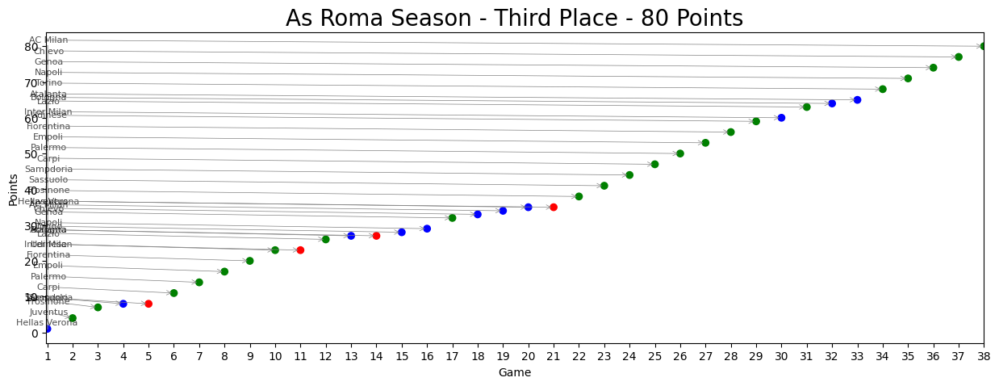

In [ ]:
# ANDAMENTO STAGIONE

colors = []
for result in team_season_overview["result"]:
    if result == "Win":
        colors.append("green")
    elif result == "Draw":
        colors.append("blue")
    else:
        colors.append("red")

plt.figure(figsize=(15, 5))
plt.scatter(range(len(team_season_overview["points_tracker"])), team_season_overview["points_tracker"], c=colors, marker="o")
plt.plot(team_season_overview["points_tracker"], color="gray", alpha=0.5)

texts = []
for i, opponent in enumerate(team_season_overview["opponent"]):
    text = plt.text(i, team_season_overview["points_tracker"][i], opponent, fontsize=8, ha="right", va="bottom", color="black", alpha=0.7)
    texts.append(text)
    
adjust_text(texts, arrowprops=dict(arrowstyle="->", color="gray", lw=0.5), min_dist=10, force_text=1)

plt.title(f"As Roma Season - Third Place - {team_season_overview["points_tracker"].values[-1]} Points", fontsize=20)
plt.xlabel("Game")
plt.ylabel("Points")
plt.xticks(ticks=range(38), labels=range(1, 39))

plt.show()


In [1]:
# FORMATIONS
plt.figure(figsize=(15, 5))

home_away_map = { "home": "lightblue", "away": "salmon"}

formations_plot = sns.countplot(data=team_season_overview, x="formation", hue="home/away", palette=home_away_map)
for p in formations_plot.patches:
    if p.get_height() > 0:
        formations_plot.text(p.get_x() + p.get_width() / 2, p.get_height() + 0.1,
                         int(p.get_height()), ha='center', fontsize=12)

plt.title("Distribution of Used Formations (Home vs Away)", fontsize=20)
plt.ylabel("Frequency", fontsize=14)
plt.xlabel("Formation", fontsize=14)
plt.yticks([])  # Rimuovere le etichette sull'asse y

handles_away_home = [mpatches.Patch(color=color) for color in home_away_map.values()]
labels_away_home = ["Home", "Away"]
plt.legend(handles=handles_away_home, labels=labels_away_home, title="Home/Away", loc="upper right", fontsize=14)

plt.tight_layout()
plt.show()


NameError: name 'plt' is not defined

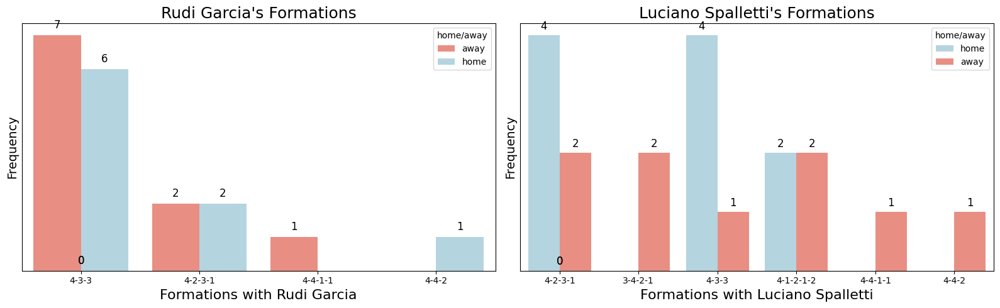

In [ ]:
# FORMATIONS BY COACHES
home_away_map = { "home": "lightblue","away": "salmon"}

garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"]
spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"]

garcia_formations = garcia["formation"].value_counts().index.tolist()
spalletti_formations = spalletti["formation"].value_counts().index.tolist()

fig, axs = plt.subplots(1, 2, figsize=(16, 5))

# Rudi Garcia
garcia_plot = sns.countplot(data=garcia, x="formation", hue="home/away", palette=home_away_map, ax=axs[0])#, order=garcia_formations)
for p in garcia_plot.patches:
    garcia_plot.text(p.get_x() + p.get_width() / 2, p.get_height() + 0.2,
                     int(p.get_height()), ha="center", fontsize=12)

axs[0].set_xlabel("Formations with Rudi Garcia", fontsize=16)
axs[0].set_ylabel("Frequency", fontsize=14)
axs[0].set_yticks([])
axs[0].set_title("Rudi Garcia's Formations", fontsize=18)

# Luciano Spalletti
spalletti_plot = sns.countplot(data=spalletti, x="formation", hue="home/away", palette=home_away_map, ax=axs[1])#, order=spalletti_formations)
for p in spalletti_plot.patches:
    spalletti_plot.text(p.get_x() + p.get_width() / 2, p.get_height() + 0.1,
                        int(p.get_height()), ha="center", fontsize=12)

axs[1].set_xlabel("Formations with Luciano Spalletti", fontsize=16)
axs[1].set_ylabel("Frequency", fontsize=14)
axs[1].set_yticks([])
axs[1].set_title("Luciano Spalletti's Formations", fontsize=18)

plt.tight_layout()
plt.show()


In [ ]:

# Aggiungi la colonna 'win' con valore 1 per vittorie e 0 per pareggi o sconfitte
team_season_overview['win'] = team_season_overview['result'].apply(lambda x: 1 if x == 'Win' else 0)
garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"]
spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"]

In [ ]:

# Calcola la percentuale di vittoria per ciascuna combinazione di formazione e home/away per Rudi Garcia
garcia_win_percentage_df = garcia.groupby(['formation', 'home/away']).agg(
    total_matches=('win', 'size'),
    total_wins=('win', 'sum')
).reset_index()

garcia_win_percentage_df['win_percentage'] = (garcia_win_percentage_df['total_wins'] / garcia_win_percentage_df['total_matches']) * 100

# Calcola la percentuale di vittoria per ciascuna combinazione di formazione e home/away per Luciano Spalletti
spalletti_win_percentage_df = spalletti.groupby(['formation', 'home/away']).agg(
    total_matches=('win', 'size'),
    total_wins=('win', 'sum')
).reset_index()

spalletti_win_percentage_df['win_percentage'] = (spalletti_win_percentage_df['total_wins'] / spalletti_win_percentage_df['total_matches']) * 100

garcia_order = ['4-3-3', '4-2-3-1', '4-4-2', '4-4-1-1']
spalletti_order = ['4-3-3', '4-2-3-1', '4-4-2', '4-4-1-1', '3-4-2-1', '4-1-2-1-2']


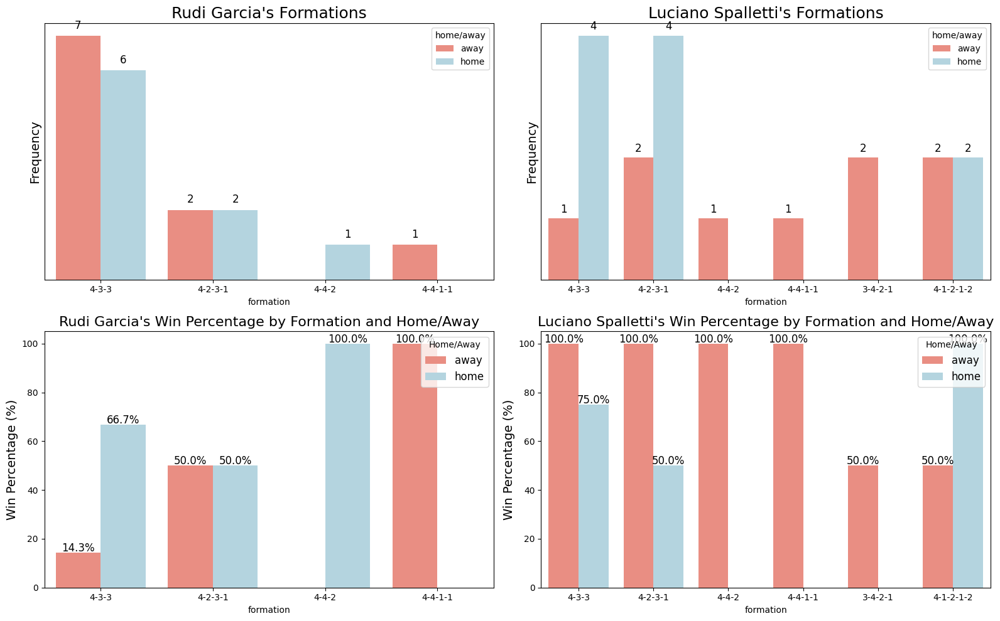

In [ ]:
# WIN % by FORMATIONS by COACHES
# Esegui i grafici
fig, axs = plt.subplots(2, 2, figsize=(16, 10))

# Flatten the axes array for easier access
axs = axs.flatten()

# Primo grafico: Rudi Garcia - Countplot per le formazioni
garcia_plot = sns.countplot(data=garcia, x="formation", hue="home/away", palette=home_away_map, ax=axs[0], order=garcia_order)
for p in garcia_plot.patches:
    if p.get_height() > 0:
        garcia_plot.text(p.get_x() + p.get_width() / 2, p.get_height() + 0.2,
                         int(p.get_height()), ha='center', fontsize=12)

axs[0].set_ylabel("Frequency", fontsize=14)
axs[0].set_yticks([])  # Rimuovere le etichette sull'asse Y
axs[0].set_title("Rudi Garcia's Formations", fontsize=18)

# Secondo grafico: Luciano Spalletti - Countplot per le formazioni (invertito Home/Away)
spalletti_plot = sns.countplot(data=spalletti, x="formation", hue="home/away", palette=home_away_map, ax=axs[1], order=spalletti_order, hue_order=["away", "home"])
for p in spalletti_plot.patches:
    if p.get_height() > 0:
        spalletti_plot.text(p.get_x() + p.get_width() / 2, p.get_height() + 0.1,
                            int(p.get_height()), ha='center', fontsize=12)

axs[1].set_ylabel("Frequency", fontsize=14)
axs[1].set_yticks([])  # Rimuovere le etichette sull'asse Y
axs[1].set_title("Luciano Spalletti's Formations", fontsize=18)

# Terzo grafico: Rudi Garcia - Percentuali di vittoria
sns.barplot(data=garcia_win_percentage_df, x="formation", y="win_percentage", hue="home/away", palette=home_away_map, ax=axs[2], order=garcia_order)
for p in axs[2].patches:
    # Aggiungi il testo sopra ogni barra con la percentuale di vittoria
    height = p.get_height()
    if p.get_height() > 0:
        axs[2].text(p.get_x() + p.get_width() / 2, height + 0.5,
                f"{height:.1f}%", ha='center', fontsize=12)

axs[2].set_title("Rudi Garcia's Win Percentage by Formation and Home/Away", fontsize=16)
axs[2].set_ylabel("Win Percentage (%)", fontsize=14)
axs[2].legend(title="Home/Away", loc="upper right", fontsize=12)

# Quarto grafico: Luciano Spalletti - Percentuali di vittoria
sns.barplot(data=spalletti_win_percentage_df, x="formation", y="win_percentage", hue="home/away", palette=home_away_map, ax=axs[3], order=spalletti_order)
for p in axs[3].patches:
    # Aggiungi il testo sopra ogni barra con la percentuale di vittoria
    height = p.get_height()
    if p.get_height() > 0:
        axs[3].text(p.get_x() + p.get_width() / 2, height + 0.5,
                f"{height:.1f}%", ha='center', fontsize=12)

axs[3].set_title("Luciano Spalletti's Win Percentage by Formation and Home/Away", fontsize=16)
axs[3].set_ylabel("Win Percentage (%)", fontsize=14)
axs[3].legend(title="Home/Away", loc="upper right", fontsize=12)

# Layout finale
plt.tight_layout()
plt.show()


In [ ]:
# PLAYERS APPEARANCES
players = season_merged.index.unique()
player_colors = {
    'Vassilis Torosidis': '#6B8E23',  # Olive Drab
    'Wojciech Szczęsny': '#8FBC8F',  # Dark Sea Green
    'Edin Džeko': '#FF8C00',  # Dark Orange
    'Gervais Lombe Yao Kouassi': '#F0E68C',  # Khaki
    'Daniele De Rossi': '#CD5C5C',  # Indian Red
    'Miralem Pjanić': '#A9A9A9',  # Dark Gray
    'Radja Nainggolan': '#FFB6C1',  # Light Pink
    'Mohamed Salah': '#DC143C',  # Crimson
    'Leandro Castán da Silva': '#AFEEEE',  # Pale Turquoise
    'Konstantinos Manolas': '#98FB98',  # Pale Green
    'Alessandro Florenzi': '#9370DB',  # Medium Purple
    'Seydou Kéita': '#D2691E',  # Chocolate
    'Iago Falqué Silva': '#ADD8E6',  # Light Blue
    'Segundo Víctor Ibarbo Guerrero': '#DA70D6',  # Orchid
    'Lucas Digne': '#4682B4',  # Steel Blue
    'Juan Manuel Iturbe Arévalo': '#8A2BE2',  # Blue Violet
    'Adem Ljajić': '#FFD700',  # Gold
    'Francesco Totti': '#8B0000',  # Dark Red
    'Antonio Rüdiger': '#00008B',  # Dark Blue
    'Maicon Douglas Sisenando': '#006400',  # Dark Green
    'Morgan De Sanctis': '#FF6347',  # Tomato
    'Salih Uçan': '#9400D3',  # Dark Violet
    'William Vainqueur': '#20B2AA',  # Light Sea Green
    'Emerson Palmieri dos Santos': '#A52A2A',  # Brown
    'Norbert Gyömbér': '#F4A460',  # Sandy Brown
    'Umar Sadiq Mesbah': 'grey',  
    'Lorenzo Di Livio': '#ADD8E6',  # Light Blue
    'Marco Tumminello': '#F5F5DC',  # Beige
    'Ervin Zukanović': '#556B2F',  # Dark Olive Green
    'Stephan El Shaarawy': '#483D8B',  # Dark Slate Blue
    'Diego Perotti': '#A9A9A9',  # Dark Gray
    'Kevin Strootman': '#8B4513',  # Saddle Brown
}

garcia = season_merged[season_merged["coach"] == "Rudi Garcia"]
spalletti = season_merged[season_merged["coach"] == "Luciano Spalletti"]


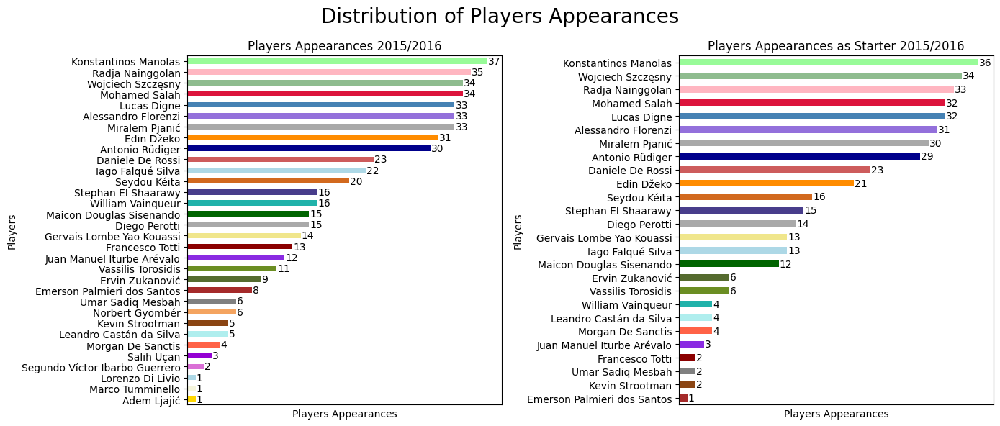

In [ ]:

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(17,6))

totPresenze = season_merged.groupby(season_merged.index).count()["match_id"].sort_values()
totPresenze_colors = [player_colors[player] for player in totPresenze.index]
pres_plot = totPresenze.plot(kind="barh", xlabel="Players Appearances", ylabel="Players", title="Players Appearances 2015/2016", 
                 ax=axs[0], figsize=(14,6), color=totPresenze_colors)

totTitolare = season_merged[season_merged["is_starter"] == True].groupby(season_merged[season_merged["is_starter"] == True].index).count()["match_id"].sort_values()
totTitolare_colors = [player_colors[player] for player in totTitolare.index]
tit_plot = totTitolare.plot(kind="barh", xlabel="Players Appearances", ylabel="Players", title="Players Appearances as Starter 2015/2016", 
                 ax=axs[1], figsize=(14,6), color=totTitolare_colors)

axs[0].set_xticks([])
axs[1].set_xticks([])

for p in pres_plot.patches:
    pres_plot.text(p.get_width()+0.1, p.get_y() + p.get_height()/2, p.get_width(), ha='left', va='center')

for p in tit_plot.patches:
    tit_plot.text(p.get_width()+0.1, p.get_y() + p.get_height()/2, p.get_width(), ha='left', va='center')

plt.suptitle("Distribution of Players Appearances", fontsize=(20))
plt.tight_layout()
plt.show()

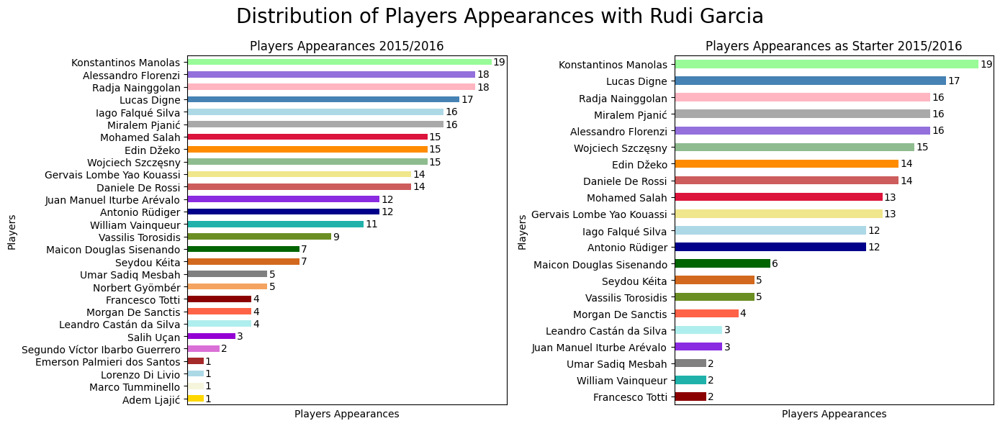

In [ ]:

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(17,6))

totPresenze = garcia.groupby(garcia.index).count()["match_id"].sort_values()
totPresenze_colors = [player_colors[player] for player in totPresenze.index]
pres_plot = totPresenze.plot(kind="barh", xlabel="Players Appearances", ylabel="Players", title="Players Appearances 2015/2016", 
                 ax=axs[0], figsize=(14,6), color=totPresenze_colors)

totTitolare = garcia[garcia["is_starter"] == True].groupby(garcia[garcia["is_starter"] == True].index).count()["match_id"].sort_values()
totTitolare_colors = [player_colors[player] for player in totTitolare.index]
tit_plot = totTitolare.plot(kind="barh", xlabel="Players Appearances", ylabel="Players", title="Players Appearances as Starter 2015/2016", 
                 ax=axs[1], figsize=(14,6), color=totTitolare_colors)

axs[0].set_xticks([])
axs[1].set_xticks([])

for p in pres_plot.patches:
    pres_plot.text(p.get_width()+0.1, p.get_y() + p.get_height()/2, p.get_width(), ha='left', va='center')

for p in tit_plot.patches:
    tit_plot.text(p.get_width()+0.1, p.get_y() + p.get_height()/2, p.get_width(), ha='left', va='center')

plt.suptitle("Distribution of Players Appearances with Rudi Garcia", fontsize=(20))
plt.tight_layout()
plt.show()

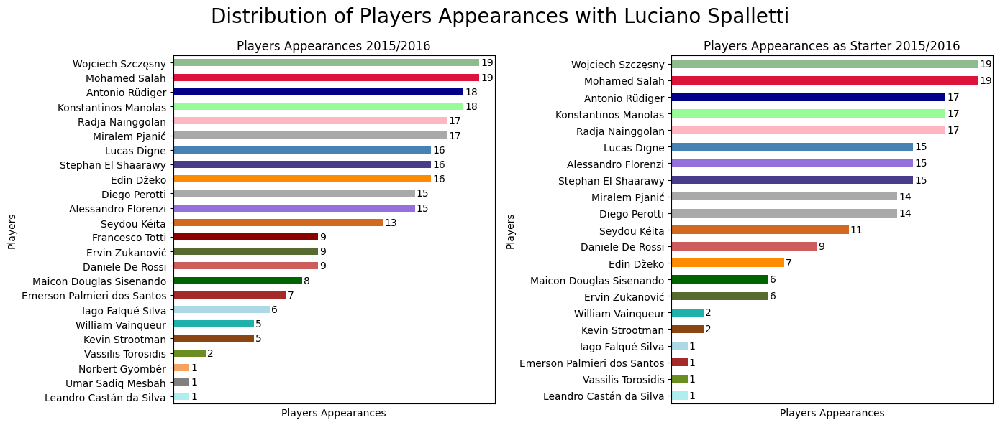

In [ ]:

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(17,6))

totPresenze = spalletti.groupby(spalletti.index).count()["match_id"].sort_values()
totPresenze_colors = [player_colors[player] for player in totPresenze.index]
pres_plot = totPresenze.plot(kind="barh", xlabel="Players Appearances", ylabel="Players", title="Players Appearances 2015/2016", 
                 ax=axs[0], figsize=(14,6), color=totPresenze_colors)

totTitolare = spalletti[spalletti["is_starter"] == True].groupby(spalletti[spalletti["is_starter"] == True].index).count()["match_id"].sort_values()
totTitolare_colors = [player_colors[player] for player in totTitolare.index]
tit_plot = totTitolare.plot(kind="barh", xlabel="Players Appearances", ylabel="Players", title="Players Appearances as Starter 2015/2016", 
                 ax=axs[1], figsize=(14,6), color=totTitolare_colors)

axs[0].set_xticks([])
axs[1].set_xticks([])

for p in pres_plot.patches:
    pres_plot.text(p.get_width()+0.1, p.get_y() + p.get_height()/2, p.get_width(), ha='left', va='center')

for p in tit_plot.patches:
    tit_plot.text(p.get_width()+0.1, p.get_y() + p.get_height()/2, p.get_width(), ha='left', va='center')

plt.suptitle("Distribution of Players Appearances with Luciano Spalletti", fontsize=(20))
plt.tight_layout()
plt.show()

In [ ]:

garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"]
spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"]

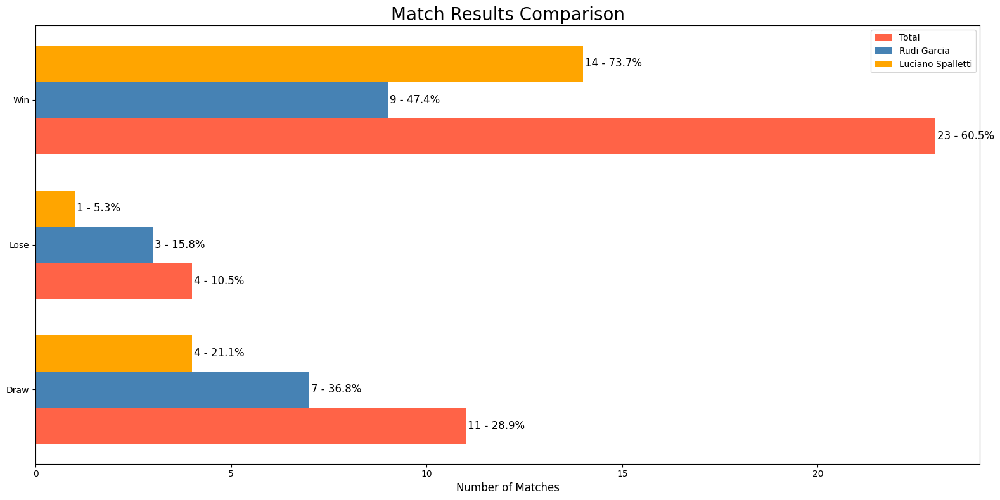

In [ ]:

# calcolo i risultati per ciascun allenatore e per il totale
team_results = team_season_overview.groupby("result")["match_id"].count()
garcia_results = garcia.groupby("result")["match_id"].count()
spalletti_results = spalletti.groupby("result")["match_id"].count()

# calcolo il totale delle partite
team_total = team_results.sum()
garcia_total = garcia_results.sum()
spalletti_total = spalletti_results.sum()

fig, ax = plt.subplots(figsize=(16, 8))

# definisco le posizioni per le barre, separando i gruppi per ogni risultato
bar_width = 0.25  # larghezza delle barre
positions = [0, 1, 2]  # posizioni per ogni gruppo di barre (0: Totale, 1: Garcia, 2: Spalletti)

# Plotta le barre per i risultati (Totale, Garcia, Spalletti)
ax.barh(positions, team_results.values, bar_width, color="#FF6347", label="Total")
ax.barh([p + bar_width for p in positions], garcia_results.values, bar_width, color="#4682B4", label="Rudi Garcia")
ax.barh([p + 2*bar_width for p in positions], spalletti_results.values, bar_width, color="orange", label="Luciano Spalletti")

for i, v in enumerate(team_results.values):
    ax.text(v + 0.05, i, f"{v} - {((v / team_total) * 100):.1f}%", va="center", fontsize=12)

for i, v in enumerate(garcia_results.values):
    ax.text(v + 0.05, i + bar_width, f"{v} - {((v / garcia_total) * 100):.1f}%", va="center", fontsize=12)

for i, v in enumerate(spalletti_results.values):
    ax.text(v + 0.05, i + 2*bar_width, f"{v} - {((v / spalletti_total) * 100):.1f}%", va="center", fontsize=12)

ax.set_yticks([p + bar_width for p in positions])
ax.set_yticklabels(team_results.index)  # assegno i risultati (Vittoria, Pareggio, Sconfitta) all"asse Y
ax.set_title("Match Results Comparison", fontsize=20)
ax.set_xlabel("Number of Matches", fontsize=12)
ax.legend()

plt.tight_layout()
plt.show()


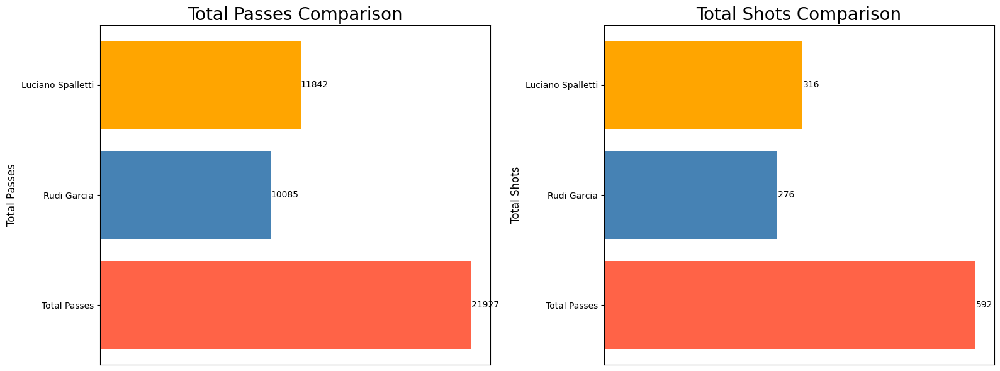

In [ ]:

fig, axs = plt.subplots(1,2,figsize=(16, 6))

labels = ["Total Passes", "Rudi Garcia", "Luciano Spalletti"]
colors = ['#FF6347', '#4682B4', 'orange']

values = [team_season_overview["total_passes"].sum(), garcia["total_passes"].sum(), spalletti["total_passes"].sum()]

axs[0].barh(labels, values, color=colors)
axs[0].set_title("Total Passes Comparison", fontsize=20)
axs[0].set_ylabel("Total Passes", fontsize=12)
axs[0].set_xticks([])

for i, v in enumerate(values):
    axs[0].text(v + 0.8, i, str(v), color="black", va="center")

values = [team_season_overview["total_shots"].sum(), garcia["total_shots"].sum(), spalletti["total_shots"].sum()]

axs[1].barh(labels, values, color=colors)
axs[1].set_title("Total Shots Comparison", fontsize=20)
axs[1].set_ylabel("Total Shots", fontsize=12)
axs[1].set_xticks([])

for i, v in enumerate(values):
    axs[1].text(v + 0.8, i, str(v), color="black", va="center")

plt.tight_layout()
plt.show()


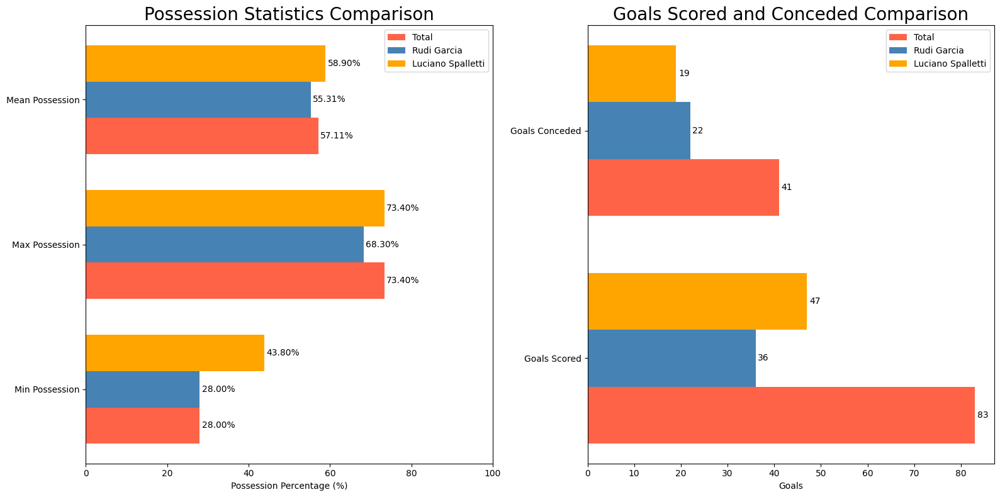

In [ ]:

# Primo grafico
# calcolo le statistiche per il team totale
min_possession = team_season_overview["%possession"].min()
max_possession = team_season_overview["%possession"].max()
mean_possession = team_season_overview["%possession"].mean()

# calcolo le statistiche per Rudi Garcia
min_possession_garcia = garcia["%possession"].min()
max_possession_garcia = garcia["%possession"].max()
mean_possession_garcia = garcia["%possession"].mean()

# calcolo le statistiche per Luciano Spalletti
min_possession_spalletti = spalletti["%possession"].min()
max_possession_spalletti = spalletti["%possession"].max()
mean_possession_spalletti = spalletti["%possession"].mean()

bar_width = 0.25  # larghezza delle barre
positions = [0, 1, 2]  # posizioni per ogni gruppo di barre (0: Totale, 1: Garcia, 2: Spalletti)

fig, axs = plt.subplots(1,2,figsize=(16, 8))

# grafici a barre per il possesso palla (Totale, Garcia, Spalletti)
axs[0].barh(positions, [min_possession, max_possession, mean_possession], bar_width, color="#FF6347", label="Total")
axs[0].barh([p + bar_width for p in positions], [min_possession_garcia, max_possession_garcia, mean_possession_garcia], bar_width, color="#4682B4", label="Rudi Garcia")
axs[0].barh([p + 2 * bar_width for p in positions], [min_possession_spalletti, max_possession_spalletti, mean_possession_spalletti], bar_width, color="orange", label="Luciano Spalletti")

for i, v in enumerate([min_possession, max_possession, mean_possession]):
    axs[0].text(v + 0.5, i, f"{v:.2f}%", color='black', va='center')

for i, v in enumerate([min_possession_garcia, max_possession_garcia, mean_possession_garcia]):
    axs[0].text(v + 0.5, i + bar_width, f"{v:.2f}%", color='black', va='center')

for i, v in enumerate([min_possession_spalletti, max_possession_spalletti, mean_possession_spalletti]):
    axs[0].text(v + 0.5, i + 2 * bar_width, f"{v:.2f}%", color='black', va='center')

axs[0].set_yticks([p + bar_width for p in positions])
axs[0].set_yticklabels(["Min Possession", "Max Possession", "Mean Possession"])

axs[0].set_title("Possession Statistics Comparison", fontsize=20)
axs[0].set_xlabel("Possession Percentage (%)")
axs[0].set_xlim(0, 100)  # imposto l'asse x per coprire il 100% del possesso
axs[0].legend()

# Secondo grafico
total_goals_scored = team_season_overview["goal_scored"].sum()
total_goals_conceded = team_season_overview["goal_conceded"].sum()

garcia_goals_scored = garcia["goal_scored"].sum()
garcia_goals_conceded = garcia["goal_conceded"].sum()

spalletti_goals_scored = spalletti["goal_scored"].sum()
spalletti_goals_conceded = spalletti["goal_conceded"].sum()

positions = [0, 1]  # posizioni per i goal segnati e i goal subiti

axs[1].barh(positions, [total_goals_scored,total_goals_conceded], bar_width, color="#FF6347", label="Total")
axs[1].barh([p + bar_width for p in positions], [garcia_goals_scored,garcia_goals_conceded], bar_width, color="#4682B4", label="Rudi Garcia")
axs[1].barh([p + 2 * bar_width for p in positions], [spalletti_goals_scored,spalletti_goals_conceded], bar_width, color="orange", label="Luciano Spalletti")

for i, v in enumerate([total_goals_scored, total_goals_conceded]):
    axs[1].text(v + 0.5, i, v, color='black', va='center')

for i, v in enumerate([garcia_goals_scored,garcia_goals_conceded]):
    axs[1].text(v + 0.5, i + bar_width, v, color='black', va='center')

for i, v in enumerate([spalletti_goals_scored, spalletti_goals_conceded]):
    axs[1].text(v + 0.5, i + 2 * bar_width, v, color='black', va='center')

axs[1].set_yticks([p + bar_width for p in positions])
axs[1].set_yticklabels(["Goals Scored", "Goals Conceded"])
axs[1].set_title("Goals Scored and Conceded Comparison", fontsize=20)
axs[1].set_xlabel("Goals")
axs[1].legend()

plt.tight_layout()
plt.show()


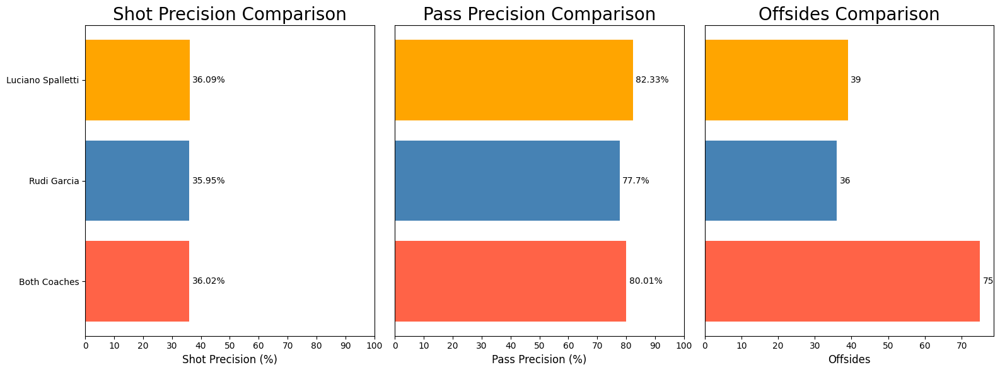

In [ ]:

total_shot_precision = round(team_season_overview["%shot_precision"].mean(), 2)
garcia_shot_precision = round(garcia["%shot_precision"].mean(), 2)
spalletti_shot_precision = round(spalletti["%shot_precision"].mean(), 2)

total_pass_precision = round(team_season_overview["%pass_precision"].mean(), 2)
garcia_pass_precision = round(garcia["%pass_precision"].mean(), 2)
spalletti_pass_precision = round(spalletti["%pass_precision"].mean(), 2)

fig, axs = plt.subplots(1, 3, figsize=(16, 6))

labels_shot = ["Both Coaches", "Rudi Garcia", "Luciano Spalletti"]
values_shot = [total_shot_precision, garcia_shot_precision, spalletti_shot_precision]
colors_shot = ['#FF6347', '#4682B4', 'orange']

axs[0].barh(labels_shot, values_shot, color=colors_shot)
axs[0].set_title("Shot Precision Comparison", fontsize=20)
axs[0].set_xlabel("Shot Precision (%)", fontsize=12)
axs[0].set_xticks(range(0, 101, 10))  # Impostiamo gli step per l'asse X (0-100%)
axs[0].set_xlim(0, 100)

for i, v in enumerate(values_shot):
    axs[0].text(v + 1, i, f"{v}%", color="black", va="center")


labels_pass = ["Pass Precision", "Rudi Garcia", "Luciano Spalletti"]
values_pass = [total_pass_precision, garcia_pass_precision, spalletti_pass_precision]
colors_pass = ['#FF6347', '#4682B4', 'orange']

axs[1].barh(labels_pass, values_pass, color=colors_pass)
axs[1].set_title("Pass Precision Comparison", fontsize=20)
axs[1].set_xlabel("Pass Precision (%)", fontsize=12)
axs[1].set_yticks([])
axs[1].set_xticks(range(0, 101, 10))  
axs[1].set_xlim(0, 100)

for i, v in enumerate(values_pass):
    axs[1].text(v + 1, i, f"{v}%", color="black", va="center")

labels = ["Total Shots", "Rudi Garcia", "Luciano Spalletti"]
values = [team_season_overview["offsides"].sum(), garcia["offsides"].sum(), spalletti["offsides"].sum()]
colors = ['#FF6347', '#4682B4', 'orange']

axs[2].barh(labels, values, color=colors)
axs[2].set_title("Offsides Comparison", fontsize=20)
axs[2].set_xlabel("Offsides", fontsize=12)
axs[2].set_yticks([])

for i, v in enumerate(values):
    axs[2].text(v + 0.8, i, str(v), color="black", va="center")

plt.tight_layout()
plt.show()


In [ ]:

total_xG = round(team_season_overview["total_xG"].sum(), 2)
mean_xG = round(team_season_overview["mean_xG"].mean(), 2)
total_xG_goals = round(team_season_overview["total_xG_goals"].sum(), 2)
mean_xG_goals = round(team_season_overview["mean_xG_goals"].mean(), 2)


garcia_total_xG = round(garcia["total_xG"].sum(), 2)
garcia_mean_xG = round(garcia["mean_xG"].mean(), 2)
garcia_total_xG_goals = round(garcia["total_xG_goals"].sum(), 2)
garcia_mean_xG_goals = round(garcia["mean_xG_goals"].mean(), 2)


spalletti_total_xG = round(spalletti["total_xG"].sum(), 2)
spalletti_mean_xG = round(spalletti["mean_xG"].mean(), 2)
spalletti_total_xG_goals = round(spalletti["total_xG_goals"].sum(), 2)
spalletti_mean_xG_goals = round(spalletti["mean_xG_goals"].mean(), 2)

data = {
    'Statistic': ['Total xG', 'Mean xG', 'Total xG Goals', 'Mean xG Goals'],
    'Total': [total_xG, mean_xG, total_xG_goals, mean_xG_goals],
    'Rudi Garcia': [garcia_total_xG, garcia_mean_xG, garcia_total_xG_goals, garcia_mean_xG_goals],
    'Luciano Spalletti': [spalletti_total_xG, spalletti_mean_xG, spalletti_total_xG_goals, spalletti_mean_xG_goals]
}

df_xg = pd.DataFrame(data)
df_xg

,Statistic,Total,Rudi Garcia,Luciano Spalletti
0,Total xG,61.95,30.66,31.29
1,Mean xG,0.11,0.12,0.10
2,Total xG Goals,22.06,10.16,11.90
3,Mean xG Goals,0.25,0.25,0.25


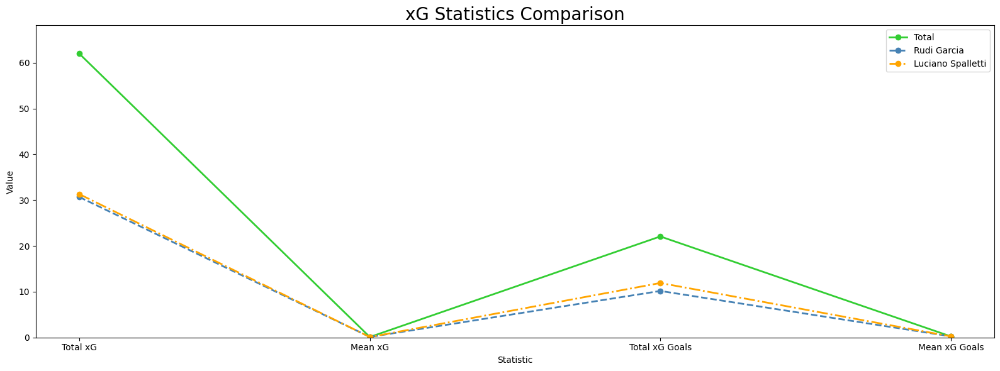

In [ ]:

# Dati da visualizzare
labels = ['Total xG', 'Mean xG', 'Total xG Goals', 'Mean xG Goals']
total_values = [total_xG, mean_xG, total_xG_goals, mean_xG_goals]
garcia_values = [garcia_total_xG, garcia_mean_xG, garcia_total_xG_goals, garcia_mean_xG_goals]
spalletti_values = [spalletti_total_xG, spalletti_mean_xG, spalletti_total_xG_goals, spalletti_mean_xG_goals]

# Creazione del grafico
fig, ax = plt.subplots(figsize=(16, 6))

# Aggiungi le linee per ciascun allenatore
ax.plot(labels, total_values, marker='o', label='Total', color='#32CD32', linestyle='-', linewidth=2)
ax.plot(labels, garcia_values, marker='o', label='Rudi Garcia', color='#4682B4', linestyle='--', linewidth=2)
ax.plot(labels, spalletti_values, marker='o', label='Luciano Spalletti', color='orange', linestyle='-.', linewidth=2)

# Aggiungi titoli e etichette
ax.set_title("xG Statistics Comparison", fontsize=20)
ax.set_xlabel("Statistic")
ax.set_ylabel("Value")
ax.set_ylim(0, max(max(total_values), max(garcia_values), max(spalletti_values)) * 1.1)  # Imposta il limite dell'asse Y per una visualizzazione migliore

# Aggiungi la legenda
ax.legend()

# Mostra il grafico
plt.tight_layout()
plt.show()


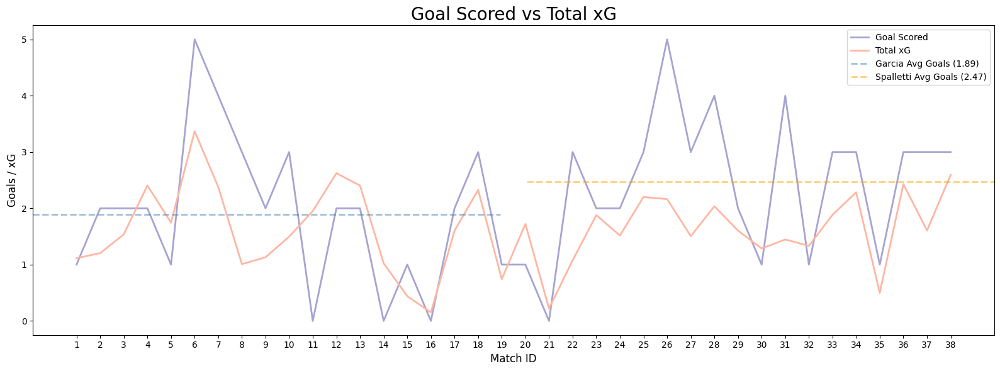

In [ ]:

garcia_avg_goals = team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']['goal_scored'].mean()
spalletti_avg_goals = team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']['goal_scored'].mean()

fig, ax = plt.subplots(figsize=(16, 6))

# Linea per "Goal Scored" e "Total xG"
ax.plot(team_season_overview["match_id"], team_season_overview["goal_scored"], color="#A5A3D1", label="Goal Scored", linewidth=2)
ax.plot(team_season_overview["match_id"], team_season_overview["total_xG"], color="#FFB6A2", label="Total xG", linewidth=2)

# Aggiungi le linee orizzontali per le medie dei gol segnati per ciascun allenatore (dalla 1 alla 19 per Garcia e dalla 20 alla 38 per Spalletti)
ax.axhline(garcia_avg_goals, alpha=0.5,color="#4682B4", linestyle="--", linewidth=2, xmin=0/37, xmax=18/37, label=f"Garcia Avg Goals ({garcia_avg_goals:.2f})")
ax.axhline(spalletti_avg_goals, alpha=0.5, color="orange", linestyle="--", linewidth=2, xmin=19/37, xmax=1, label=f"Spalletti Avg Goals ({spalletti_avg_goals:.2f})")

ax.set_title("Goal Scored vs Total xG", fontsize=20)
ax.set_xlabel("Match ID", fontsize=12)
ax.set_ylabel("Goals / xG", fontsize=12)
ax.legend()

ax.set_xticks(range(0, 38))  # 0 a 37
ax.set_xticklabels(range(1, 39))  # Etichette da 1 a 38

plt.tight_layout()
plt.show()


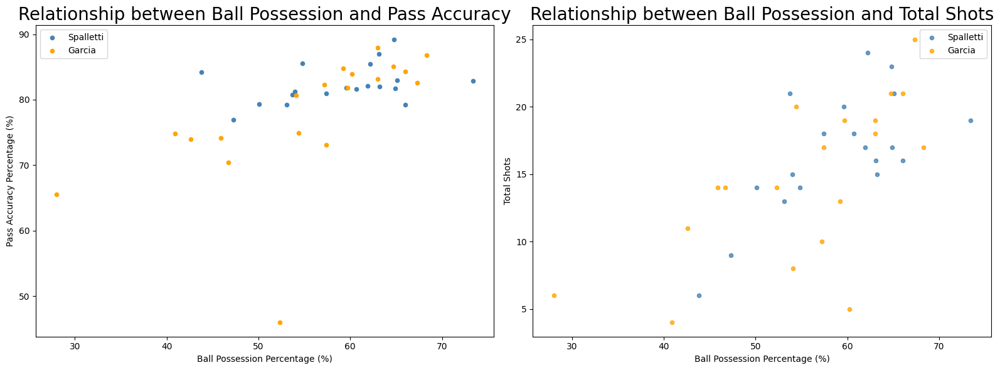

In [ ]:

fig, axs = plt.subplots(1, 2, figsize=(16, 6))

spalletti.plot(kind="scatter", x="%possession", y="%pass_precision", ax=axs[0], color="#4682B4", label="Spalletti")
garcia.plot(kind="scatter", x="%possession", y="%pass_precision", ax=axs[0], color="orange", label="Garcia")

axs[0].set_title("Relationship between Ball Possession and Pass Accuracy", fontsize=20)
axs[0].set_xlabel("Ball Possession Percentage (%)")
axs[0].set_ylabel("Pass Accuracy Percentage (%)")
axs[0].legend()

spalletti.plot(kind="scatter", x="%possession", y="total_shots", ax=axs[1], color="#4682B4", label="Spalletti",alpha=0.8)
garcia.plot(kind="scatter", x="%possession", y="total_shots", ax=axs[1], color="orange", label="Garcia",alpha=0.8)

axs[1].set_title("Relationship between Ball Possession and Total Shots", fontsize=20)
axs[1].set_xlabel("Ball Possession Percentage (%)")
axs[1].set_ylabel("Total Shots")
axs[1].legend()

plt.tight_layout()
plt.show()


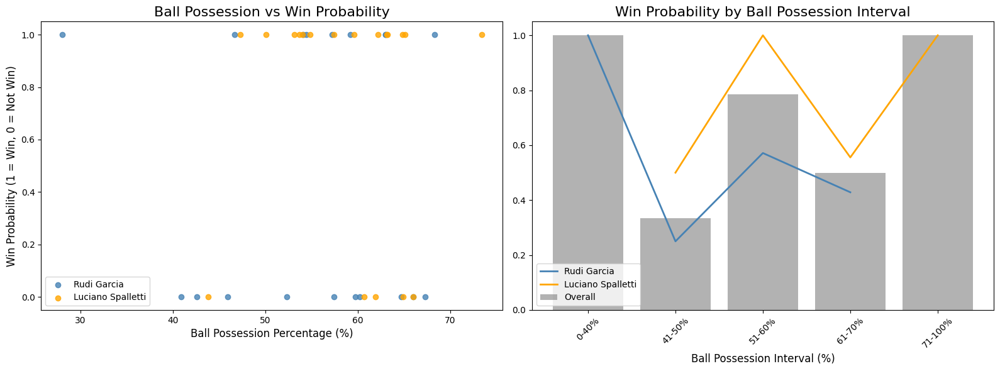

In [ ]:

fig, axs = plt.subplots(1, 2, figsize=(16, 6))

axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["%possession"], team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["win"], 
               color="#4682B4", alpha=0.8, label="Rudi Garcia")

axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["%possession"], team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["win"], 
               color="orange", alpha=0.8, label="Luciano Spalletti")

axs[0].set_title("Ball Possession vs Win Probability", fontsize=16)
axs[0].set_xlabel("Ball Possession Percentage (%)", fontsize=12)
axs[0].set_ylabel("Win Probability (1 = Win, 0 = Not Win)", fontsize=12)
axs[0].legend()

# calcolo dei bins per la percentuale di possesso palla
bins = [0, 40, 50, 60, 70, 100]
labels = ["0-40%", "41-50%", "51-60%", "61-70%", "71-100%"]

# creo una nuova colonna "possession_bin" che assegna ogni partita al bin appropriato
team_season_overview["possession_bin"] = pd.cut(team_season_overview["%possession"], bins=bins, labels=labels, right=True)

# calcolo la probabilità di vittoria (media della colonna "win") per ciascun bin di possesso palla
win_prob_by_possession = team_season_overview.groupby("possession_bin")["win"].mean()

axs[1].bar(win_prob_by_possession.index, win_prob_by_possession.values, alpha=0.6, color="grey", label="Overall")

# Aggiungi linee per ciascun allenatore
win_prob_by_possession_garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"].groupby("possession_bin")["win"].mean()
win_prob_by_possession_spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"].groupby("possession_bin")["win"].mean()

axs[1].plot(win_prob_by_possession_garcia.index, win_prob_by_possession_garcia.values, color="#4682B4", linewidth=2, label="Rudi Garcia")
axs[1].plot(win_prob_by_possession_spalletti.index, win_prob_by_possession_spalletti.values, color="orange", linewidth=2, label="Luciano Spalletti")

axs[1].set_title("Win Probability by Ball Possession Interval", fontsize=16)
axs[1].set_xlabel("Ball Possession Interval (%)", fontsize=12)
axs[1].tick_params(axis="x", rotation=45)
axs[1].legend()


plt.tight_layout()
plt.show()


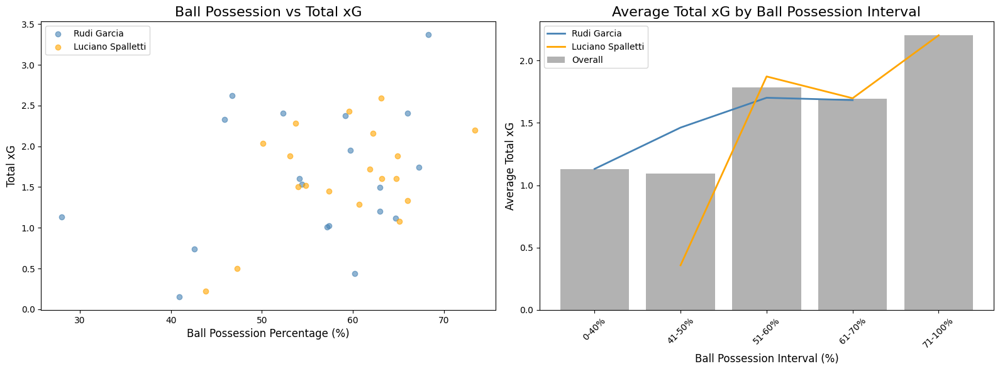

In [ ]:

fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# scatter plot: Ball Possession vs Total xG (distinzione tra allenatori)
axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["total_xG"], 
               color="#4682B4", alpha=0.6, label="Rudi Garcia")

axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["total_xG"], 
               color="orange", alpha=0.6, label="Luciano Spalletti")

axs[0].set_title("Ball Possession vs Total xG", fontsize=16)
axs[0].set_xlabel("Ball Possession Percentage (%)", fontsize=12)
axs[0].set_ylabel("Total xG", fontsize=12)
axs[0].legend()

# calcolo la media di total_xG per ciascun bin di possesso palla
mean_xg_by_possession = team_season_overview.groupby("possession_bin")["total_xG"].mean()

# Distinzione tra allenatori nei colori
axs[1].bar(mean_xg_by_possession.index, mean_xg_by_possession.values, alpha=0.6, color="grey", label="Overall")

# Aggiungi linee per ciascun allenatore
mean_xg_by_possession_garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"].groupby("possession_bin")["total_xG"].mean()
mean_xg_by_possession_spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"].groupby("possession_bin")["total_xG"].mean()

axs[1].plot(mean_xg_by_possession_garcia.index, mean_xg_by_possession_garcia.values, color="#4682B4", linewidth=2, label="Rudi Garcia")
axs[1].plot(mean_xg_by_possession_spalletti.index, mean_xg_by_possession_spalletti.values, color="orange", linewidth=2, label="Luciano Spalletti")

axs[1].set_title("Average Total xG by Ball Possession Interval", fontsize=16)
axs[1].set_xlabel("Ball Possession Interval (%)", fontsize=12)
axs[1].set_ylabel("Average Total xG", fontsize=12)
axs[1].tick_params(axis="x", rotation=45)
axs[1].legend()

plt.tight_layout()
plt.show()


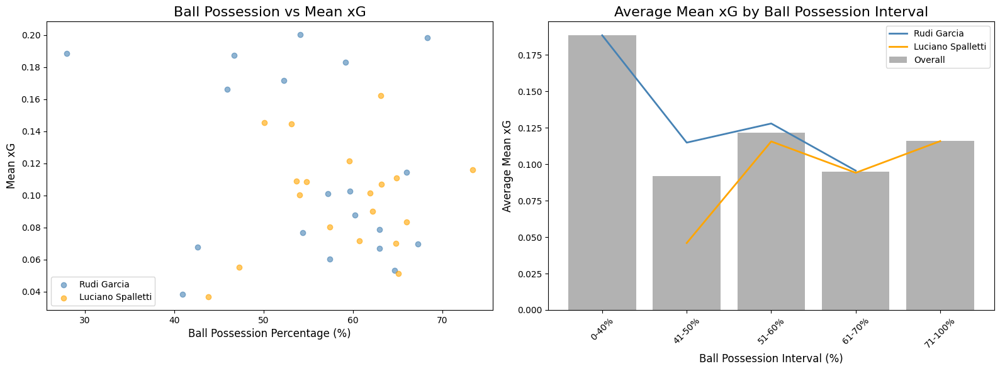

In [ ]:

fig, axs = plt.subplots(1, 2, figsize=(16, 6))

axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["mean_xG"], 
               color="#4682B4", alpha=0.6, label="Rudi Garcia")

axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["mean_xG"], 
               color="orange", alpha=0.6, label="Luciano Spalletti")

axs[0].set_title("Ball Possession vs Mean xG", fontsize=16)
axs[0].set_xlabel("Ball Possession Percentage (%)", fontsize=12)
axs[0].set_ylabel("Mean xG", fontsize=12)
axs[0].legend()


mean_xg_by_possession = team_season_overview.groupby("possession_bin")["mean_xG"].mean()

axs[1].bar(mean_xg_by_possession.index, mean_xg_by_possession.values, alpha=0.6, color="grey", label="Overall")

mean_xg_by_possession_garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"].groupby("possession_bin")["mean_xG"].mean()
mean_xg_by_possession_spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"].groupby("possession_bin")["mean_xG"].mean()

axs[1].plot(mean_xg_by_possession_garcia.index, mean_xg_by_possession_garcia.values, color="#4682B4", linewidth=2, label="Rudi Garcia")
axs[1].plot(mean_xg_by_possession_spalletti.index, mean_xg_by_possession_spalletti.values, color="orange", linewidth=2, label="Luciano Spalletti")

axs[1].set_title("Average Mean xG by Ball Possession Interval", fontsize=16)
axs[1].set_xlabel("Ball Possession Interval (%)", fontsize=12)
axs[1].set_ylabel("Average Mean xG", fontsize=12)
axs[1].tick_params(axis="x", rotation=45)
axs[1].legend()

plt.tight_layout()
plt.show()


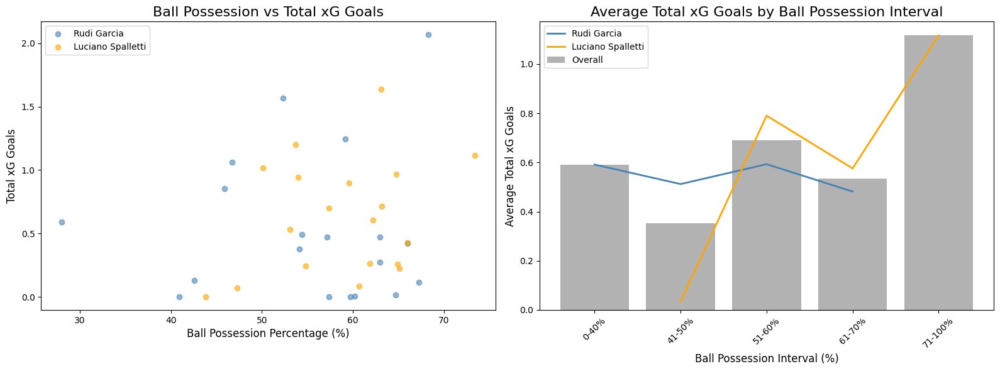

In [ ]:

fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# scatter plot: Ball Possession vs Total xG Goals (distinzione tra allenatori)
axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["total_xG_goals"], 
               color="#4682B4", alpha=0.6, label="Rudi Garcia")

axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["total_xG_goals"], 
               color="orange", alpha=0.6, label="Luciano Spalletti")

axs[0].set_title("Ball Possession vs Total xG Goals", fontsize=16)
axs[0].set_xlabel("Ball Possession Percentage (%)", fontsize=12)
axs[0].set_ylabel("Total xG Goals", fontsize=12)
axs[0].legend()

# calcolo la media di total_xG_goals per ciascun bin di possesso palla
total_xg_goals_by_possession = team_season_overview.groupby("possession_bin")["total_xG_goals"].mean()

# Distinzione tra allenatori nei colori
axs[1].bar(total_xg_goals_by_possession.index, total_xg_goals_by_possession.values, alpha=0.6, color="grey", label="Overall")

# Aggiungi linee per ciascun allenatore
total_xg_goals_by_possession_garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"].groupby("possession_bin")["total_xG_goals"].mean()
total_xg_goals_by_possession_spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"].groupby("possession_bin")["total_xG_goals"].mean()

axs[1].plot(total_xg_goals_by_possession_garcia.index, total_xg_goals_by_possession_garcia.values, color="#4682B4", linewidth=2, label="Rudi Garcia")
axs[1].plot(total_xg_goals_by_possession_spalletti.index, total_xg_goals_by_possession_spalletti.values, color="orange", linewidth=2, label="Luciano Spalletti")

axs[1].set_title("Average Total xG Goals by Ball Possession Interval", fontsize=16)
axs[1].set_xlabel("Ball Possession Interval (%)", fontsize=12)
axs[1].set_ylabel("Average Total xG Goals", fontsize=12)
axs[1].tick_params(axis="x", rotation=45)
axs[1].legend()

plt.tight_layout()
plt.show()


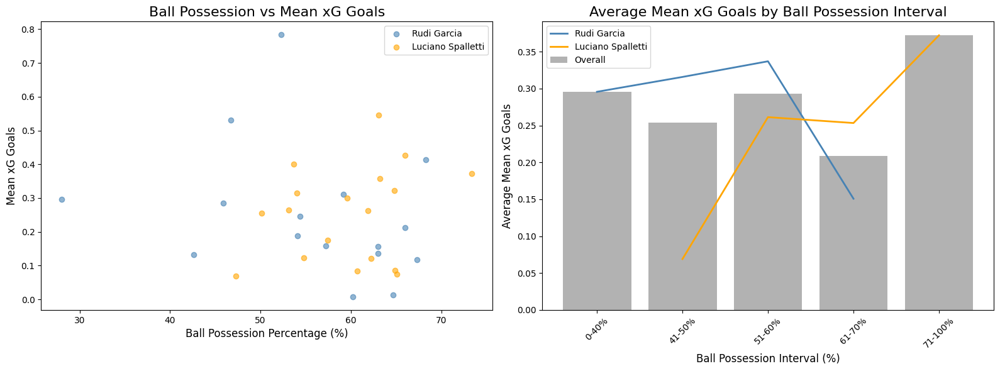

In [ ]:

fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# scatter plot: Ball Possession vs Mean xG Goals (distinzione tra allenatori)
axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Rudi Garcia']["mean_xG_goals"], 
               color="#4682B4", alpha=0.6, label="Rudi Garcia")

axs[0].scatter(team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["%possession"], 
               team_season_overview[team_season_overview['coach'] == 'Luciano Spalletti']["mean_xG_goals"], 
               color="orange", alpha=0.6, label="Luciano Spalletti")

axs[0].set_title("Ball Possession vs Mean xG Goals", fontsize=16)
axs[0].set_xlabel("Ball Possession Percentage (%)", fontsize=12)
axs[0].set_ylabel("Mean xG Goals", fontsize=12)
axs[0].legend()

# calcolo la media di mean_xG_goals per ciascun bin di possesso palla
mean_xg_goals_by_possession = team_season_overview.groupby("possession_bin")["mean_xG_goals"].mean()

# Distinzione tra allenatori nei colori
axs[1].bar(mean_xg_goals_by_possession.index, mean_xg_goals_by_possession.values, alpha=0.6, color="grey", label="Overall")

# Aggiungi linee per ciascun allenatore
mean_xg_goals_by_possession_garcia = team_season_overview[team_season_overview["coach"] == "Rudi Garcia"].groupby("possession_bin")["mean_xG_goals"].mean()
mean_xg_goals_by_possession_spalletti = team_season_overview[team_season_overview["coach"] == "Luciano Spalletti"].groupby("possession_bin")["mean_xG_goals"].mean()

axs[1].plot(mean_xg_goals_by_possession_garcia.index, mean_xg_goals_by_possession_garcia.values, color="#4682B4", linewidth=2, label="Rudi Garcia")
axs[1].plot(mean_xg_goals_by_possession_spalletti.index, mean_xg_goals_by_possession_spalletti.values, color="orange", linewidth=2, label="Luciano Spalletti")

axs[1].set_title("Average Mean xG Goals by Ball Possession Interval", fontsize=16)
axs[1].set_xlabel("Ball Possession Interval (%)", fontsize=12)
axs[1].set_ylabel("Average Mean xG Goals", fontsize=12)
axs[1].tick_params(axis="x", rotation=45)
axs[1].legend()

plt.tight_layout()
plt.show()


# Plots - Insights and Players Overview

In [41]:
season_merged

,match_id,home/away,coach,opponent,result,is_starter,min_played,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,on_post,goals,goals_penalties,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,wrong_passes,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Vassilis Torosidis,3878541,away,Rudi Garcia,Hellas Verona,Draw,True,94.02,0,[Left Back],1,0,0,0,0,0,0,0.009657,0.009657,0.000000,0.000000,39,31,8,79.49,0,0,0,0,0,0.00,64.1,16.6,"[[47.4, 16.4], [31.5, 5.6], [26.6, 1.6], [72.5..."
Wojciech Szczęsny,3878541,away,Rudi Garcia,Hellas Verona,Draw,True,94.02,0,[Goalkeeper],0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,28,27,1,96.43,0,0,0,0,0,0.00,10.5,40.6,"[[6.0, 36.0], [2.8, 41.6], [6.0, 36.0], [8.2, ..."
Edin Džeko,3878541,away,Rudi Garcia,Hellas Verona,Draw,True,94.02,0,[Center Forward],6,1,5,16.7,0,0,0,0.294617,0.049103,0.000000,0.000000,37,28,9,75.68,1,1,0,0,0,0.00,83.8,44.1,"[[72.5, 25.2], [72.5, 25.2], [72.8, 25.2], [71..."
Gervais Lombe Yao Kouassi,3878541,away,Rudi Garcia,Hellas Verona,Draw,True,94.02,0,"[Right Wing, Left Wing]",1,0,0,0,0,0,0,0.031721,0.031721,0.000000,0.000000,31,25,6,80.65,0,0,4,3,1,75.00,84.3,43.8,"[[80.8, 14.4], [81.7, 75.8], [81.7, 75.8], [82..."
Daniele De Rossi,3878541,away,Rudi Garcia,Hellas Verona,Draw,True,94.02,0,[Center Defensive Midfield],1,0,0,0,0,0,0,0.005715,0.005715,0.000000,0.000000,69,59,10,85.51,0,0,0,0,0,0.00,53.2,44.9,"[[62.7, 32.6], [26.6, 42.0], [30.9, 40.8], [48..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Konstantinos Manolas,3879869,away,Luciano Spalletti,AC Milan,Win,True,93.31,0,"[Right Center Back, Center Back]",0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,49,45,4,91.84,0,0,0,0,0,0.00,38.6,50.7,"[[65.2, 53.6], [65.2, 53.6], [56.0, 55.8], [76..."
Wojciech Szczęsny,3879869,away,Luciano Spalletti,AC Milan,Win,True,93.31,0,[Goalkeeper],0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,34,30,4,88.24,0,0,0,0,0,0.00,9.3,38.8,"[[3.7, 29.3], [3.7, 29.3], [4.5, 25.2], [21.2,..."
Francesco Totti,3879869,away,Luciano Spalletti,AC Milan,Win,False,31.13,2,"[Center Attacking Midfield, Left Center Forwar...",3,1,2,33.3,0,0,0,0.136230,0.045410,0.000000,0.000000,28,20,8,71.43,0,0,1,1,0,100.00,74.4,49.5,"[[104.7, 51.4], [104.3, 49.3], [98.7, 20.9], [..."


# Build ALL TEAMS and ALL PLAYERS DATA

In [ ]:
team_season_overview.to_csv("TeamSeasonOverview.csv", index_label="team_name")
players_overview.to_csv("PlayersSeasonOverview.csv",index_label="player_name")

In [127]:
df_dimPlayers

,player_name,date_of_birth,position,nationality,image_url,age
0,Vassilis Torosidis,1985-05-10,Defender,Greece,https://www.almanaccogiallorosso.it/Giocatori/...,31
1,Wojciech Szczęsny,1990-04-18,Goalkeeper,Poland,https://www.almanaccogiallorosso.it/Giocatori/...,26
2,Edin Džeko,1986-03-17,Attacker,Bosnia and Herzegovina,https://www.almanaccogiallorosso.it/Giocatori/...,30
3,Gervais Lombe Yao Kouassi,1987-05-27,Attacker,Ivory Coast,https://www.almanaccogiallorosso.it/Giocatori/...,29
4,Daniele De Rossi,1983-07-24,Midfielder,Italy,https://www.almanaccogiallorosso.it/Giocatori/...,32
...,...,...,...,...,...,...
546,Massimo Zenildo Zappino,1981-06-12,Goalkeeper,Italy,https://img.a.transfermarkt.technology/portrai...,35
547,Arlind Afrim Ajeti,1993-09-25,Defender,Albania,https://img.a.transfermarkt.technology/portrai...,22
548,Oliver Kragl,1990-05-12,Midfielder,Germany,https://img.a.transfermarkt.technology/portrai...,26
549,Vasyl Pryyma,1991-06-10,Defender,Ukraine,https://img.a.transfermarkt.technology/portrai...,25


In [126]:
df_dimPlayers.to_csv("DimPlayers.csv", index=False)


In [ ]:
df_dimCoaches.to_csv("DimCoaches.csv", index=False)


In [445]:
df_dimTeams.to_csv("DimTeams.csv", index=False)

In [ ]:

teams = ["AS Roma", "Juventus", "Napoli", "Inter Milan", "Lazio", "Fiorentina", "AC Milan", "Sampdoria", "Torino", 
         "Bologna", "Palermo", "Sassuolo", "Atalanta", "Chievo", "Empoli", "Genoa", "Carpi", "Udinese", 
         "Hellas Verona", "Frosinone"]


# Otteniamo i dati delle partite
matches = requests.get(f"https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/matches/{competition_id}/{season_id}.json")
matches = matches.json()
matches_sorted = sorted(matches, key=lambda x: datetime.strptime(x["match_date"], "%Y-%m-%d"))

In [128]:

def get_coach(managers_list):
    if isinstance(managers_list, list) and len(managers_list) > 0:
        return managers_list[0].get("name", "N/A")
    return "N/A"

def createOverview(teamName):
    #print(f"{teamName} ====================")
    teamName_matches = [match for match in matches_sorted if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName]
    
    teamName_df = json_normalize(teamName_matches, sep="_")

    team_season_overview = pd.DataFrame()
    matchweek = 0
    
    for index, row in teamName_df.iterrows():

        # matchweek = matchweek + 1
        # team_season_overview.at[index, "matchweek"] = str(matchweek)

        team_season_overview.at[index, "match_id"] = str(row["match_id"])
        print(f"Giornata: {matchweek} - {str(row['match_id'])} - ", end="")

        # determinazione della squadra di casa e della squadra ospite
        if row["home_team_home_team_name"] == teamName:
            team_season_overview.at[index, "home/away"] = "home"
            current_coach = get_coach(row["home_team_managers"])
            opponent = row["away_team_away_team_name"]
            print(opponent)
            gol_scored = str(row["home_score"])
            gol_conceded = str(row["away_score"])
        elif row["away_team_away_team_name"] == teamName:
            team_season_overview.at[index, "home/away"] = "away"
            current_coach = get_coach(row["away_team_managers"])
            opponent = row["home_team_home_team_name"]
            print(opponent)
            gol_scored = str(row["away_score"])
            gol_conceded = str(row["home_score"])

        team_season_overview.at[index, "coach"] = current_coach
        team_season_overview.at[index, "opponent"] = opponent
        team_season_overview.at[index, "goal_scored"] = gol_scored
        team_season_overview.at[index, "goal_conceded"] = gol_conceded

        # risultato della partita
        result = "Draw" if gol_scored == gol_conceded else "Win" if gol_scored > gol_conceded else "Lose"
        team_season_overview.at[index, "result"] = result

        # punti accumulati
        if index == 0:
            team_season_overview.at[index, "points_tracker"] = str(3 if result == "Win" else 0 if result == "Lose" else 1)
        else:
            punti_prec = int(team_season_overview.loc[index - 1, "points_tracker"])
            points = 3 if result == "Win" else 0 if result == "Lose" else 1
            team_season_overview.at[index, "points_tracker"] = str(punti_prec + points)
        
    
    # eventi per ogni partita
    teamName_events = {}
    for m_id in teamName_df["match_id"]:
        events = requests.get(f"https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/{m_id}.json")
        teamName_events[str(m_id)] = json_normalize(events.json(), sep="_")
    
    # statistiche per ogni partita
    for index, row in team_season_overview.iterrows():
        m_id = row["match_id"]
        m_events = teamName_events[m_id]

        # formazione
        formazione = m_events.loc[:, "team_name":"tactics_formation"]
        formazione = formazione[(formazione["team_name"] == teamName) & formazione["tactics_formation"].notna()]
        modulo = "-".join(str(int(formazione.iloc[0, 1]))) if not formazione.empty else "N/A"
        team_season_overview.at[index, "formation"] = modulo

        # possesso palla
        possession_counts = m_events["possession_team_name"].value_counts()
        total_possession = m_events["possession_team_name"].count()
        possession_percentage = round((possession_counts / total_possession) * 100, 1)
        team_season_overview.at[index, "%possession"] = float(possession_percentage.get(teamName, 0))

        # tiri
        m_shots = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName)]
        team_season_overview.at[index, "total_shots"] = str(len(m_shots))
        
        onT = ["Saved", "Saved to Post", "Goal"]
        m_shotsOnT = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName) & (m_events["shot_outcome_name"].isin(onT))]
        team_season_overview.at[index, "on_target"] = str(len(m_shotsOnT))

        team_season_overview.at[index, "off_target"] = str(len(m_shots) - len(m_shotsOnT))

        post = ["Saved to Post", "Post"]
        m_shotsOnPost = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName) & (m_events["shot_outcome_name"].isin(post))]
        team_season_overview.at[index, "on_post"] = str(len(m_shotsOnPost))

        # calci di rigore
        m_goalPenalty = m_shots[m_shots["shot_type_name"] == "Penalty"]
        team_season_overview.at[index, "penalties"] = str(len(m_goalPenalty))

        # precisione dei tiri
        shotOnT_percentage = round((len(m_shotsOnT) / len(m_shots)) * 100, 1) if len(m_shots) > 0 else 0
        team_season_overview.at[index, "%shot_precision"] = float(shotOnT_percentage)

        # expected goals (xG)
        xG_sum = np.sum(m_shots["shot_statsbomb_xg"])
        xG_mean = np.mean(m_shots["shot_statsbomb_xg"]) if len(m_shots) > 0 else 0.0
        xG_goals_sum = np.sum(m_shots[m_shots["shot_outcome_name"] == "Goal"]["shot_statsbomb_xg"])
        xG_goals_mean = np.mean(m_shots[m_shots["shot_outcome_name"] == "Goal"]["shot_statsbomb_xg"]) if len(m_shots[m_shots["shot_outcome_name"] == "Goal"]) > 0 else 0.0

        team_season_overview.at[index, "total_xG"] = xG_sum
        team_season_overview.at[index, "mean_xG"] = xG_mean
        team_season_overview.at[index, "total_xG_goals"] = xG_goals_sum
        team_season_overview.at[index, "mean_xG_goals"] = xG_goals_mean

        # passaggi
        m_passes = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == teamName)]
        team_season_overview.at[index, "total_passes"] = str(len(m_passes))
        
        m_passes_completed = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == teamName) & (m_events["pass_outcome_name"].isna())]
        team_season_overview.at[index, "correct_passes"] = str(len(m_passes_completed))

        # passaggi non riusciti
        team_season_overview.at[index, "uncorrect_passes"] = str(len(m_passes) - len(m_passes_completed))

        # fuorigioco
        team_season_overview.at[index, "offsides"] = str(len(m_passes[m_passes["pass_outcome_name"] == "Pass Offside"]))

        # precisione passaggi
        passes_percentage = round((len(m_passes_completed) / len(m_passes)) * 100, 1) if len(m_passes) > 0 else 0
        team_season_overview.at[index, "%pass_precision"] = float(passes_percentage)

    team_season_overview["team_name"] = teamName
    team_season_overview.set_index("team_name", inplace=True)

    return team_season_overview


In [ ]:


def createPlayersOverview(teamName):
    print("Costruzione data - ", teamName)
    teamName_matches = []
    for match in matches_sorted:
        if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName:
            teamName_matches.append(match)

    teamName_matches = [match for match in matches_sorted if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName]
    teamName_df = json_normalize(teamName_matches, sep="_")

    players_season_overview = pd.DataFrame()
    matchweek = 0

    teamName_events = {}
    match_id_lst = list(teamName_df["match_id"])

    for mtc in match_id_lst:
        events = requests.get("https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/"+str(mtc)+".json")
        events = events.json()
        # ogni partita avrà come chiave l'id della partita
        teamName_events[str(mtc)] = json_normalize(events, sep="_")

    print("Eventi Caricati")

    tso = createOverview(teamName)

    print("Season Overview - ", teamName, " Caricato")

    # for index,row in tso.iterrows():
    #     m_id = row["match_id"]
    #     m_events = teamName_events[m_id]
    #     m_events["timestamp"] = pd.to_timedelta(m_events["timestamp"])
    #     m_players = m_events[(m_events["team_name"] == teamName) & (m_events["player_name"].notna())]["player_name"].unique()
    #     m_overview = pd.DataFrame(index=m_players)

    # iniziamo ad aggiungere i giocatori , se titolari , se subentrati (primo o secondo tempo) ed i minuti giocati
    for index,row in tso.iterrows():
        m_id = row["match_id"]
        m_events = teamName_events[m_id]
        m_events = m_events[m_events["team_name"] == teamName]
        m_events["timestamp"] = pd.to_timedelta(m_events["timestamp"])
        m_players = m_events[(m_events["team_name"] == teamName) & (m_events["player_name"].notna())]["player_name"].unique()
        m_overview = pd.DataFrame(index=m_players)

        print(teamName, " - Caricamento ", m_id , " ... ", end="")

        for p in m_players:
            #aggiungo id della partita
            m_overview.at[p,"match_id"] = m_id

            min_tot = m_events.groupby("period")["timestamp"].max() #minuti raggruppati per tempo
            min_1Half = min_tot.values[0] #estratto i minuti del primo e secondo tempo
            min_2Half = min_tot.values[1]

            if (m_events["substitution_replacement_name"] == p).any():
                sub = m_events[m_events["substitution_replacement_name"] == p] #prendo la riga che come evento la sostituzione del player p
                m_overview.at[p,"is_starter"] = False #non è titolare
                m_overview.at[p,"period_subbedIn"] = str(sub["period"].values[0]) #salvo il tempo in cui è subentrato
                min_subbedIn = sub["timestamp"]
                
                if (sub["period"] == 1).any():
                    fullTime_min = ((min_1Half - min_subbedIn) + min_2Half).sum().total_seconds() / 60
                else:
                    fullTime_min = ((min_2Half - min_subbedIn)).sum().total_seconds() / 60
            else:
                m_overview.at[p,"is_starter"] = True
                fullTime_min = min_tot.sum().total_seconds() / 60
            m_overview.at[p,"min_played"] = round(fullTime_min,2)

        # aggiungiamo i ruoli ricoperti durante la partita
        m_overview["positions"] = m_events[m_events["team_name"] == teamName].groupby("player_name")["position_name"].unique()

        # aggiungiamo i tiri, gol, ecc...
        m_shots = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName)]
        total_shots = m_shots["player_name"].value_counts()

        m_shotsOnT = m_shots[m_shots["shot_outcome_name"].isin(onT)]
        total_shotsOnT = m_shotsOnT["player_name"].value_counts()
        
        m_shotsOnPost = m_shots[m_shots["shot_outcome_name"].isin(post)]
        total_shotsOnPost = m_shotsOnPost["player_name"].value_counts()

        m_goals = m_shots[m_shots["shot_outcome_name"] == "Goal"]
        total_goals = m_goals["player_name"].value_counts()

        # m_goals_pattern = m_goals[["player_name","play_pattern_name"]].set_index("player_name")
        # m_goals_typename = m_goals[["player_name","shot_type_name"]].set_index("player_name")

        m_goalPenalty = m_goals[m_goals["shot_type_name"] == "Penalty"]
        total_pen = m_goalPenalty["player_name"].value_counts()

        for player, nshot in total_shots.items():
            m_overview.at[player,"total_shots"] = str(nshot)
    
        for player, nshot in total_shotsOnT.items():
            p_shots = m_overview.loc[player,"total_shots"]
            m_overview.at[player,"on_target"] = str(nshot)
            m_overview.at[player,"off_target"] = str(int(p_shots)-nshot)
            m_overview.at[player,"%shots_precision"] = str(round(nshot/int(p_shots) * 100,1))

        for player, nshot in total_shotsOnPost.items():
            m_overview.at[player,"on_post"] = str(nshot)
        
        if list(total_goals.items()) == []:
            m_overview.at[player,"goals"] = np.nan
        else:
            for player, goal in total_goals.items():
                m_overview.at[player,"goals"] = str(goal)    
        
        if list(total_pen.items()) == []:
            m_overview.at[player,"goals_penalties"] = np.nan
        else:
            for player, pen in total_pen.items():
                m_overview.at[player,"goals_penalties"] = str(pen)

        xG_sum = m_shots.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei tiri per ogni giocatore
        xG_mean = m_shots.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei tiri per ogni giocatore
        xG_goals_sum = m_goals.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei goal per ogni giocatore
        xG_goals_mean = m_goals.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei goal per ogni giocatore

        m_overview["total_xG"] = xG_sum                 #altro metodo per assegnare la colonna senza ciclo for
        m_overview["mean_xG"] = xG_mean
        m_overview["total_xG_goals"] = xG_goals_sum
        m_overview["mean_xG_goals"] = xG_goals_mean
        
        # aggiungiamo i passaggi, assist...
        m_passes = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == teamName)]
        total_passes = m_passes["player_name"].value_counts()
        correct_passes = m_passes[m_passes["pass_outcome_name"].isna()]["player_name"].value_counts()
        offsides = m_passes[m_passes["pass_outcome_name"] == "Pass Offside"]["pass_recipient_name"].value_counts()

        m_overview["total_passes"] = total_passes
        m_overview["correct_passes"] = correct_passes
        m_overview["wrong_passes"] = total_passes - correct_passes
        m_overview["%pass_precision"] = round((correct_passes/total_passes) * 100,2)

        for player, offs in offsides.items():
            m_overview.at[player, "offsides"] = offs

        if "pass_goal_assist" in m_passes.columns:
            m_assists = m_passes[m_passes['pass_goal_assist'] == True]

        if not m_assists.empty:
            total_assists = m_assists["player_name"].value_counts()

            for player, assist in total_assists.items():
                m_overview.at[player,"assists"] = assist
        else:
            m_overview.at[player,"assists"] = np.nan

        # aggiungiamo dribbling, ...
        m_dribblings = m_events[(m_events["type_name"] == "Dribble") & (m_events["team_name"] == teamName)]
        total_dribblings = m_dribblings["player_name"].value_counts()
        completed_dribblings = m_dribblings[m_dribblings["dribble_outcome_name"] == "Complete"]["player_name"].value_counts()

        m_overview["total_dribblings"] = total_dribblings
        m_overview["completed_dribblings"] = completed_dribblings
        m_overview["uncompleted_dribblings"] = total_dribblings - completed_dribblings
        m_overview["%dribbling_precision"] = round((completed_dribblings/total_dribblings)*100,2)

        #m_events = m_events["team_name"] == teamName

        # aggiungiamo la posizione media occupata dal giocatore
        for p,l in m_events[["player_name","location"]].groupby("player_name"):
            x_loc_mean = round(l["location"].apply(lambda loc: loc[0]if isinstance(loc, list) else None).mean(),1)
            y_loc_mean = round(l["location"].apply(lambda loc: loc[1]if isinstance(loc, list) else None).mean(),1)
            m_overview.at[p,"x_location_mean"] = x_loc_mean
            m_overview.at[p,"y_location_mean"] = y_loc_mean

        # aggiungiamo la colonna con tutte le posizioni in cui il giocatore ha effettuato un evento (qualsiasi) - per HeatMap
        player_positions = []
        m_overview["all_positions"] = None

        for p, l in m_events[["player_name", "location"]].groupby("player_name"):
            # Raccogliamo tutte le posizioni per ciascun evento (anche le ripetizioni)
            positions_list = l["location"].apply(lambda loc: loc if isinstance(loc, list) else None).dropna().tolist()
            #print(positions_list)
            #player_positions.append((p, positions_list))
            m_overview.at[p, "all_positions"] = positions_list

        players_season_overview = pd.concat([players_season_overview,m_overview])
        print(" - Caricamento completato")
    
    return players_season_overview


In [271]:
all_teams_season_overview = pd.DataFrame()

# Ciclo per tutte le squadre e creare l'overview
for squadra in teams:
    ts_overview = createOverview(squadra)
    all_teams_season_overview = pd.concat([all_teams_season_overview, ts_overview])
    print(f"{squadra} data aggiunto ====================")

Giornata: 0 - 3878541 - Hellas Verona
Giornata: 0 - 3878555 - Juventus
Giornata: 0 - 3878593 - Frosinone
Giornata: 0 - 3878607 - Sassuolo
Giornata: 0 - 3879545 - Sampdoria
Giornata: 0 - 3879547 - Carpi
Giornata: 0 - 3879564 - Palermo
Giornata: 0 - 3879567 - Empoli
Giornata: 0 - 3879583 - Fiorentina
Giornata: 0 - 3879592 - Udinese
Giornata: 0 - 3879598 - Inter Milan
Giornata: 0 - 3879610 - Lazio
Giornata: 0 - 3879617 - Bologna
Giornata: 0 - 3879632 - Atalanta
Giornata: 0 - 3879639 - Torino
Giornata: 0 - 3879651 - Napoli
Giornata: 0 - 3879657 - Genoa
Giornata: 0 - 3879672 - Chievo
Giornata: 0 - 3879676 - AC Milan
Giornata: 0 - 3879691 - Hellas Verona
Giornata: 0 - 3879701 - Juventus
Giornata: 0 - 3879707 - Frosinone
Giornata: 0 - 3879717 - Sassuolo
Giornata: 0 - 3879736 - Sampdoria
Giornata: 0 - 3879738 - Carpi
Giornata: 0 - 3879751 - Palermo
Giornata: 0 - 3879757 - Empoli
Giornata: 0 - 3879767 - Fiorentina
Giornata: 0 - 3879783 - Udinese
Giornata: 0 - 3879787 - Inter Milan
Giornata: 0 -

In [272]:
all_teams_season_overview["points_tracker"] = all_teams_season_overview["points_tracker"].astype("int64")
all_teams_season_overview["goal_conceded"] = all_teams_season_overview["goal_conceded"].astype("int64")
all_teams_season_overview["goal_scored"] = all_teams_season_overview["goal_scored"].astype("int64")
all_teams_season_overview["total_shots"] = all_teams_season_overview["total_shots"].astype("int64")
all_teams_season_overview["total_passes"] = all_teams_season_overview["total_passes"].astype("int64")
all_teams_season_overview["offsides"] = all_teams_season_overview["offsides"].astype("int64")
all_teams_season_overview["own_goals"] = all_teams_season_overview["own_goals"].astype("int64")
# all_teams_season_overview["matchweek"] = all_teams_season_overview["matchweek"].astype("int64")

all_teams_season_overview['win'] = all_teams_season_overview['result'].apply(lambda x: 1 if x == 'Win' else 0)

# calcolo dei bins per la percentuale di possesso palla
bins = [0, 40, 50, 60, 70, 100]
labels = ["0-40%", "41-50%", "51-60%", "61-70%", "71-100%"]

# creo una nuova colonna "possession_bin" che assegna ogni partita al bin appropriato
all_teams_season_overview["possession_bin"] = pd.cut(all_teams_season_overview["%possession"], bins=bins, labels=labels, right=True)

all_teams_season_overview

,match_id,home/away,coach,opponent,goal_scored,goal_conceded,result,points_tracker,own_goals,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision,win,possession_bin
team_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AS Roma,3878541,away,Rudi Garcia,Hellas Verona,1,1,Draw,1,0,4-3-3,64.7,21,7,14,1,0,33.3,1.114252,0.053060,0.013221,0.013221,591,503,88,1,85.1,0,61-70%
AS Roma,3878555,home,Rudi Garcia,Juventus,2,1,Win,4,0,4-3-3,63.0,18,7,11,1,0,38.9,1.203531,0.066863,0.271479,0.135739,614,511,103,1,83.2,1,61-70%
AS Roma,3878593,away,Rudi Garcia,Frosinone,2,0,Win,7,0,4-2-3-1,54.4,20,3,17,1,0,15.0,1.537926,0.076896,0.490753,0.245377,451,338,113,0,74.9,1,51-60%
AS Roma,3878607,home,Rudi Garcia,Sassuolo,2,2,Draw,8,0,4-2-3-1,66.0,21,7,14,0,0,33.3,2.405741,0.114559,0.423324,0.211662,607,512,95,2,84.3,0,61-70%
AS Roma,3879545,away,Rudi Garcia,Sampdoria,1,2,Lose,8,0,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813,582,481,101,0,82.6,0,61-70%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Frosinone,3879835,away,Roberto Stellone,Chievo,1,5,Lose,30,0,4-3-3,37.4,9,2,7,0,0,22.2,0.249460,0.027718,0.030161,0.030161,350,271,79,1,77.4,0,0-40%
Frosinone,3879841,home,Roberto Stellone,Palermo,0,2,Lose,30,0,4-3-3,48.5,18,4,14,0,0,22.2,1.109974,0.061665,0.000000,0.000000,411,280,131,4,68.1,0,41-50%
Frosinone,3879851,away,Roberto Stellone,AC Milan,3,3,Draw,31,0,4-4-2,28.5,9,4,5,0,0,44.4,0.415138,0.046126,0.253147,0.084382,217,131,86,3,60.4,0,0-40%


In [273]:
all_teams_season_overview[all_teams_season_overview["own_goals"]>0]

,match_id,home/away,coach,opponent,goal_scored,goal_conceded,result,points_tracker,own_goals,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision,win,possession_bin
team_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Juventus,3878609,away,Massimiliano Allegri,Genoa,2,0,Win,4,1,4-3-3,48.3,13,4,9,1,1,30.8,2.124076,0.163390,0.783500,0.783500,491,399,92,2,81.3,1,41-50%
Juventus,3879637,away,Massimiliano Allegri,Lazio,2,0,Win,27,1,3-5-2,42.1,7,1,6,0,0,14.3,0.233999,0.033428,0.021726,0.021726,391,288,103,0,73.7,1,41-50%
Juventus,3879726,home,Massimiliano Allegri,Genoa,1,0,Win,51,1,3-5-2,53.6,11,2,9,0,0,18.2,0.566812,0.051528,0.000000,0.000000,501,396,105,6,79.0,1,51-60%
Napoli,3879562,away,Maurizio Sarri,AC Milan,4,0,Win,12,1,4-3-3,59.1,11,4,7,0,0,36.4,1.604620,0.145875,0.709780,0.236593,678,562,116,5,82.9,1,51-60%
Napoli,3879714,home,Maurizio Sarri,Empoli,5,1,Win,50,1,4-3-3,61.1,20,6,14,0,0,30.0,2.150022,0.107501,0.684131,0.171033,669,598,71,3,89.4,1,61-70%
Inter Milan,3879688,away,Roberto Mancini,Atalanta,1,1,Draw,40,1,4-1-2-1-2,57.2,12,2,10,0,0,16.7,0.622336,0.051861,0.000000,0.000000,520,392,128,1,75.4,0,51-60%
Fiorentina,3879595,away,Paulo Manuel Carvalho de Sousa,Hellas Verona,2,0,Win,21,1,3-4-2-1,60.9,9,2,7,0,0,22.2,1.709010,0.189890,0.838006,0.838006,704,598,106,4,84.9,1,61-70%
Fiorentina,3879821,home,Paulo Manuel Carvalho de Sousa,Sassuolo,3,1,Win,59,1,4-2-3-1,50.0,13,5,8,1,0,38.5,1.214220,0.093402,0.344955,0.172478,478,383,95,2,80.1,1,41-50%
Sampdoria,3879545,home,Walter Zenga,AS Roma,2,1,Win,10,1,4-1-2-1-2,32.7,6,3,3,0,0,50.0,0.209269,0.034878,0.022834,0.022834,303,210,93,3,69.3,1,0-40%


In [279]:
all_teams_season_overview[all_teams_season_overview["match_id"] == "3879545"]

,match_id,home/away,coach,opponent,goal_scored,goal_conceded,result,points_tracker,own_goals,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision,win,possession_bin
team_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AS Roma,3879545,away,Rudi Garcia,Sampdoria,1,2,Lose,8,1,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813,582,481,101,0,82.6,0,61-70%
Sampdoria,3879545,home,Walter Zenga,AS Roma,2,1,Win,10,0,4-1-2-1-2,32.7,6,3,3,0,0,50.0,0.209269,0.034878,0.022834,0.022834,303,210,93,3,69.3,1,0-40%


In [277]:

def correggi_own_goals(df):

    allAutogol = df[df["own_goals"] > 0]

    m_idAutogol = allAutogol["match_id"].unique()

    for m_id in m_idAutogol:
        h_m_id = df[(df["match_id"] == m_id) & (df["home/away"] == "home")]
        a_m_id = df[(df["match_id"] == m_id) & (df["home/away"] == "away")]

        if not h_m_id.empty and not a_m_id.empty:
            # Invertiamo i valori di own_goals
            h_goals = h_m_id["own_goals"].values[0]
            a_goals = a_m_id["own_goals"].values[0]
            
            # Scrivo i valori invertiti per la squadra di casa e per la squadra ospite
            # La riga della squadra di casa
            df.loc[(df["match_id"] == m_id) & (df["home/away"] == "home"), "own_goals"] = a_goals
            # La riga della squadra ospite
            df.loc[(df["match_id"] == m_id) & (df["home/away"] == "away"), "own_goals"] = h_goals

    return df

# Correggere il dataset
df = all_teams_season_overview.copy()
df = correggi_own_goals(df)

df[df["own_goals"]>0]


,match_id,home/away,coach,opponent,goal_scored,goal_conceded,result,points_tracker,own_goals,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision,win,possession_bin
team_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AS Roma,3879545,away,Rudi Garcia,Sampdoria,1,2,Lose,8,1,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813,582,481,101,0,82.6,0,61-70%
AS Roma,3879736,home,Luciano Spalletti,Sampdoria,2,1,Win,44,1,4-2-3-1,54.8,14,4,10,0,0,28.6,1.516876,0.108348,0.245021,0.122510,623,533,90,0,85.6,1,51-60%
AS Roma,3879757,away,Luciano Spalletti,Empoli,3,1,Win,53,1,4-3-3,54.0,15,6,9,0,0,40.0,1.505750,0.100383,0.941971,0.313990,560,455,105,4,81.2,1,51-60%
Juventus,3879660,away,Massimiliano Allegri,Carpi,3,2,Win,33,1,3-5-2,65.1,10,6,4,0,0,60.0,1.463753,0.146375,0.640237,0.213412,680,574,106,6,84.4,1,61-70%
Inter Milan,3879688,away,Roberto Mancini,Atalanta,1,1,Draw,40,1,4-1-2-1-2,57.2,12,2,10,0,0,16.7,0.622336,0.051861,0.000000,0.000000,520,392,128,1,75.4,0,51-60%
Lazio,3879588,away,Stefano Pioli,Atalanta,1,2,Lose,18,1,4-2-3-1,57.2,7,3,4,0,0,42.9,0.285602,0.040800,0.072081,0.072081,512,380,132,2,74.2,0,51-60%
Lazio,3879637,home,Stefano Pioli,Juventus,0,2,Lose,19,1,4-2-3-1,57.9,11,4,7,0,0,36.4,0.428235,0.038930,0.000000,0.000000,650,529,121,1,81.4,0,51-60%
AC Milan,3879562,home,Siniša Mihajlović,Napoli,0,4,Lose,9,1,4-1-2-1-2,40.9,12,2,10,0,0,16.7,0.496598,0.041383,0.000000,0.000000,442,326,116,2,73.8,0,41-50%
Sampdoria,3879555,away,Walter Zenga,Atalanta,1,2,Lose,10,1,4-1-2-1-2,50.7,10,4,6,0,0,40.0,0.748717,0.074872,0.237996,0.237996,429,327,102,1,76.2,0,51-60%


In [278]:
all_teams_season_overview = correggi_own_goals(all_teams_season_overview)
all_teams_season_overview

,match_id,home/away,coach,opponent,goal_scored,goal_conceded,result,points_tracker,own_goals,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision,win,possession_bin
team_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AS Roma,3878541,away,Rudi Garcia,Hellas Verona,1,1,Draw,1,0,4-3-3,64.7,21,7,14,1,0,33.3,1.114252,0.053060,0.013221,0.013221,591,503,88,1,85.1,0,61-70%
AS Roma,3878555,home,Rudi Garcia,Juventus,2,1,Win,4,0,4-3-3,63.0,18,7,11,1,0,38.9,1.203531,0.066863,0.271479,0.135739,614,511,103,1,83.2,1,61-70%
AS Roma,3878593,away,Rudi Garcia,Frosinone,2,0,Win,7,0,4-2-3-1,54.4,20,3,17,1,0,15.0,1.537926,0.076896,0.490753,0.245377,451,338,113,0,74.9,1,51-60%
AS Roma,3878607,home,Rudi Garcia,Sassuolo,2,2,Draw,8,0,4-2-3-1,66.0,21,7,14,0,0,33.3,2.405741,0.114559,0.423324,0.211662,607,512,95,2,84.3,0,61-70%
AS Roma,3879545,away,Rudi Garcia,Sampdoria,1,2,Lose,8,1,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813,582,481,101,0,82.6,0,61-70%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Frosinone,3879835,away,Roberto Stellone,Chievo,1,5,Lose,30,0,4-3-3,37.4,9,2,7,0,0,22.2,0.249460,0.027718,0.030161,0.030161,350,271,79,1,77.4,0,0-40%
Frosinone,3879841,home,Roberto Stellone,Palermo,0,2,Lose,30,0,4-3-3,48.5,18,4,14,0,0,22.2,1.109974,0.061665,0.000000,0.000000,411,280,131,4,68.1,0,41-50%
Frosinone,3879851,away,Roberto Stellone,AC Milan,3,3,Draw,31,0,4-4-2,28.5,9,4,5,0,0,44.4,0.415138,0.046126,0.253147,0.084382,217,131,86,3,60.4,0,0-40%


In [280]:
all_teams_season_overview.to_csv("AllTeamSeasonOverview.csv", index_label="team_name")

In [ ]:
# VERSIONE 2
onT = ["Saved", "Saved to Post","Goal"]
post = ["Saved to Post","Post"]

def createPlayersOverview(teamName):
    print("Costruzione data - ", teamName)
    teamName_matches = []
    for match in matches_sorted:
        if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName:
            teamName_matches.append(match)

    teamName_df = json_normalize(teamName_matches, sep="_")

    players_season_overview = pd.DataFrame()
    matchweek = 0

    teamName_events = {}
    match_id_lst = list(teamName_df["match_id"])

    for mtc in match_id_lst:
        events = requests.get("https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/"+str(mtc)+".json")
        events = events.json()
        # ogni partita avrà come chiave l'id della partita
        teamName_events[str(mtc)] = json_normalize(events, sep="_")

    print("Eventi Caricati")

    tso = createOverview(teamName)

    print("Season Overview - ", teamName, " Caricato")

    for index, row in tso.iterrows():
        m_id = row["match_id"]
        m_events = teamName_events[m_id]

        # # !!!Prendiamo gli autogol contro (quindi fatti dai giocatori del teamName)
        # own_goals_against = teamName_events[m_id]
        # own_goals_against = own_goals_against[(own_goals_against["type_name"] == "Own Goal Against") & (own_goals_against["player_name"].notna())]

        # # Li aggiungiamo temporaneamente agli eventi della partita
        # if not own_goals_against.empty:
        #     m_events = pd.concat([m_events, own_goals_against], ignore_index=True)

        m_events = m_events[m_events["team_name"] == teamName]
        m_events["timestamp"] = pd.to_timedelta(m_events["timestamp"])
        m_players = m_events[(m_events["team_name"] == teamName) & (m_events["player_name"].notna())]["player_name"].unique()
        m_overview = pd.DataFrame(index=m_players)

        print(teamName, " - Caricamento ", m_id , " ... ", end="")

        for p in m_players:
            print(p," ", end="")
            #aggiungo id della partita
            m_overview.at[p, "match_id"] = m_id
            m_overview.at[p, "team_name"] = teamName

            min_tot = m_events.groupby("period")["timestamp"].max() #minuti raggruppati per tempo
            min_1Half = min_tot.values[0] #estratto i minuti del primo e secondo tempo
            min_2Half = min_tot.values[1]

            if (m_events["substitution_replacement_name"] == p).any():
                sub = m_events[m_events["substitution_replacement_name"] == p] #prendo la riga che come evento la sostituzione del player p
                m_overview.at[p, "is_starter"] = False #non è titolare
                m_overview.at[p, "period_subbedIn"] = str(sub["period"].values[0]) #salvo il tempo in cui è subentrato
                min_subbedIn = sub["timestamp"]
                
                if (sub["period"] == 1).any():
                    fullTime_min = ((min_1Half - min_subbedIn) + min_2Half).sum().total_seconds() / 60
                else:
                    fullTime_min = ((min_2Half - min_subbedIn)).sum().total_seconds() / 60
            else:
                m_overview.at[p, "is_starter"] = True
                fullTime_min = min_tot.sum().total_seconds() / 60
            m_overview.at[p, "min_played"] = round(fullTime_min, 2)

            print("Prime colonne create - ", end="")

            # Calcolo dei gol concessi per portiere
            gk_events = m_events[(m_events["type_name"] == "Goal Keeper") & 
                                (m_events["goalkeeper_type_name"] == "Goal Conceded")]

            gk_conceded = gk_events["player_name"].value_counts()
            gk_conceded_period = gk_events.groupby(["player_name", "period"]).size().unstack(fill_value=0)

            for player in m_overview.index:
                pos = m_events[m_events["player_name"] == player]["position_name"].unique()
                if isinstance(pos, np.ndarray) and "Goalkeeper" in pos:
                    # Totale gol concessi
                    m_overview.at[player, "goals_conceded"] = gk_conceded.get(player, 0)

                    # Gol concessi per tempo
                    m_overview.at[player, "1period_goals_conceded"] = gk_conceded_period.loc[player].get(1, 0) if player in gk_conceded_period.index else 0
                    m_overview.at[player, "2period_goals_conceded"] = gk_conceded_period.loc[player].get(2, 0) if player in gk_conceded_period.index else 0
                else:
                    m_overview.at[player, "goals_conceded"] = None
                    m_overview.at[player, "1period_goals_conceded"] = None
                    m_overview.at[player, "2period_goals_conceded"] = None

            print("Colonne portieri create - ", end="")

        # aggiungiamo i ruoli ricoperti durante la partita
        m_overview["positions"] = m_events[m_events["team_name"] == teamName].groupby("player_name")["position_name"].unique()

        # aggiungiamo i tiri, gol, ecc...
        m_shots = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName)]
        total_shots = m_shots["player_name"].value_counts()

        m_shotsOnT = m_shots[m_shots["shot_outcome_name"].isin(onT)]
        total_shotsOnT = m_shotsOnT["player_name"].value_counts()
        
        m_shotsOnPost = m_shots[m_shots["shot_outcome_name"].isin(post)]
        total_shotsOnPost = m_shotsOnPost["player_name"].value_counts()

        m_goals = m_shots[m_shots["shot_outcome_name"] == "Goal"]
        total_goals = m_goals["player_name"].value_counts()

        m_goalPenalty = m_goals[m_goals["shot_type_name"] == "Penalty"]
        total_pen = m_goalPenalty["player_name"].value_counts()

        for player, nshot in total_shots.items():
            m_overview.at[player, "total_shots"] = str(nshot)
    
        for player, nshot in total_shotsOnT.items():
            p_shots = m_overview.loc[player, "total_shots"]
            m_overview.at[player, "on_target"] = str(nshot)
            m_overview.at[player, "off_target"] = str(int(p_shots) - nshot)
            m_overview.at[player, "%shots_precision"] = str(round(nshot / int(p_shots) * 100, 1))

        for player, nshot in total_shotsOnPost.items():
            m_overview.at[player, "on_post"] = str(nshot)

        # # Aggiungiamo gli autogol (Own Goal Against)
        # # own_goals = m_events[m_events["type_name"] == "Own Goal Against"]
        # if not own_goals_against.empty:
        #     own_goal_counts = own_goals_against["player_name"].value_counts()
        #     for player, og_count in own_goal_counts.items():
        #         # Se il giocatore ha già segnato dei goal normali
        #         existing_goals = m_overview.at[player, "goals"] if player in m_overview.index and pd.notna(m_overview.at[player, "goals"]) else 0
        #         total = int(existing_goals) + og_count if existing_goals else og_count
        #         m_overview.at[player, "goals"] = str(total)
        #         m_overview.at[player, "own_goal"] = True
        # else:
        #     m_overview.at[player, "own_goal"] = False
        
        if list(total_goals.items()) == []:
            m_overview.at[player, "goals"] = np.nan
            m_overview.at[player,"1period_goals_scored"] = 0
            m_overview.at[player,"2period_goals_scored"] = 0
        else:
            # group by player and period
            goals_grouped = m_goals.groupby(["player_name", "period"]).size().unstack(fill_value=0)
            print(goals_grouped.columns)

            for player, goal in total_goals.items():
                m_overview.at[player, "goals"] = str(goal)

            for player in goals_grouped.index:
                if player in m_overview.index:
                    #m_overview.at[player, "goals"] = str(goals_grouped.loc[player].sum())
                    m_overview.at[player, "1period_goals_scored"] = str(goals_grouped.loc[player].get(1, 0))  # Goal nel primo periodo
                    m_overview.at[player, "2period_goals_scored"] = str(goals_grouped.loc[player].get(2, 0))  # Goal nel secondo periodo

        if list(total_pen.items()) == []:
            m_overview.at[player, "goals_penalties"] = np.nan
        else:
            for player, pen in total_pen.items():
                m_overview.at[player, "goals_penalties"] = str(pen)

        print("Colonne tiri create - ", end="")

        xG_sum = m_shots.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei tiri per ogni giocatore
        xG_mean = m_shots.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei tiri per ogni giocatore
        xG_goals_sum = m_goals.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei goal per ogni giocatore
        xG_goals_mean = m_goals.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei goal per ogni giocatore

        m_overview["total_xG"] = xG_sum
        m_overview["mean_xG"] = xG_mean
        m_overview["total_xG_goals"] = xG_goals_sum
        m_overview["mean_xG_goals"] = xG_goals_mean

        print("Colonne xG create - ", end="")
        
        # aggiungiamo i passaggi, assist...
        m_passes = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == teamName)]
        total_passes = m_passes["player_name"].value_counts()
        correct_passes = m_passes[m_passes["pass_outcome_name"].isna()]["player_name"].value_counts()
        offsides = m_passes[m_passes["pass_outcome_name"] == "Pass Offside"]["pass_recipient_name"].value_counts()

        m_overview["total_passes"] = total_passes
        m_overview["correct_passes"] = correct_passes
        m_overview["wrong_passes"] = total_passes - correct_passes
        m_overview["%pass_precision"] = round((correct_passes / total_passes) * 100, 2)

        for player, offs in offsides.items():
            m_overview.at[player, "offsides"] = offs

        # Initialize m_assists as an empty DataFrame to avoid UnboundLocalError
        m_assists = pd.DataFrame()

        if "pass_goal_assist" in m_passes.columns:
            m_assists = m_passes[m_passes['pass_goal_assist'] == True]

        if not m_assists.empty:
            total_assists = m_assists["player_name"].value_counts()

            for player, assist in total_assists.items():
                m_overview.at[player, "assists"] = assist
        else:
            m_overview.at[player, "assists"] = np.nan

        print("Colonne passaggi create - ", end="")

        # aggiungiamo dribbling, ...
        m_dribblings = m_events[(m_events["type_name"] == "Dribble") & (m_events["team_name"] == teamName)]
        total_dribblings = m_dribblings["player_name"].value_counts()
        completed_dribblings = m_dribblings[m_dribblings["dribble_outcome_name"] == "Complete"]["player_name"].value_counts()

        m_overview["total_dribblings"] = total_dribblings
        m_overview["completed_dribblings"] = completed_dribblings
        m_overview["uncompleted_dribblings"] = total_dribblings - completed_dribblings
        m_overview["%dribbling_precision"] = round((completed_dribblings / total_dribblings) * 100, 2)

        print("Colonne dribbling create - ", end="")

        # Aggiungiamo la posizione media occupata dal giocatore
        for p, l in m_events[["player_name", "location"]].groupby("player_name"):
            x_loc_mean = round(l["location"].apply(lambda loc: loc[0] if isinstance(loc, list) else None).mean(), 1)
            y_loc_mean = round(l["location"].apply(lambda loc: loc[1] if isinstance(loc, list) else None).mean(), 1)
            m_overview.at[p, "x_location_mean"] = x_loc_mean
            m_overview.at[p, "y_location_mean"] = y_loc_mean

        # Aggiungiamo la colonna con tutte le posizioni in cui il giocatore ha effettuato un evento (qualsiasi) - per HeatMap
        player_positions = []
        m_overview["all_positions"] = None

        for p, l in m_events[["player_name", "location"]].groupby("player_name"):
            # Raccogliamo tutte le posizioni per ciascun evento (anche le ripetizioni)
            positions_list = l["location"].apply(lambda loc: loc if isinstance(loc, list) else None).dropna().tolist()
            m_overview.at[p, "all_positions"] = positions_list

        print("Ultime colonne create")

        players_season_overview = pd.concat([players_season_overview, m_overview])

        print(" - Caricamento completato")
    
    return players_season_overview


In [235]:
# Ciclo per tutte le squadre e creare l'overview dei giocatori

# Dizionario per raccogliere i dati di i giocatori di tutte le squadre
all_players_season_overview = pd.DataFrame()

for squadra in teams:
    ps_overview = createPlayersOverview(squadra)
    all_players_season_overview = pd.concat([all_players_season_overview, ps_overview])
    print(f"{squadra} data aggiunto ====================")

Costruzione data -  AS Roma
Eventi Caricati
Giornata: 0 - 3878541 - Hellas Verona
Giornata: 0 - 3878555 - Juventus
Giornata: 0 - 3878593 - Frosinone
Giornata: 0 - 3878607 - Sassuolo
Giornata: 0 - 3879545 - Sampdoria
Giornata: 0 - 3879547 - Carpi
Giornata: 0 - 3879564 - Palermo
Giornata: 0 - 3879567 - Empoli
Giornata: 0 - 3879583 - Fiorentina
Giornata: 0 - 3879592 - Udinese
Giornata: 0 - 3879598 - Inter Milan
Giornata: 0 - 3879610 - Lazio
Giornata: 0 - 3879617 - Bologna
Giornata: 0 - 3879632 - Atalanta
Giornata: 0 - 3879639 - Torino
Giornata: 0 - 3879651 - Napoli
Giornata: 0 - 3879657 - Genoa
Giornata: 0 - 3879672 - Chievo
Giornata: 0 - 3879676 - AC Milan
Giornata: 0 - 3879691 - Hellas Verona
Giornata: 0 - 3879701 - Juventus
Giornata: 0 - 3879707 - Frosinone
Giornata: 0 - 3879717 - Sassuolo
Giornata: 0 - 3879736 - Sampdoria
Giornata: 0 - 3879738 - Carpi
Giornata: 0 - 3879751 - Palermo
Giornata: 0 - 3879757 - Empoli
Giornata: 0 - 3879767 - Fiorentina
Giornata: 0 - 3879783 - Udinese
Giorn

In [243]:
all_players_season_overview

,match_id,team_name,is_starter,min_played,goals_conceded,1period_goals_conceded,2period_goals_conceded,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,on_post,own_goal,1period_own_goals,2period_own_goals,goals,1period_goals_scored,2period_goals_scored,goals_penalties,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,wrong_passes,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions
Vassilis Torosidis,3878541,AS Roma,True,94.02,None,None,None,NaN,[Left Back],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.009657,0.009657,NaN,NaN,39.0,31.0,8.0,79.49,NaN,NaN,NaN,NaN,NaN,NaN,64.1,16.6,"[[47.4, 16.4], [31.5, 5.6], [26.6, 1.6], [72.5..."
Wojciech Szczęsny,3878541,AS Roma,True,94.02,1,0,1,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.0,27.0,1.0,96.43,NaN,NaN,NaN,NaN,NaN,NaN,10.5,40.6,"[[6.0, 36.0], [2.8, 41.6], [6.0, 36.0], [8.2, ..."
Edin Džeko,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Forward],6,1,5,16.7,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.294617,0.049103,NaN,NaN,37.0,28.0,9.0,75.68,1.0,1.0,NaN,NaN,NaN,NaN,83.8,44.1,"[[72.5, 25.2], [72.5, 25.2], [72.8, 25.2], [71..."
Gervais Lombe Yao Kouassi,3878541,AS Roma,True,94.02,None,None,None,NaN,"[Right Wing, Left Wing]",1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.031721,0.031721,NaN,NaN,31.0,25.0,6.0,80.65,NaN,NaN,4.0,3.0,1.0,75.0,84.3,43.8,"[[80.8, 14.4], [81.7, 75.8], [81.7, 75.8], [82..."
Daniele De Rossi,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Defensive Midfield],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.005715,0.005715,NaN,NaN,69.0,59.0,10.0,85.51,NaN,NaN,NaN,NaN,NaN,NaN,53.2,44.9,"[[62.7, 32.6], [26.6, 42.0], [30.9, 40.8], [48..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Massimo Zenildo Zappino,3879867,Frosinone,True,91.36,4,1,3,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35.0,21.0,14.0,60.00,NaN,NaN,NaN,NaN,NaN,NaN,6.6,40.7,"[[2.4, 46.4], [2.4, 46.4], [14.6, 35.6], [7.0,..."
Oliver Kragl,3879867,Frosinone,True,91.36,None,None,None,NaN,[Left Center Midfield],2,NaN,NaN,NaN,1,0.0,0.0,0.0,NaN,0.0,0.0,NaN,0.034254,0.017127,NaN,NaN,19.0,15.0,4.0,78.95,NaN,NaN,4.0,3.0,1.0,75.0,51.1,22.6,"[[48.0, 6.7], [52.2, 29.6], [16.7, 7.8], [89.0..."
Robert Gucher,3879867,Frosinone,False,21.61,None,None,None,2,"[Center Defensive Midfield, Left Defensive Mid...",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,10.0,1.0,90.91,NaN,NaN,NaN,NaN,NaN,NaN,37.6,23.2,"[[13.1, 48.3], [47.2, 36.2], [47.2, 36.2], [42..."
Massimiliano Carlini,3879867,Frosinone,False,22.19,None,None,None,2,"[Center Attacking Midfield, Right Midfield]",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,5.0,1.0,83.33,2.0,NaN,1.0,NaN,NaN,NaN,62.1,38.7,"[[84.3, 23.9], [58.3, 41.6], [58.3, 41.6], [59..."


In [248]:
#all_players_season_overview = all_players_season_overview.sort_index()
all_players_season_overview.to_csv("AllPlayersSeasonOverview.csv", index_label="player_name")

In [74]:
#all_players_season_overview.loc["Edin Džeko"][["match_id","goals","1period_goals_scored","2period_goals_scored"]]

In [245]:
all_players_season_overview[all_players_season_overview["total_passes"].isna()][["match_id","min_played","total_passes"]]

,match_id,min_played,total_passes
Adem Ljajić,3878555,6.33,NaN
Marco Tumminello,3879672,2.94,NaN
Vassilis Torosidis,3879701,1.82,NaN
Emerson Palmieri dos Santos,3879738,2.71,NaN
Kevin Strootman,3879783,2.25,NaN
...,...,...,...
Samuele Longo,3878593,5.41,NaN
Matteo Ciofani,3879589,9.82,NaN
Aleksandar Tonev,3879612,5.06,NaN
Samuele Longo,3879665,5.13,NaN


In [246]:
all_players_season_overview[all_players_season_overview["own_goal"]>0][["own_goal","1period_own_goals","2period_own_goals","goals","1period_goals_scored","2period_goals_scored"]]

,own_goal,1period_own_goals,2period_own_goals,goals,1period_goals_scored,2period_goals_scored
Konstantinos Manolas,1.0,0.0,1.0,NaN,NaN,NaN
Miralem Pjanić,1.0,0.0,1.0,NaN,NaN,NaN
Ervin Zukanović,1.0,1.0,0.0,NaN,NaN,NaN
Leonardo Bonucci,1.0,0.0,1.0,NaN,NaN,NaN
Jeison Fabián Murillo Cerón,1.0,1.0,0.0,NaN,NaN,NaN
Dušan Basta,1.0,0.0,1.0,NaN,NaN,NaN
Santiago Juan Gentiletti Selak,1.0,1.0,0.0,NaN,0.0,0.0
Rodrigo Ely,1.0,0.0,1.0,NaN,0.0,0.0
Niklas Moisander,1.0,1.0,0.0,NaN,NaN,NaN
Nenad Krstičić,1.0,0.0,1.0,NaN,0.0,0.0


In [247]:
len(all_players_season_overview.index.tolist())

10595

In [244]:
# Verifica se tutti i giocatori di df_dimPlayers sono nell'indice di all_players_season_overview
missing_players_in_all_players = [player for player in df_dimPlayers['player_name'] if player not in all_players_season_overview.index.unique()]

# Verifica se tutti i giocatori nell'indice di all_players_season_overview sono in df_dimPlayers
missing_players_in_dimPlayers = [player for player in all_players_season_overview.index.unique() if player not in df_dimPlayers['player_name'].values]

# Verifica se ci sono giocatori mancanti da entrambi i controlli
if len(missing_players_in_all_players) == 0 and len(missing_players_in_dimPlayers) == 0:
    print("Tutti i giocatori sono presenti in entrambi i dataframe.")
else:
    # Giocatori mancanti da df_dimPlayers
    if missing_players_in_all_players:
        print("I seguenti giocatori mancano in all_players_season_overview:")
        for player in missing_players_in_all_players:
            print(player)
    
    # Giocatori mancanti da all_players_season_overview
    if missing_players_in_dimPlayers:
        print("I seguenti giocatori mancano in df_dimPlayers:")
        for player in missing_players_in_dimPlayers:
            print(player)


Tutti i giocatori sono presenti in entrambi i dataframe.


In [322]:
# DIM MATCHES
def createDimMatches(matches_sorted):
    # Lista per memorizzare i dati delle partite
    dim_matches_data = []

    # Itera attraverso la lista delle partite (matches_sorted)
    for match in matches_sorted:
        # Estrai le informazioni richieste per ogni partita
        match_id = match['match_id']
        match_week = match['match_week']
        stadium_name = match['stadium']['name']
        referee_name = match['referee']['name']
        home_coach = match['home_team'].get('managers', [])
        away_coach = match['away_team'].get('managers', [])

        # Se i manager esistono, prendi il nome del primo manager, altrimenti setta a None
        home_coach_name = home_coach[0]['name'] if home_coach else None
        away_coach_name = away_coach[0]['name'] if away_coach else None
        
        home_team_name = match['home_team']['home_team_name']
        away_team_name = match['away_team']['away_team_name']
        home_score = match['home_score']
        away_score = match['away_score']

        # Aggiungi le informazioni alla lista
        dim_matches_data.append({
            'match_id': match_id,
            'match_week': match_week,
            'stadium_name': stadium_name,
            'referee_name': referee_name,
            'home_coach': home_coach_name,
            'away_coach': away_coach_name,
            'home_team_name': home_team_name,
            'away_team_name': away_team_name,
            'home_score': home_score,
            'away_score': away_score
        })

    # Crea il DataFrame DimMatches
    dim_matches_df = pd.DataFrame(dim_matches_data)

    # Restituisci il DataFrame
    return dim_matches_df

# Chiamata della funzione passando matches_sorted
dim_matches_df = createDimMatches(matches_sorted)


dim_matches_df["home_coach"] = dim_matches_df["home_coach"].replace("Rafael Márquez Álvarez", "Andrea Mandorlini")
dim_matches_df["away_coach"] = dim_matches_df["away_coach"].replace("Leandro Greco", "Luigi Delneri")


# Visualizza il DataFrame creato
dim_matches_df


,match_id,match_week,stadium_name,referee_name,home_coach,away_coach,home_team_name,away_team_name,home_score,away_score
0,3878541,1,Stadio Marc''Antonio Bentegodi,Marco Guida,Andrea Mandorlini,Rudi Garcia,Hellas Verona,AS Roma,1,1
1,3878540,1,Estadio Olímpico,Gianluca Rocchi,Stefano Pioli,Delio Rossi,Lazio,Bologna,2,1
2,3878549,1,Stadio Carlo Castellani,Maurizio Mariani,Marco Giampaolo,Rolando Maran,Empoli,Chievo,1,3
3,3878548,1,Allianz Stadium \t,Paolo Silvio Mazzoleni,Massimiliano Allegri,Stefano Colantuono,Juventus,Udinese,0,1
4,3878547,1,Stadio Comunale Matusa,Luca Banti,Roberto Stellone,Gian Piero Ventura\t,Frosinone,Torino,1,2
...,...,...,...,...,...,...,...,...,...,...
375,3879875,38,Stadio Renzo Barbera,Massimiliano Irrati,Davide Ballardini,Luigi Delneri,Palermo,Hellas Verona,3,2
376,3879874,38,Estadio Olímpico,Gianluca Manganiello,Simone Inzaghi,Paulo Manuel Carvalho de Sousa,Lazio,Fiorentina,2,4
377,3879873,38,Stadio Carlo Castellani,Francesco Paolo Saia,Marco Giampaolo,Gian Piero Ventura\t,Empoli,Torino,2,1
378,3879872,38,Stadio Marc''Antonio Bentegodi,Riccardo Ros,Rolando Maran,Roberto Donadoni,Chievo,Bologna,0,0


In [86]:
dim_matches_df.to_csv("DimMatches.csv", index=False)

In [ ]:
# import xlsxwriter

# # Crea una cartella di lavoro e un foglio
# workbook = xlsxwriter.Workbook('checkbox_example.xlsx')
# worksheet = workbook.add_worksheet('Autorizzazioni')

# # Intestazioni
# worksheet.write('A1', 'Autorizzato')
# worksheet.write('B1', 'Non Autorizzato')

# # Inserisci checkbox interattive nelle prime 5 righe (puoi aumentare il range)
# for row in range(1, 6):  # dalla riga 2 alla 6
#     worksheet.insert_checkbox(f'A{row+1}', {'checked': False})
#     worksheet.insert_checkbox(f'B{row+1}', {'checked': False})

# # Salva il file
# workbook.close()

In [25]:
all_players_season_overview[all_players_season_overview["team_name"].isna()]

,match_id,team_name,is_starter,min_played,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,...,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions


In [462]:

# Lista per raccogliere tutti i goal di tutte le squadre
factGoals = pd.DataFrame()

def createFactGoals(teamName):
    goals_events = pd.DataFrame(columns=[
        "goal_player_name", "match_id", "team_name", "period", "timestamp",
        "event_type", "event_location", "next_location", "event_player_name", 
        "assist_player_name", "is_goal_event"
    ])

    print(f"Costruzione factGoals per {teamName}...")

    # Filtra le partite della squadra
    team_matches = [
        match for match in matches_sorted
        if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName
    ]

    team_df = json_normalize(team_matches, sep="_")

    counter = 1

    # Dati degli eventi per ogni partita
    for match_id in team_df["match_id"]:
        url = f"https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/{match_id}.json"
        res = requests.get(url)
        events = json_normalize(res.json(), sep="_")

        # Filtra gli eventi della squadra
        team_events = events[events["team_name"] == teamName].copy()
        team_events.reset_index(drop=True, inplace=True)

        # Aggiunge la colonna next_location standard
        team_events["next_location"] = team_events["location"].shift(-1)

        for i, row in team_events.iterrows():
            if row.get("type_name") == "Shot" and row.get("shot_outcome_name") == "Goal":
                shot_end_location = row.get("shot_end_location")

                # Verifica se shot_end_location è una lista e contiene almeno due elementi (X, Y)
                if isinstance(shot_end_location, list) and len(shot_end_location) >= 2:
                    # Prendi solo i primi due valori (x e y)
                    team_events.at[i, "next_location"] = f"{shot_end_location[0]},{shot_end_location[1]}"


        # Filtra i goal
        goal_events = team_events[team_events["shot_outcome_name"] == "Goal"]

        for goal_idx, goal_row in goal_events.iterrows():
            goal_player = goal_row.get("player_name", None)
            team = goal_row.get("team_name", None)
            period = goal_row.get("period", None)
            timestamp = goal_row.get("timestamp", None)

            # Eventi precedenti inclusi il gol stesso
            previous_events = team_events.iloc[max(goal_idx - 4, 0):goal_idx + 1]

            # Cerca eventuale assist nei 5 eventi
            assist_player = None
            if "pass_goal_assist" in previous_events.columns:
                assist_row = previous_events[previous_events["pass_goal_assist"] == True]
                if not assist_row.empty:
                    assist_player = assist_row.iloc[-1]["player_name"]

            # Aggiungi ogni evento (compreso il gol) nella tabella
            for idx, event in previous_events.iterrows():
                is_goal = idx == goal_idx
                goals_events.loc[len(goals_events)] = {
                    "goal" : counter,
                    "goal_player_name": goal_player,
                    "match_id": match_id,
                    "team_name": team,
                    "period": event.get("period"),
                    "timestamp": event.get("timestamp"),
                    "event_type": event.get("type_name"),
                    "event_location": event.get("location"),
                    "next_location": event.get("next_location"),
                    "event_player_name": event.get("player_name"),
                    "assist_player_name": assist_player,
                    "is_goal_event": is_goal
                }

                counter += 1

            # goals_events[['event_location_x', 'event_location_y']] = goals_events['event_location'].apply(pd.Series)
            # goals_events[['next_location_x', 'next_location_y']] = goals_events['next_location'].apply(pd.Series)


        print(f"Match {match_id} ✅")

    print(f"Completato per {teamName} ✅")
    return goals_events


In [ ]:
# Lista per raccogliere tutti i goal di tutte le squadre
factGoals = pd.DataFrame()

def createFactGoals(teamName):
    goals_events = pd.DataFrame(columns=[
        "goal", "goal_player_name", "match_id", "team_name", "period", "timestamp",
        "event_type", "event_location", "next_location", "event_player_name", 
        "assist_player_name", "is_goal_event"
    ])

    print(f"Costruzione factGoals per {teamName}...")

    # Filtra le partite della squadra
    team_matches = [
        match for match in matches_sorted
        if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName
    ]

    team_df = json_normalize(team_matches, sep="_")
    counter = 1

    for match_id in team_df["match_id"]:
        url = f"https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/{match_id}.json"
        res = requests.get(url)
        events = json_normalize(res.json(), sep="_")

        # own_goals_against = teamName_events[m_id]
        # own_goals_against = own_goals_against[(own_goals_against["type_name"] == "Own Goal Against") & (own_goals_against["player_name"].notna())]

        #own_goal_events = events[(events["type_name"] == "Own Goal Against")]# & (events["team_name"] != teamName)]
        #print(own_goal_events[["type_name", "team_name","player_name"]])
        #print(len(own_goal_events), " autogol", end=" - ")

        goal_events = events[events["shot_outcome_name"] == "Goal"]
        print(len(goal_events), " gol", end=" - ")
        
        #goal_events = pd.concat([goal_events, own_goal_events], ignore_index=True)
        print(len(goal_events), " gol totali", end=" - ")
        
        match_goals = []  # Per salvare righe originali da duplicare con "Ball"

        # Aggiunge la colonna next_location standard
        events["next_location"] = events["location"].shift(-1)

        for i, row in events.iterrows():
            if row.get("type_name") == "Shot" and row.get("shot_outcome_name") == "Goal":
                shot_end_location = row.get("shot_end_location")
                if isinstance(shot_end_location, list) and len(shot_end_location) >= 2:
                    events.at[i, "next_location"] = [shot_end_location[0], shot_end_location[1]]

        

        for goal_idx, goal_row in goal_events.iterrows():
            goal_player = goal_row.get("player_name", None)
            team = goal_row.get("team_name", None)
            period = goal_row.get("period", None)
            timestamp = goal_row.get("timestamp", None)

            previous_events = events.iloc[max(goal_idx - 10, 0):goal_idx + 1]

            assist_player = None
            if "pass_goal_assist" in previous_events.columns:
                assist_row = previous_events[previous_events["pass_goal_assist"] == True]
                if not assist_row.empty:
                    assist_player = assist_row.iloc[-1]["player_name"]

            for idx, event in previous_events.iterrows():
                is_goal = idx == goal_idx
                new_row = {
                    "goal": counter,
                    "goal_player_name": goal_player,
                    "match_id": match_id,
                    "team_name": team,
                    "period": event.get("period"),
                    "minute": event.get("minute"),
                    "timestamp": event.get("timestamp"),
                    "event_type": event.get("type_name"),
                    "event_location": event.get("location"),
                    "next_location": event.get("next_location"),
                    "event_player_name": event.get("player_name"),
                    "assist_player_name": assist_player,
                    "is_goal_event": is_goal
                }
                goals_events.loc[len(goals_events)] = new_row
                match_goals.append(new_row)

            counter += 1

        # # Duplicazione con "Ball"
        # for row in match_goals:
        #     ball_row = row.copy()
        #     ball_row["event_player_name"] = "Ball"
        #     goals_events.loc[len(goals_events)] = ball_row

        print(f"Match {match_id} ✅", " ", {len(own_goal_events)}, " autogol")

    # # Estrai coordinate x e y
    # goals_events[['event_location_x', 'event_location_y']] = goals_events['event_location'].apply(pd.Series)
    # goals_events[['next_location_x', 'next_location_y']] = goals_events['next_location'].apply(pd.Series)

    print(f"Completato per {teamName} ✅")
    return goals_events


In [478]:
teams = ["AS Roma", "Juventus", "Napoli", "Inter Milan", "Lazio", "Fiorentina", "AC Milan", "Sampdoria", "Torino", 
         "Bologna", "Palermo", "Sassuolo", "Atalanta", "Chievo", "Empoli", "Genoa", "Carpi", "Udinese", 
         "Hellas Verona", "Frosinone"]

for squadra in teams:
    fc_overview = createFactGoals(squadra)
    factGoals = pd.concat([factGoals, fc_overview])

Costruzione factGoals per AS Roma...
2  gol - 2  gol totali - Match 3878541 ✅   {0}  autogol
3  gol - 3  gol totali - Match 3878555 ✅   {0}  autogol
2  gol - 2  gol totali - Match 3878593 ✅   {0}  autogol
4  gol - 4  gol totali - Match 3878607 ✅   {0}  autogol
2  gol - 2  gol totali - Match 3879545 ✅   {0}  autogol
6  gol - 6  gol totali - Match 3879547 ✅   {0}  autogol
6  gol - 6  gol totali - Match 3879564 ✅   {0}  autogol
4  gol - 4  gol totali - Match 3879567 ✅   {0}  autogol
3  gol - 3  gol totali - Match 3879583 ✅   {0}  autogol
4  gol - 4  gol totali - Match 3879592 ✅   {0}  autogol
1  gol - 1  gol totali - Match 3879598 ✅   {0}  autogol
2  gol - 2  gol totali - Match 3879610 ✅   {0}  autogol
4  gol - 4  gol totali - Match 3879617 ✅   {0}  autogol
2  gol - 2  gol totali - Match 3879632 ✅   {0}  autogol
2  gol - 2  gol totali - Match 3879639 ✅   {0}  autogol
0  gol - 0  gol totali - Match 3879651 ✅   {0}  autogol
2  gol - 2  gol totali - Match 3879657 ✅   {0}  autogol
6  gol - 6 

In [479]:
factGoals

,goal,goal_player_name,match_id,team_name,period,timestamp,event_type,event_location,next_location,event_player_name,assist_player_name,is_goal_event
0,1,Boško Janković,3878541,Hellas Verona,2,00:14:15.984,Foul Committed,"[70.3, 50.1]","[49.8, 30.0]",Konstantinos Manolas,Emil Hallfreðsson,False
1,1,Boško Janković,3878541,Hellas Verona,2,00:14:15.984,Foul Won,"[49.8, 30.0]","[48.6, 30.8]",Luca Toni,Emil Hallfreðsson,False
2,1,Boško Janković,3878541,Hellas Verona,2,00:15:18.134,Pass,"[48.6, 30.8]","[97.5, 20.2]",Vangelis Moras,Emil Hallfreðsson,False
3,1,Boško Janković,3878541,Hellas Verona,2,00:15:20.324,Ball Receipt*,"[97.5, 20.2]","[25.2, 56.6]",Juan Ignacio Gómez Taleb,Emil Hallfreðsson,False
4,1,Boško Janković,3878541,Hellas Verona,2,00:15:20.324,Pass,"[25.2, 56.6]","[78.5, 22.4]",Konstantinos Manolas,Emil Hallfreðsson,False
...,...,...,...,...,...,...,...,...,...,...,...,...
1194,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:50.543,Pass,"[97.9, 30.0]","[105.8, 38.1]",Dries Mertens,Dries Mertens,False
1195,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:51.444,Ball Receipt*,"[105.8, 38.1]","[105.8, 38.1]",Gonzalo Gerardo Higuaín,Dries Mertens,False
1196,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:51.444,Carry,"[105.8, 38.1]","[12.9, 42.0]",Gonzalo Gerardo Higuaín,Dries Mertens,False
1197,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:52.108,Pressure,"[12.9, 42.0]","[103.2, 37.2]",Leonardo Blanchard,Dries Mertens,False


In [ ]:
factGoals['timestamp'] = pd.to_timedelta(factGoals['timestamp'])

# Aggiunge 45 minuti (2700 secondi) se period == 2
factGoals['adjusted_timestamp'] = factGoals['timestamp'] + pd.to_timedelta(
    factGoals['period'].apply(lambda x: 45 if x == 2 else 0), unit='m')

factGoals['adjusted_timestamp_str'] = factGoals['adjusted_timestamp'].apply(lambda x: f"{int(x.total_seconds()//60)}:{int(x.total_seconds()%60):02d}")

factGoals.drop(columns=['period', 'timestamp', 'event_location','next_location', 'adjusted_timestamp'], inplace=True)

# Rinomina la colonna adjusted_timestamp_str in timestamp
factGoals.rename(columns={'adjusted_timestamp_str': 'timestamp'}, inplace=True)


In [320]:
factGoals[factGoals["match_id"]=="3879545"]

,goal,goal_player_name,match_id,team_name,event_type,event_player_name,assist_player_name,is_goal_event,event_location_x,event_location_y,next_location_x,next_location_y,timestamp


In [472]:
factGoals

,goal,goal_player_name,match_id,team_name,period,timestamp,event_type,event_location,next_location,event_player_name,assist_player_name,is_goal_event,event_location_x,event_location_y,next_location_x,next_location_y
0,1,Boško Janković,3878541,Hellas Verona,2,00:14:15.984,Foul Committed,"[70.3, 50.1]","[49.8, 30.0]",Konstantinos Manolas,Emil Hallfreðsson,False,70.3,50.1,49.8,30.0
1,1,Boško Janković,3878541,Hellas Verona,2,00:14:15.984,Foul Won,"[49.8, 30.0]","[48.6, 30.8]",Luca Toni,Emil Hallfreðsson,False,49.8,30.0,48.6,30.8
2,1,Boško Janković,3878541,Hellas Verona,2,00:15:18.134,Pass,"[48.6, 30.8]","[97.5, 20.2]",Vangelis Moras,Emil Hallfreðsson,False,48.6,30.8,97.5,20.2
3,1,Boško Janković,3878541,Hellas Verona,2,00:15:20.324,Ball Receipt*,"[97.5, 20.2]","[25.2, 56.6]",Juan Ignacio Gómez Taleb,Emil Hallfreðsson,False,97.5,20.2,25.2,56.6
4,1,Boško Janković,3878541,Hellas Verona,2,00:15:20.324,Pass,"[25.2, 56.6]","[78.5, 22.4]",Konstantinos Manolas,Emil Hallfreðsson,False,25.2,56.6,78.5,22.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2393,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:50.543,Pass,"[97.9, 30.0]","[105.8, 38.1]",Ball,Dries Mertens,False,97.9,30.0,105.8,38.1
2394,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:51.444,Ball Receipt*,"[105.8, 38.1]","[105.8, 38.1]",Ball,Dries Mertens,False,105.8,38.1,105.8,38.1
2395,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:51.444,Carry,"[105.8, 38.1]","[12.9, 42.0]",Ball,Dries Mertens,False,105.8,38.1,12.9,42.0
2396,109,Gonzalo Gerardo Higuaín,3879867,Napoli,2,00:25:52.108,Pressure,"[12.9, 42.0]","[103.2, 37.2]",Ball,Dries Mertens,False,12.9,42.0,103.2,37.2


In [233]:
factGoals.to_csv("FactGoals.csv", index=False)

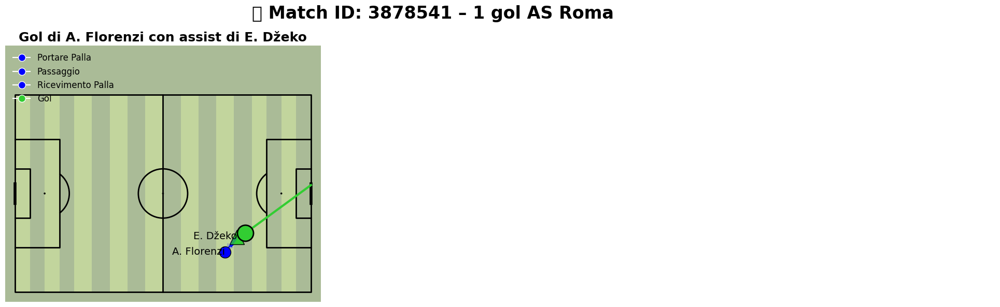

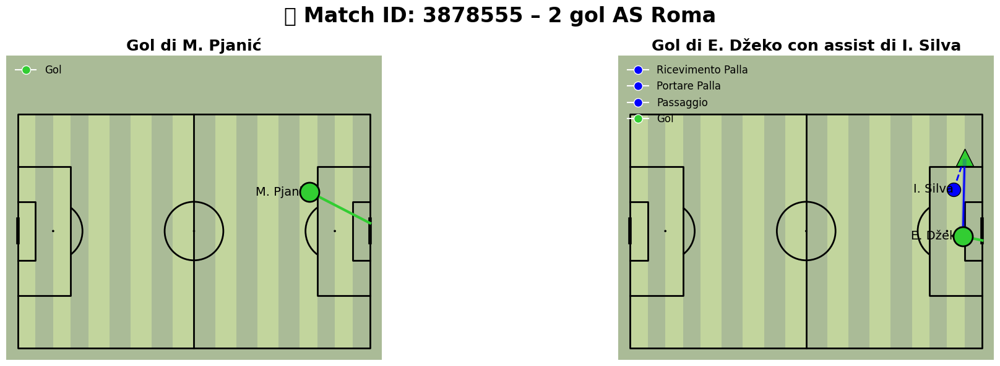

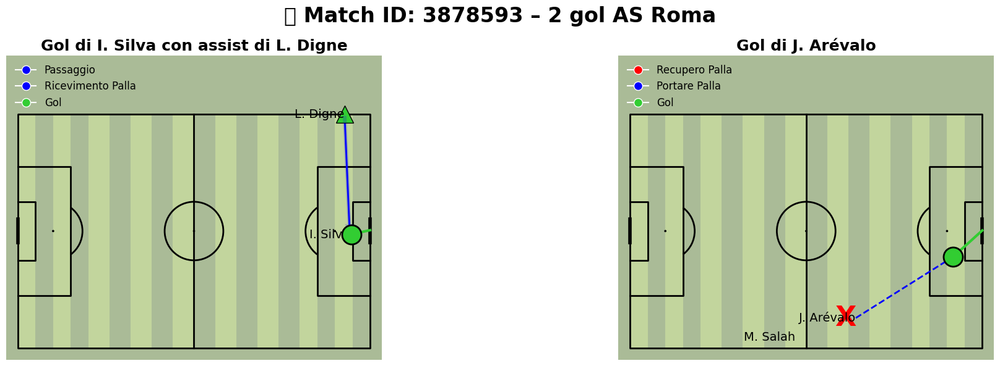

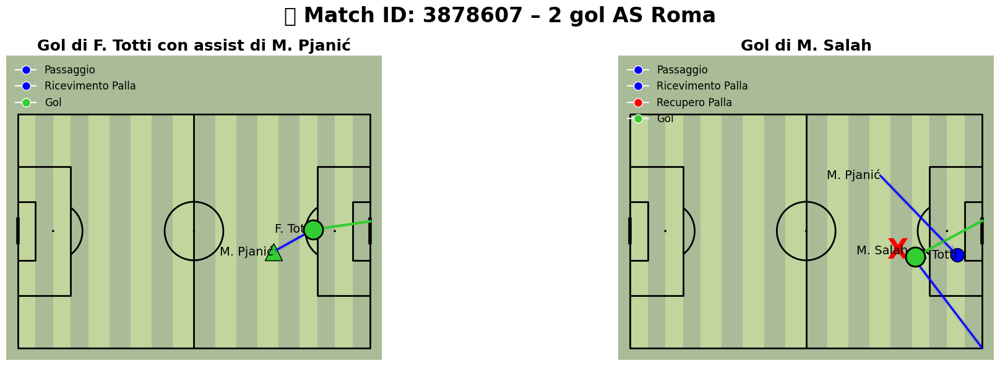

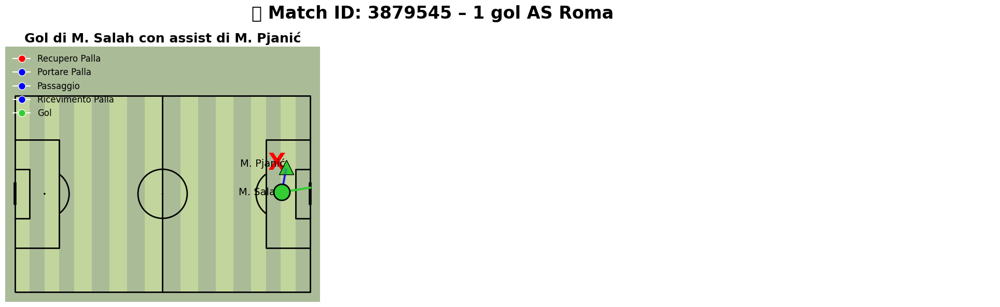

...

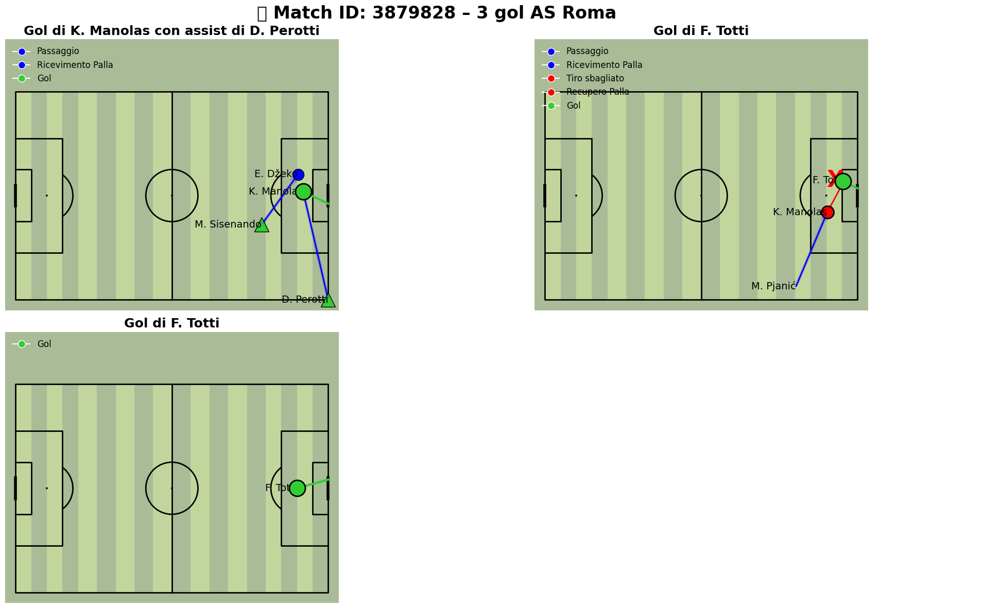

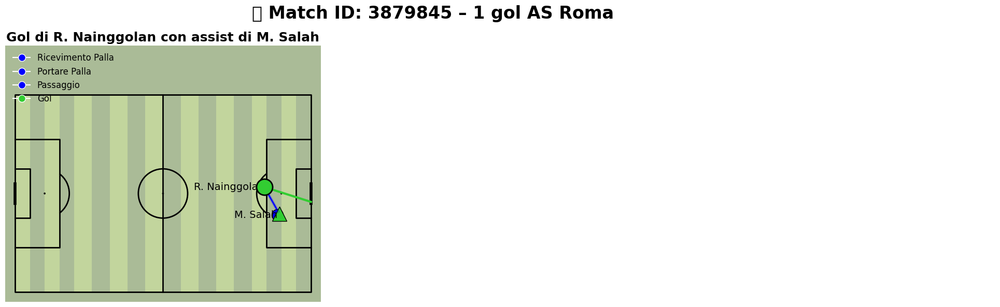

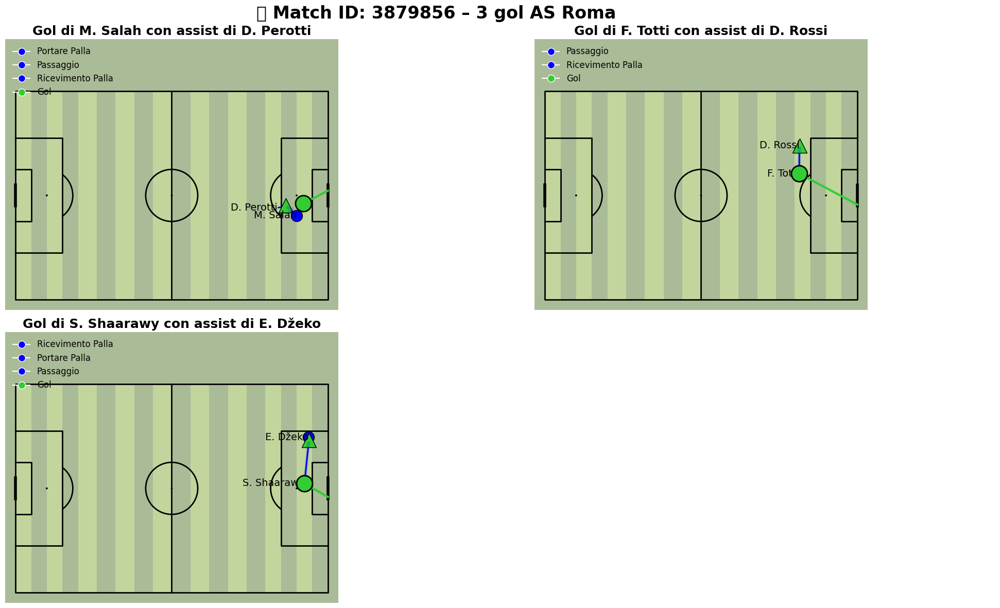

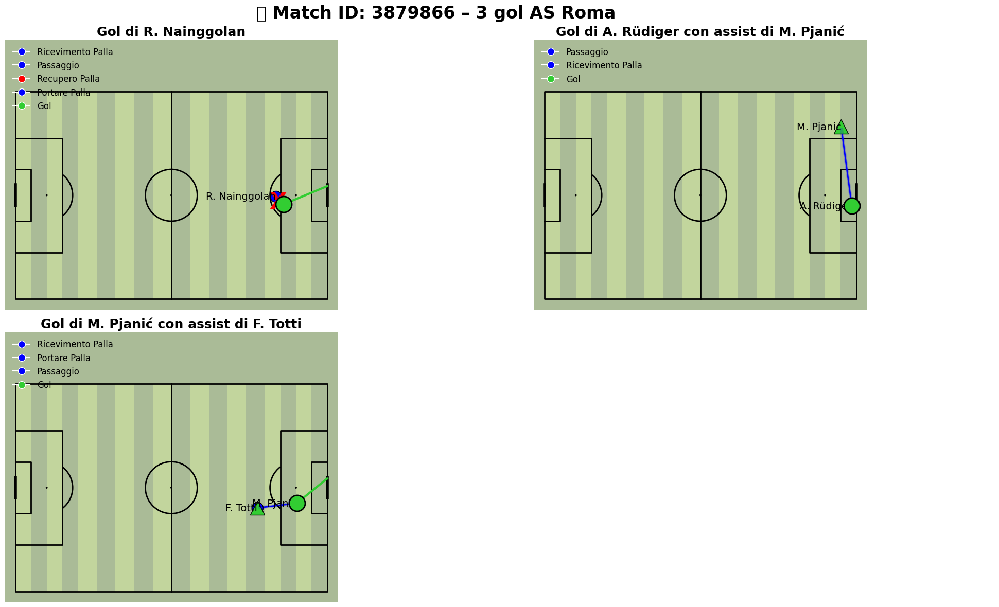

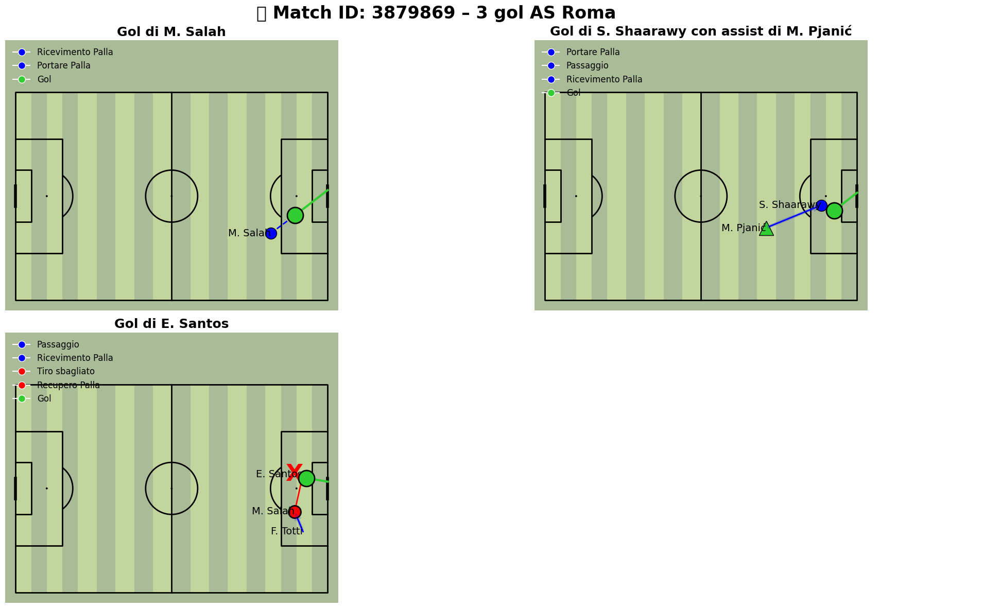

In [ ]:

# tutti i gol della Roma
roma_goals = factGoals[
    (factGoals["team_name"] == "AS Roma") &
    (factGoals["is_goal_event"] == True)
].drop_duplicates(subset=["match_id", "minute", "goal_player_name"])

# Raggruppa i goal per partita
grouped_goals = roma_goals.groupby("match_id")

for match_id, goals_in_match in grouped_goals:
    # Crea dizionario: per ogni gol, ottieni gli eventi precedenti
    events_before_goals_dict = {}
    
    for _, goal_row in goals_in_match.iterrows():
        minute = goal_row["minute"]
        goal_scorer = goal_row["goal_player_name"]
        
        goal_events = factGoals[
            (factGoals["match_id"] == match_id) &
            (factGoals["minute"] == minute) &
            (factGoals["goal_player_name"] == goal_scorer)
        ]
        
        events_before_goals_dict[f"{match_id}-{minute}-{goal_scorer}"] = goal_events

    # -------------------------------
    # GRAFICO
    # -------------------------------
    num_goals = len(events_before_goals_dict)
    ncols = 2
    nrows = (num_goals + 1) // ncols

    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(22, nrows * 6))
    axs = axs.flatten()

    for goal_counter, (goal_id, events) in enumerate(events_before_goals_dict.items()):
        ax = axs[goal_counter]

        # Disegna campo
        pitch = Pitch(line_color="black", pitch_color="#aabb97", stripe_color="#c2d59d",
                      half=False, stripe=True, pad_top=20, pitch_length=140, pitch_width=100)
        pitch.draw(ax=ax)

        goal_scorer = None
        assist_provider = None
        legend_elements = []
        first_event = {}

        for _, row in events.iterrows():
            x, y = row["event_location"]
            next_loc = row.get("next_location", None)
            player = row["event_player_name"]
            event_type = row["event_type"]

            if not isinstance(player, str) or not isinstance(x, (float, int)):
                continue  # salta eventi malformati

            player_short = f"{player.split()[0][0]}. {player.split()[-1]}"

            if player not in first_event:
                first_event[player] = True
                ax.text(x, y, player_short, fontsize=14, ha="right", va="center", color="black", zorder=4)

            # Eventi e simboli
            if event_type == "Ball Recovery":
                ax.text(x, y, "X", fontsize=32, ha="right", color="red", va="center", fontweight="bold", zorder=3)
                legend_elements.append(("Recupero Palla", "red"))

            elif event_type == "Ball Receipt*":
                ax.scatter(x, y, color="blue", s=250, edgecolors="black", zorder=3)
                legend_elements.append(("Ricevimento Palla", "blue"))

            elif event_type == "Carry" and isinstance(next_loc, list):
                x_end, y_end = next_loc[:2]
                ax.plot([x, x_end], [y, y_end], color="blue", linestyle="--", lw=2, zorder=2)
                legend_elements.append(("Portare Palla", "blue"))

            elif event_type == "Pass" and isinstance(next_loc, list):
                x_end, y_end = next_loc[:2]
                ax.plot([x, x_end], [y, y_end], color="blue", lw=2, zorder=2)
                arrow = FancyArrowPatch((x, y), (x_end, y_end), mutation_scale=20, color="blue", lw=0.2, alpha=0.2, zorder=4)
                ax.add_patch(arrow)
                if row["assist_player_name"]:
                    assist_provider = player_short
                    ax.plot(x, y, marker="^", markersize=20, color="limegreen", markeredgecolor="black", zorder=3)
                legend_elements.append(("Passaggio", "blue"))

            elif event_type == "Foul Won":
                ax.scatter(x, y, color="orange", s=300, edgecolors="black", marker="s", zorder=3)
                legend_elements.append(("Foul Won", "orange"))

            elif event_type == "Shot":
                if isinstance(next_loc, list) and len(next_loc) >= 2:
                    x_end, y_end = next_loc[:2]
                else:
                    x_end, y_end = x, y

                if row["is_goal_event"]:
                    goal_scorer = player_short
                    ax.plot([x, x_end], [y, y_end], color="limegreen", linestyle="-", linewidth=3, zorder=3)
                    ax.scatter(x, y, color="limegreen", s=500, edgecolors='black', linewidth=2, zorder=4)
                    legend_elements.append(("Gol", "limegreen"))
                else:
                    ax.plot([x, x_end], [y, y_end], color="red", linestyle='-', linewidth=2, zorder=2)
                    ax.scatter(x, y, color="red", s=300, edgecolors='black', linewidth=2, zorder=3)
                    legend_elements.append(("Tiro sbagliato", "red"))

        # Titolo subplot
        title = f"Gol di {goal_scorer}"
        if assist_provider:
            title += f" con assist di {assist_provider}"
        ax.set_title(title, fontsize=18, fontweight="bold", color="black")

        # Legenda
        seen = set()
        handles = []
        labels = []
        for label, color in legend_elements:
            if label not in seen:
                seen.add(label)
                handles.append(plt.Line2D([0], [0], marker="o", color="w", markerfacecolor=color, markersize=10))
                labels.append(label)
        ax.legend(handles=handles, labels=labels, loc="upper left", fontsize=12, frameon=False)

    # Nascondi subplot vuoti
    for j in range(goal_counter + 1, len(axs)):
        axs[j].axis("off")

    # Titolo del blocco di grafici per match
    fig.suptitle(f"⚽ Match ID: {match_id} – {num_goals} gol AS Roma", fontsize=24, fontweight="bold")
    plt.tight_layout()
    plt.show()


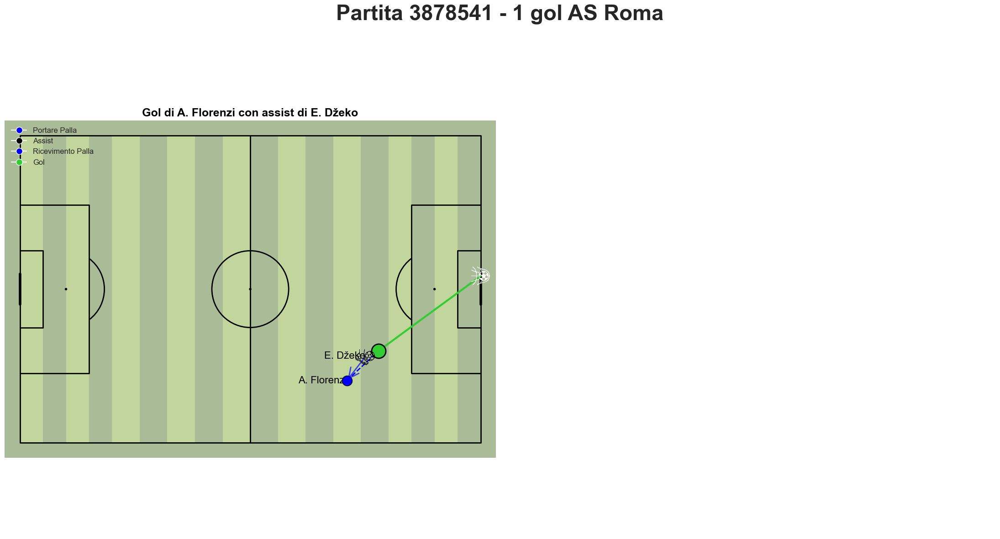

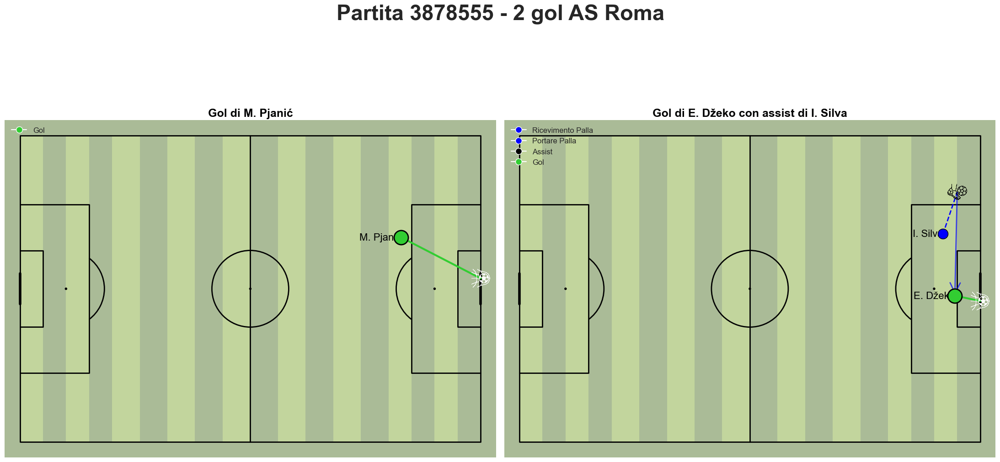

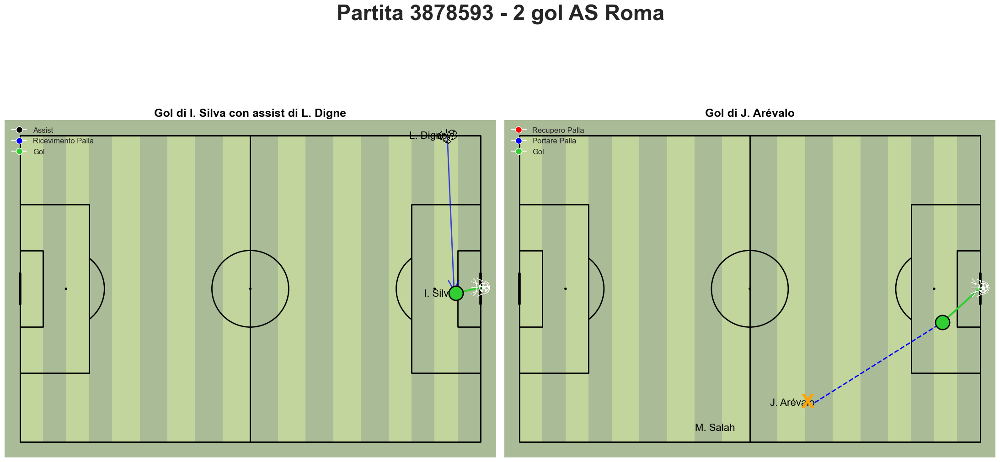

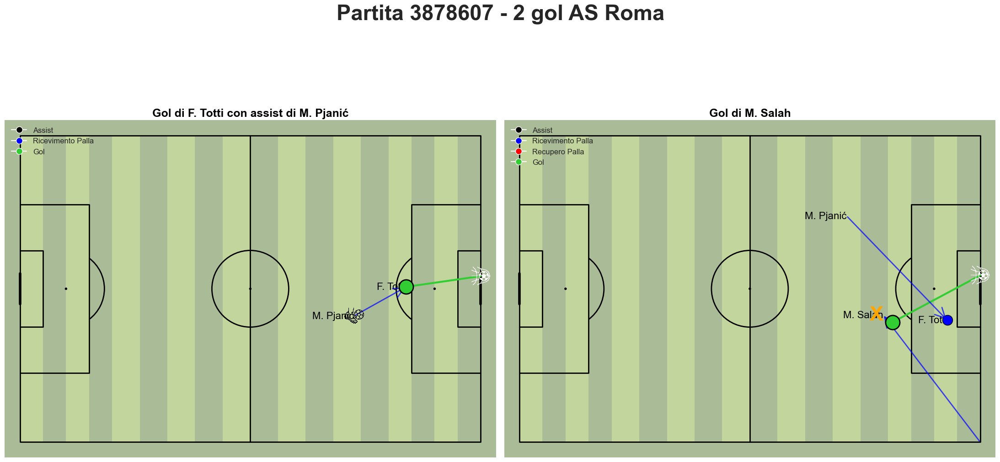

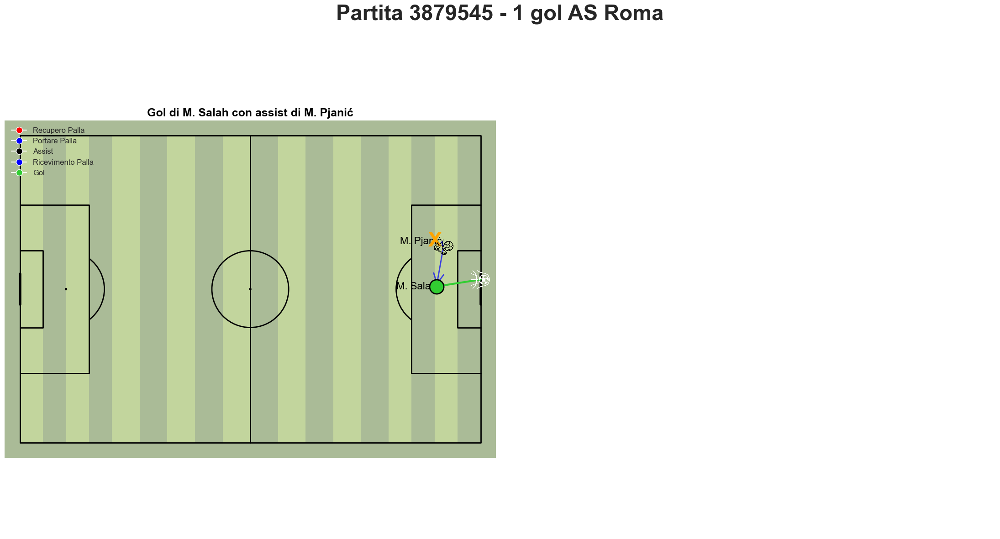

...

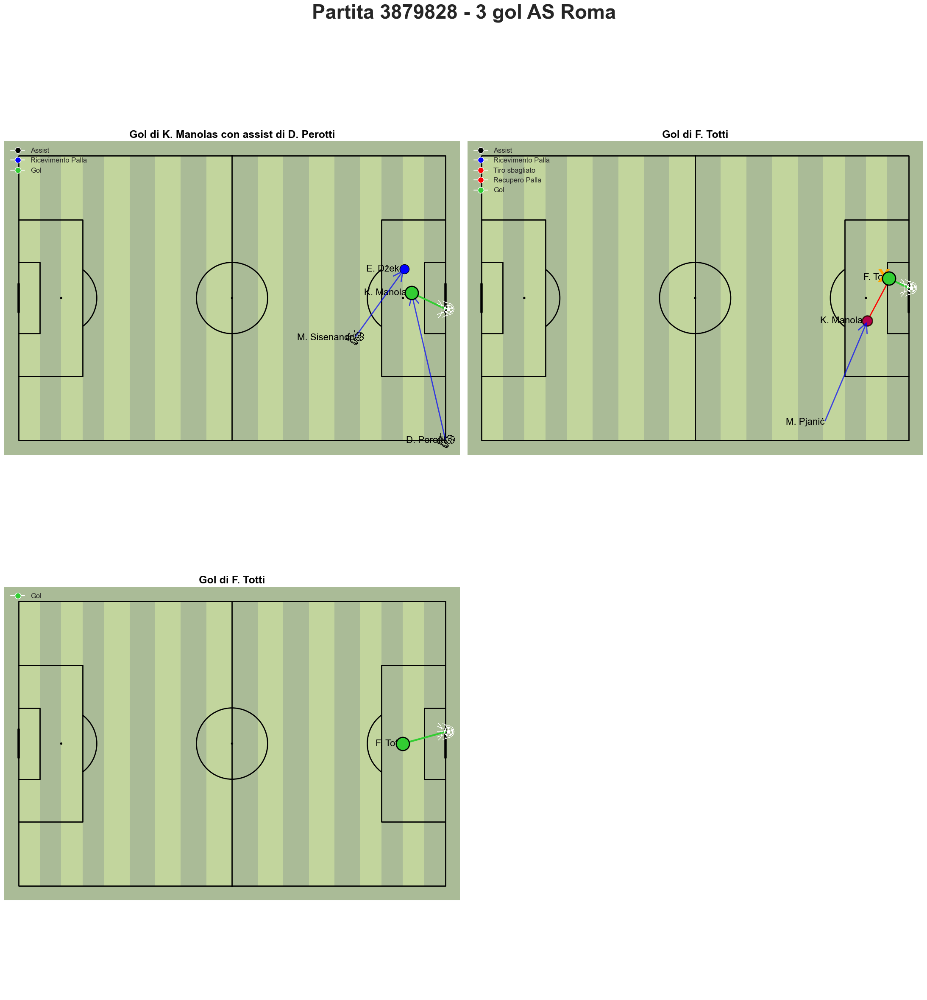

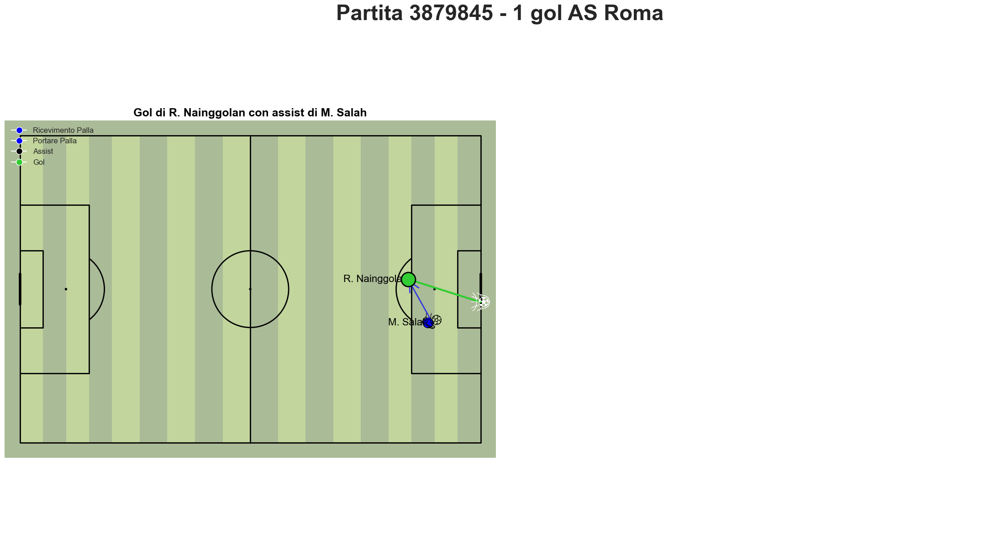

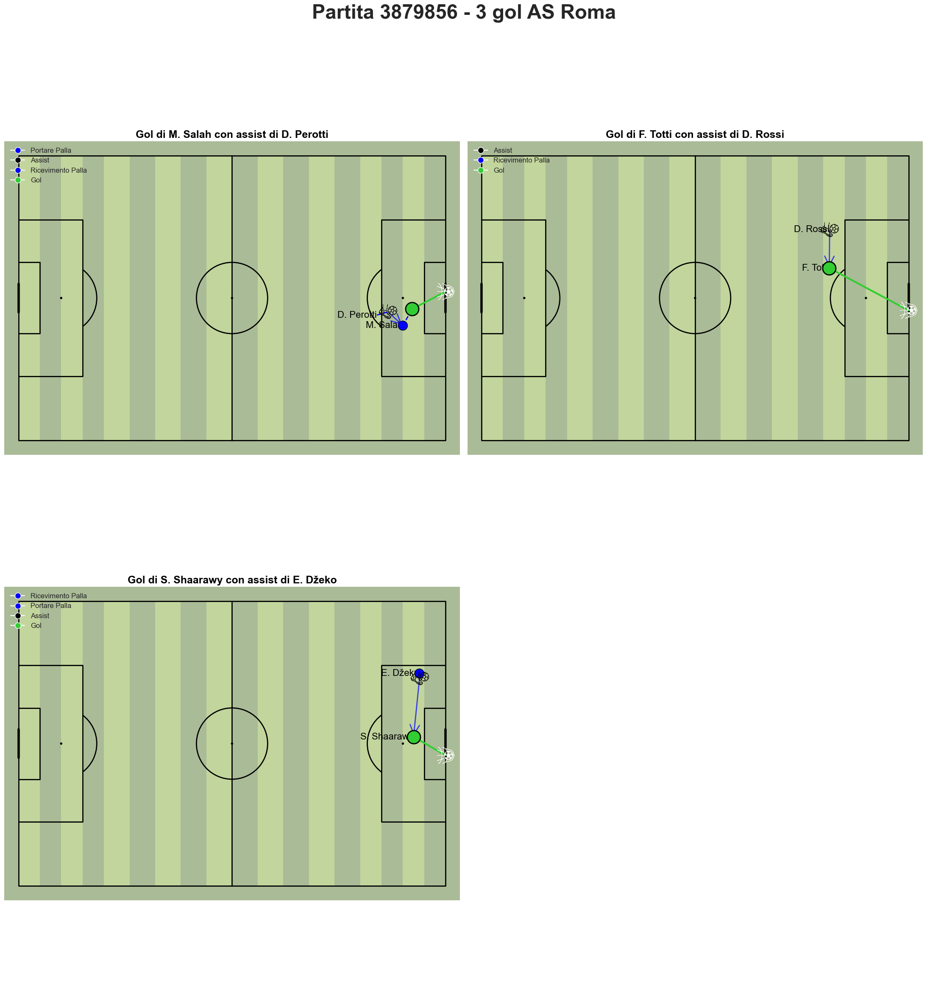

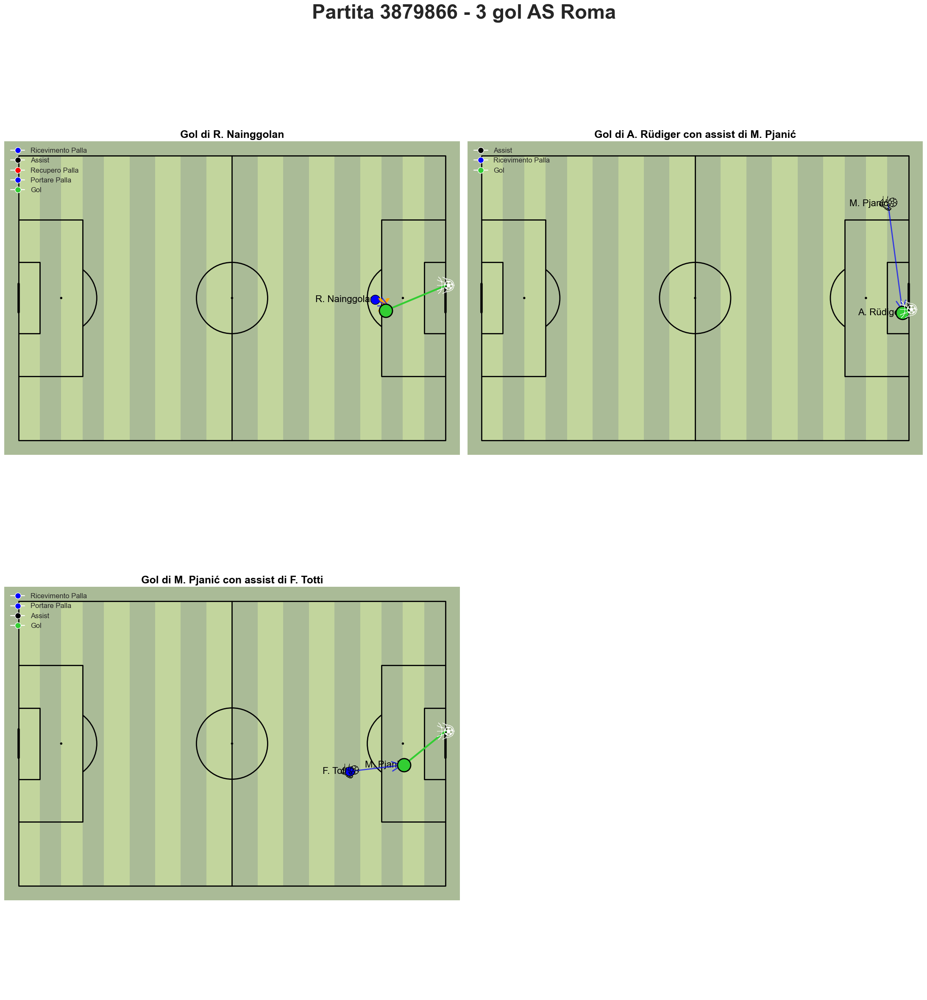

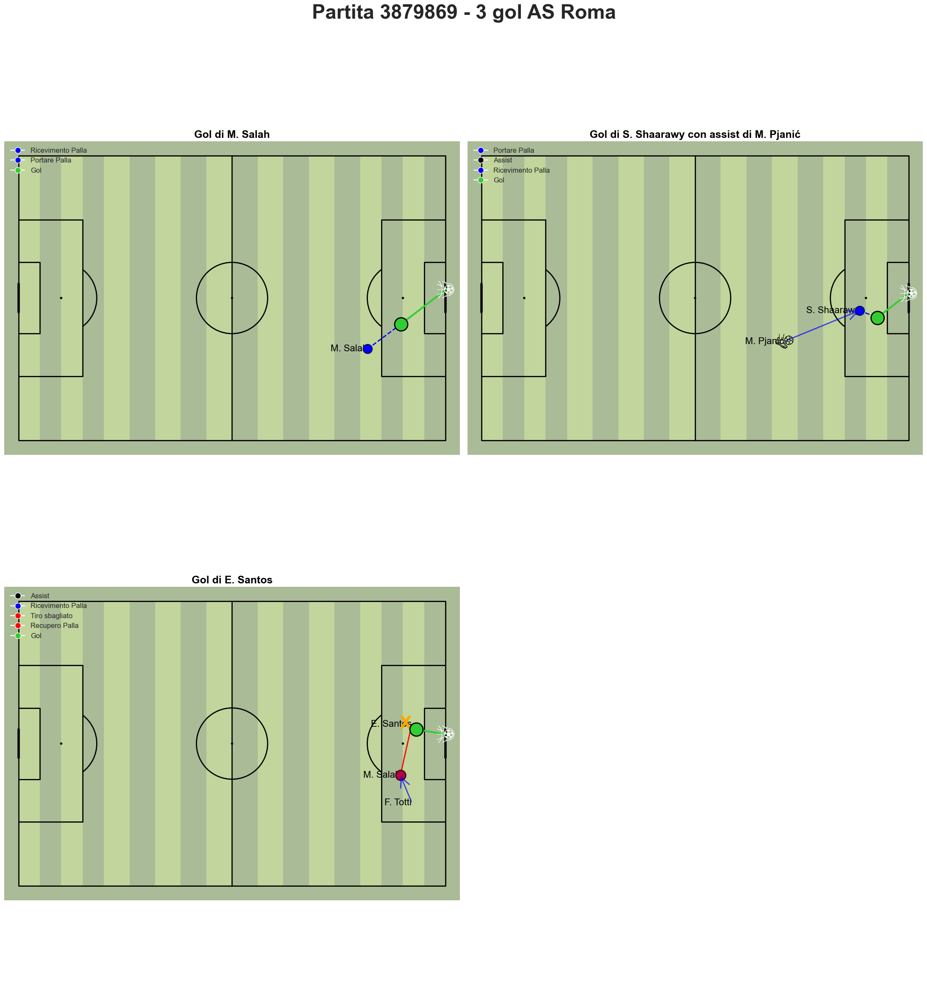

In [ ]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import matplotlib.image as mpimg
from PIL import Image

def colorize_png(path, color_rgb):
    img = Image.open(path).convert("RGBA")
    data = np.array(img)

    # Estrai i canali
    r, g, b, a = data.T

    # Trova i pixel neri o quasi neri (tolleranza)
    black_areas = (r < 50) & (g < 50) & (b < 50)

    # Applica il nuovo colore solo alle aree nere
    data[..., :-1][black_areas.T] = color_rgb

    return data


# Impostazione dello stile
plt.style.use('seaborn-v0_8-darkgrid')

# Funzione per creare il grafico dei gol
def plot_goal(events, ax):
    pitch = Pitch(line_color="black", pitch_color="#aabb97", stripe_color="#c2d59d", half=False, stripe=True)
    #pitch = VerticalPitch(line_color="black", pitch_color="#aabb97", stripe_color="#c2d59d", half=False, stripe=True)
    #pitch = Pitch(pitch_color='black', line_color='white')  # tipo “Champions League” style
    #pitch = Pitch(pitch_color='white', line_color='black')  # campo bianco per pubblicazioni
    #pitch = Pitch(pitch_color='grass', line_color='black')  # campo verde realistico
    pitch.draw(ax=ax)

    goal_scorer = None
    assist_provider = None
    legend_elements = []
    first_event = {}

    for idx, row in events.iterrows():
        x, y = row['event_location']
        next_loc = row.get('next_location', None)
        player = row['event_player_name']
        event_type = row['event_type']

        # Mostra nome solo la prima volta
        player_short = f"{player.split()[0][0]}. {player.split()[-1]}"
        if player not in first_event:
            first_event[player] = True
            ax.text(x, y, player_short, fontsize=16, ha="right", va="center", color="black", zorder=1)

        # Eventi e simboli
        if event_type == "Ball Recovery":
            ax.text(x, y, "X", fontsize=32, ha="right", color="orange", va="center", fontweight="bold", zorder=3)
            legend_elements.append(("Recupero Palla", "red"))

        elif event_type == "Ball Receipt*":
            ax.scatter(x, y, color="blue", s=250, edgecolors="black", zorder=3)
            legend_elements.append(("Ricevimento Palla", "blue"))

        elif event_type == "Carry" and isinstance(next_loc, list):
            x_end, y_end = next_loc
            ax.plot([x, x_end], [y, y_end], color="blue", linestyle="--", lw=2, zorder=2)
            legend_elements.append(("Portare Palla", "blue"))

        elif event_type == "Pass" and isinstance(next_loc, list):
            x_end, y_end = next_loc
            arrow = FancyArrowPatch( (x, y), (x_end, y_end), arrowstyle="->", mutation_scale=40, color="blue", lw=2,alpha=0.7,zorder=4)
            ax.add_patch(arrow)

            if row["assist_player_name"]:
                assist_provider = player_short
                #ax.plot(x, y, marker="^", markersize=20, color="limegreen", markeredgecolor="black", zorder=3)
                assist_img_data = colorize_png("assist.png", (0, 0, 0))  # nero
                assist_box = OffsetImage(assist_img_data, zoom=0.06)
                ab_assist = AnnotationBbox(assist_box, (x, y), frameon=False, zorder=5)
                ax.add_artist(ab_assist)

            legend_elements.append(("Assist", "black"))


        elif event_type == "Shot":
            # Controlla se next_loc è valido per ottenere la posizione finale del tiro
            if isinstance(next_loc, list) and len(next_loc) >= 2:
                x_end, y_end = next_loc[:2]
            else:
                x_end, y_end = x, y

            # Solo per il gol, aggiungi l'emoji del pallone
            if row["is_goal_event"]:  # Se è un gol
                goal_scorer = player_short
                ax.plot([x, x_end], [y, y_end], color="limegreen", linestyle="-", linewidth=3, zorder=3)
                ax.scatter(x, y, color="limegreen", s=500, edgecolors='black', linewidth=2, zorder=4)

                # Aggiungi un'emoji del pallone al termine del gol
                #ax.text(x_end, y_end, "⚽", fontsize=24, ha="center", va="center", color="black", zorder=5)

                goal_img_data = colorize_png("goal.png", (255, 255, 255))  # bianco
                goal_box = OffsetImage(goal_img_data, zoom=0.06)
                ab_goal = AnnotationBbox(goal_box, (x_end, y_end), frameon=False, zorder=5)
                ax.add_artist(ab_goal)

                legend_elements.append(("Gol", "limegreen"))
            
            else:
                ax.plot([x, x_end], [y, y_end], color="red", linestyle='-', linewidth=2, zorder=2)
                ax.scatter(x, y, color="red", s=300, edgecolors='black', linewidth=2, zorder=3, alpha=0.7)
                legend_elements.append(("Tiro sbagliato", "red"))

    # Titolo del singolo subplot
    title = f"Gol di {goal_scorer}"
    if assist_provider:
        title += f" con assist di {assist_provider}"
    ax.set_title(title, fontsize=18, fontweight="bold", color="black")

    # Legenda pulita (senza duplicati)
    seen = set()
    handles = []
    labels = []
    for label, color in legend_elements:
        if label not in seen:
            seen.add(label)
            handles.append(plt.Line2D([0], [0], marker="o", color="w", markerfacecolor=color, markersize=10))
            labels.append(label)
    ax.legend(handles=handles, labels=labels, loc="upper left", fontsize=12, frameon=False)

# solo i gol segnati dalla Roma
roma_goals = factGoals[(factGoals["team_name"] == "AS Roma") &(factGoals["is_goal_event"] == True)].drop_duplicates(subset=["match_id", "minute", "goal_player_name"])

# Crea dizionario dei goal -> lista di eventi
events_before_goals_dict = {}

for _, goal_row in roma_goals.iterrows():
    match_id = goal_row["match_id"]
    minute = goal_row["minute"]
    goal_scorer = goal_row["goal_player_name"]

    goal_events = factGoals[(factGoals["match_id"] == match_id) & (factGoals["minute"] == minute) & (factGoals["goal_player_name"] == goal_scorer)]
    events_before_goals_dict[f"{match_id}-{minute}-{goal_scorer}"] = goal_events

# -------------------------------
# GRAFICO
# -------------------------------
# Raggruppa per partita i gol
matches = roma_goals["match_id"].unique()

# Creazione dei grafici per ogni partita
for match_id in matches:
    # Filtro per gol della partita corrente
    match_goals = roma_goals[roma_goals["match_id"] == match_id]
    
    # Calcola il numero di gol per la partita corrente
    n_goals = len(match_goals)

    # Variabili per gestione delle dimensioni
    ncols = 2  # colonne per la visualizzazione
    nrows = (n_goals + ncols - 1) // ncols  # calcola righe in base al numero di gol

    # Crea un subplot per questa partita
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(22, nrows * 12))
    axs = axs.flatten()

    goal_counter = 0
    for _, goal_row in match_goals.iterrows():
        minute = goal_row["minute"]
        goal_scorer = goal_row["goal_player_name"]
        goal_events = events_before_goals_dict[f"{match_id}-{minute}-{goal_scorer}"]
        
        ax = axs[goal_counter]
        plot_goal(goal_events, ax)
        
        goal_counter += 1

    # Disattiva gli assi inutilizzati
    for j in range(goal_counter, len(axs)):
        axs[j].axis("off")

    # Titolo generale della partita
    fig.suptitle(f"Partita {match_id} - {n_goals} gol AS Roma", fontsize=34, fontweight="bold", ha="center", va="top")

    # Ottimizza il layout per evitare sovrapposizioni
    plt.tight_layout(rect=[0, 0, 1, 0.97])  # Aggiungi un po' di spazio per il titolo

    plt.show()


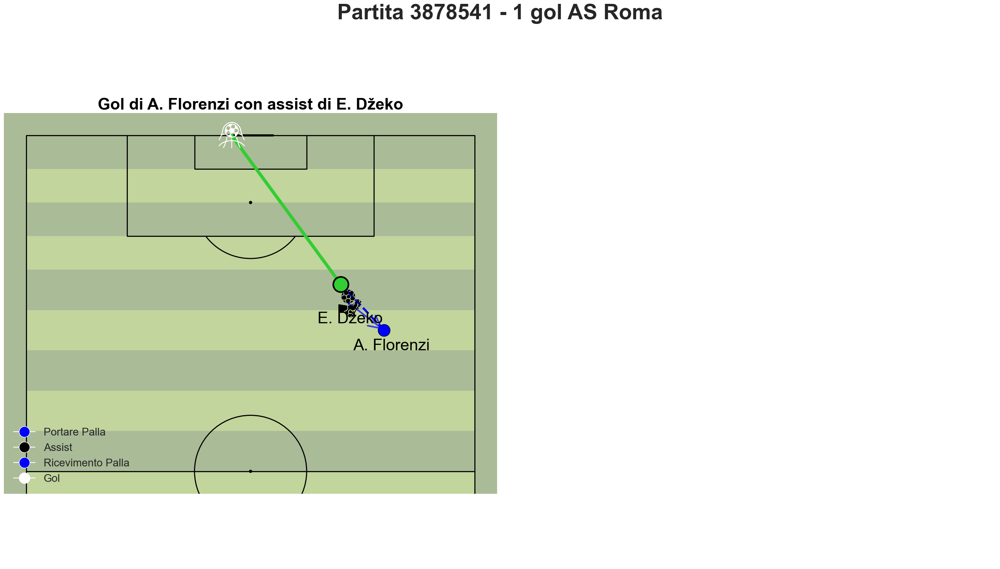

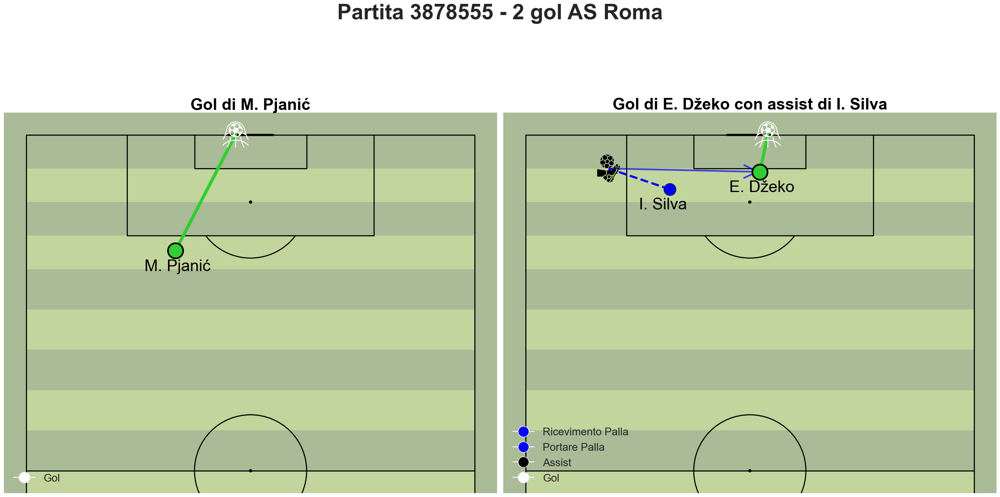

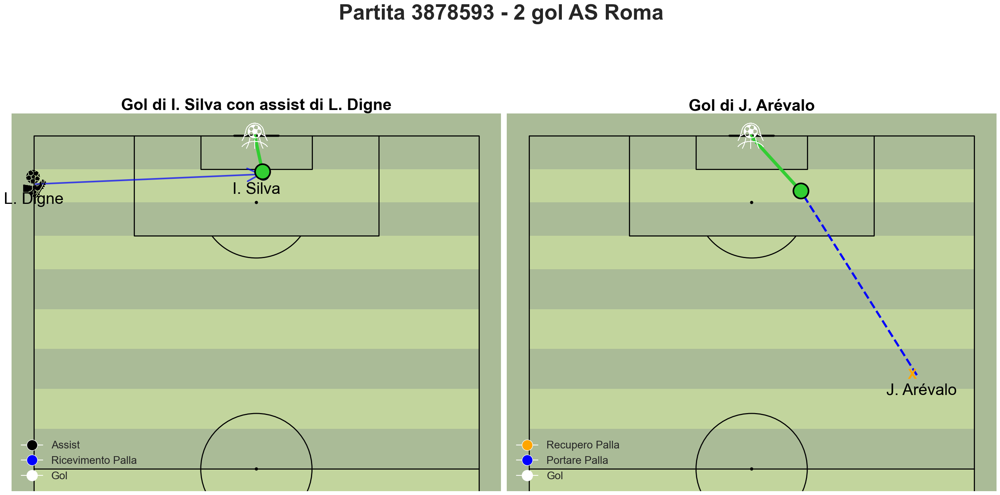

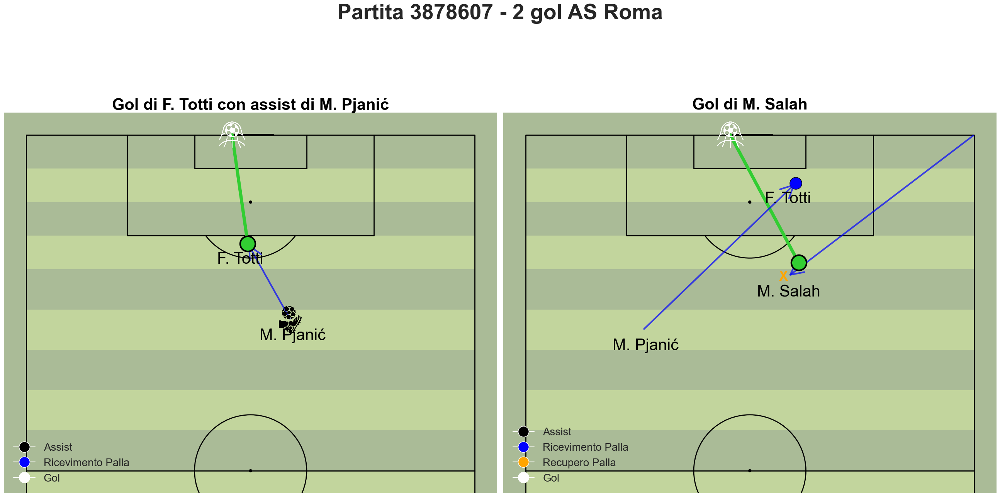

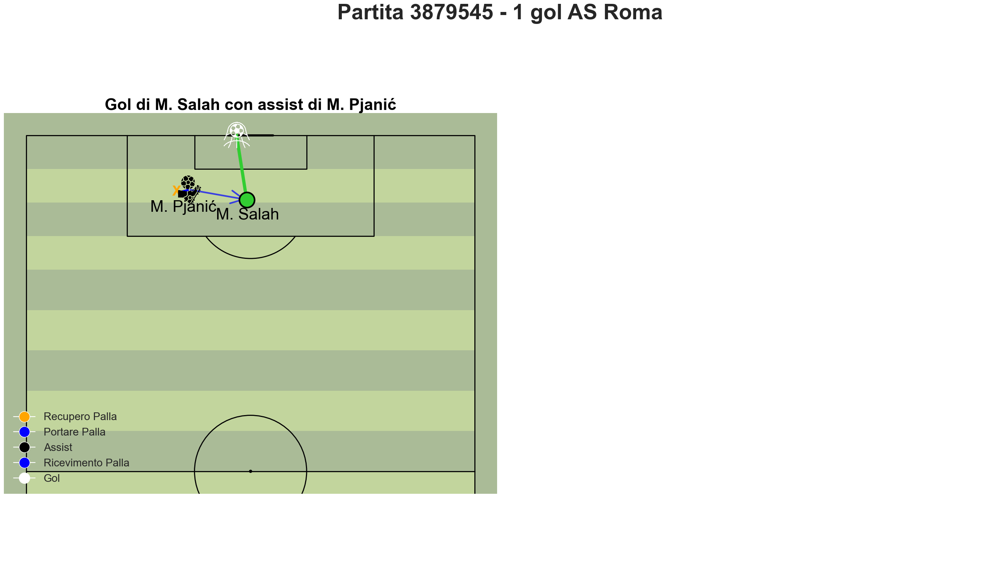

...

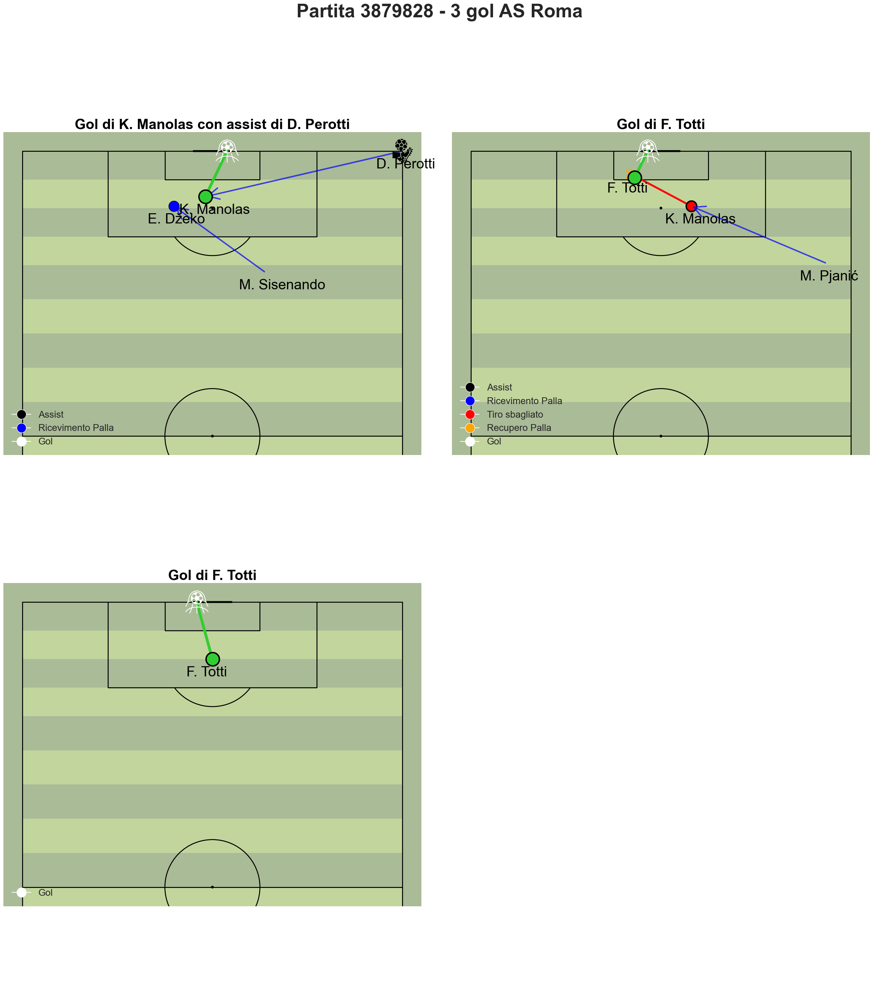

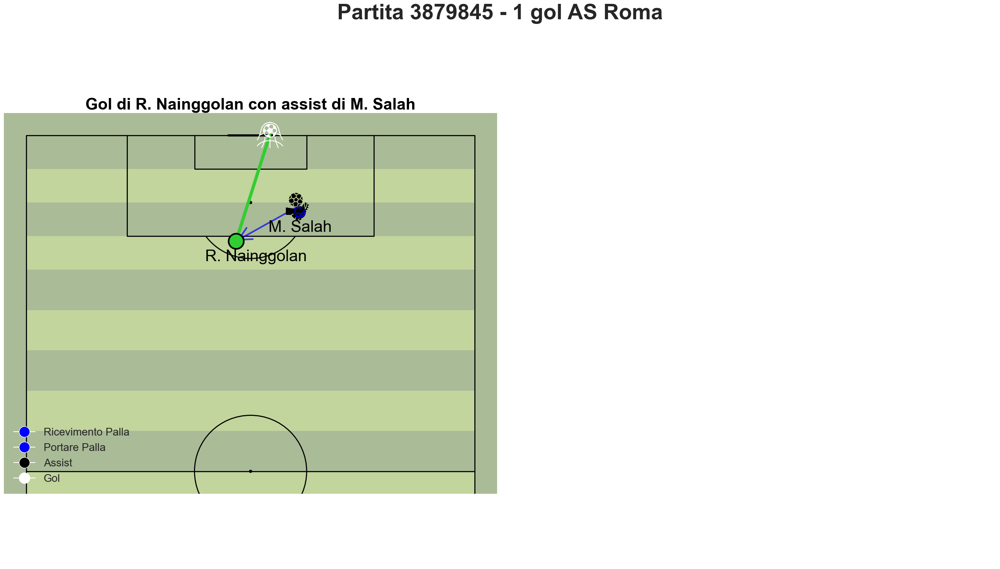

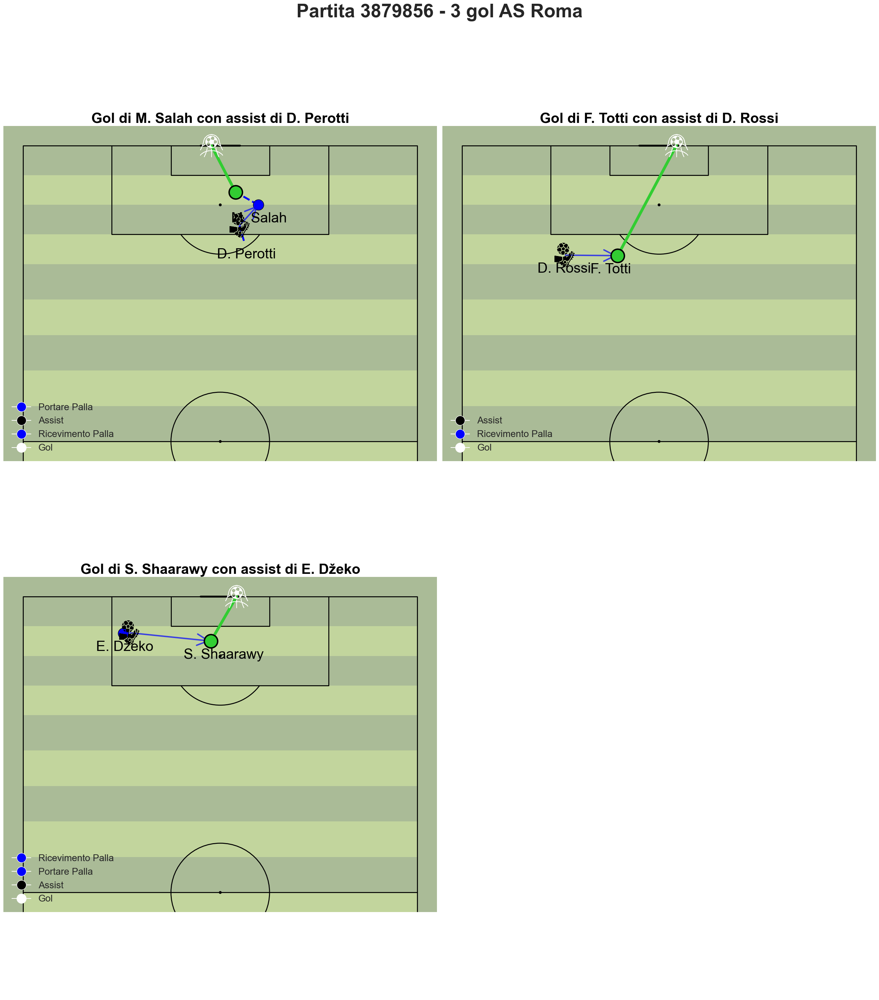

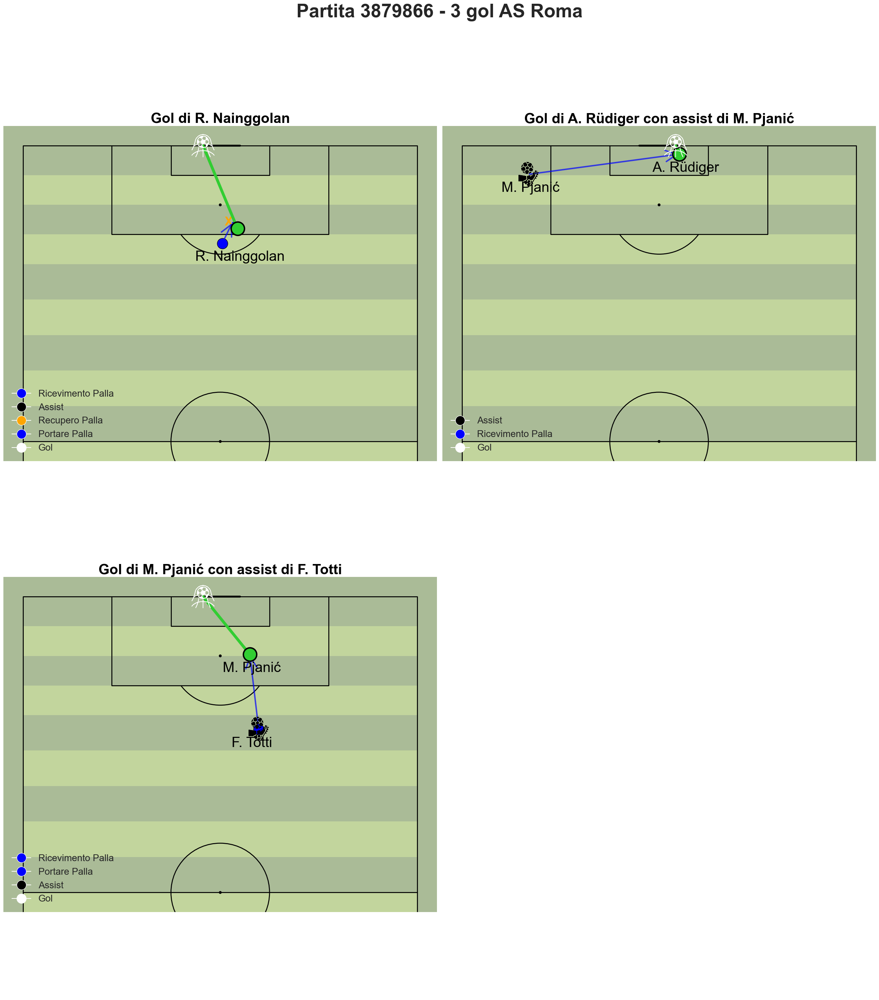

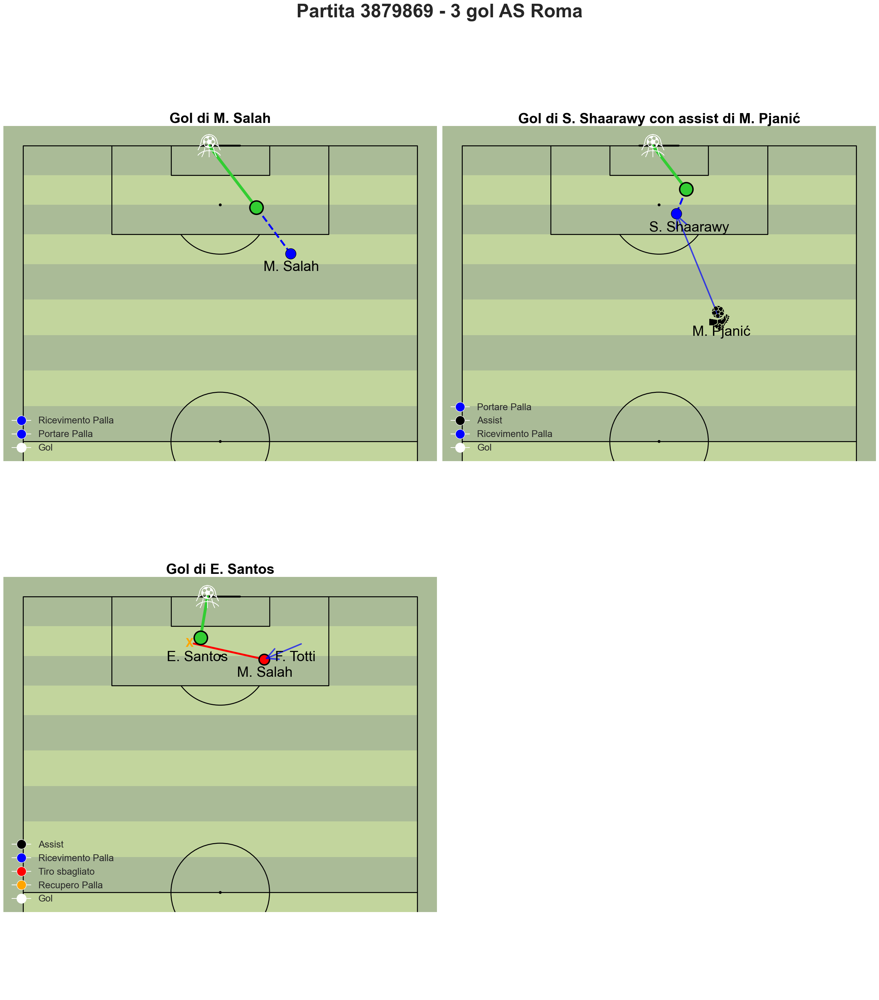

In [ ]:


# Funzione per colorare l'immagine PNG (bianco) e ruotarla di 90 gradi, con bordo per simulare il grassetto
def colorize_pngVertical(image_path, color, border_thickness=10):
    # Carica l'immagine
    img = Image.open(image_path)
    
    # Converte l'immagine in RGB
    img = img.convert("RGBA")
    data = np.array(img)
    
    # Crea una maschera per la trasparenza
    r, g, b, a = data[:,:,0], data[:,:,1], data[:,:,2], data[:,:,3]
    
    # Cambia il colore dell'immagine in bianco, mantenendo la trasparenza
    data[:,:,:3] = color

    # Riapplica la trasparenza originale
    data[:,:,3] = a
    
    # Crea una nuova immagine con il colore cambiato
    colored_img = Image.fromarray(data, "RGBA")
    
    # Ruota l'immagine di 90 gradi verso l'alto
    rotated_img = colored_img.rotate(90, expand=True)
    
    return rotated_img

def plot_goal(events, ax):
    pitch = VerticalPitch(line_color="black", pitch_color="#aabb97", stripe_color="#c2d59d", half=True, stripe=True)
    pitch.draw(ax=ax)

    goal_scorer = None
    assist_provider = None
    legend_elements = []
    first_event = {}
    used_positions = set()  # Set per tracciare le posizioni occupate

    for idx, row in events.iterrows():
        x, y = row['event_location']
        next_loc = row.get('next_location', None)
        player = row['event_player_name']
        event_type = row['event_type']

        # Correggi le coordinate per il campo verticale
        x, y = y, x  # Scambia le coordinate x e y

        player_short = f"{player.split()[0][0]}. {player.split()[-1]}"

        if y < 60:
            continue

        # Eventi e simboli
        if event_type == "Ball Recovery":
            ax.text(x, y, "X", fontsize=25, ha="right", color="orange", va="center", fontweight="bold", zorder=3)
            legend_elements.append(("Recupero Palla", "orange"))

        elif event_type == "Ball Receipt*":
            ax.scatter(x, y, color="blue", s=500, edgecolors="black", zorder=3)
            legend_elements.append(("Ricevimento Palla", "blue"))

        elif event_type == "Carry" and isinstance(next_loc, list):
            x_end, y_end = next_loc
            x_end, y_end = y_end, x_end  # Correggi anche le coordinate di next_loc
            ax.plot([x, x_end], [y, y_end], color="blue", linestyle="--", lw=4, zorder=2)
            legend_elements.append(("Portare Palla", "blue"))

        elif event_type == "Pass" and isinstance(next_loc, list):
            x_end, y_end = next_loc
            x_end, y_end = y_end, x_end  # Correggi anche le coordinate di next_loc
            arrow = FancyArrowPatch((x, y), (x_end, y_end), arrowstyle="->", mutation_scale=60, color="blue", lw=3, alpha=0.7, zorder=4)
            ax.add_patch(arrow)

            if row["assist_player_name"]:
                assist_provider = player_short
                x_assist = x
                y_assist = y
                #ax.plot(x, y, marker="^", markersize=20, color="limegreen", markeredgecolor="black", zorder=3)
                # assist_img_data = colorize_pngVertical("assist2.png", (0, 0, 0))  
                # assist_box = OffsetImage(assist_img_data, zoom=0.1)
                # ab_assist = AnnotationBbox(assist_box, (x, y), frameon=False, zorder=5)
                # ax.add_artist(ab_assist)

            legend_elements.append(("Assist", "black"))

        elif event_type == "Shot":
            if isinstance(next_loc, list) and len(next_loc) >= 2:
                x_end, y_end = next_loc[:2]
            else:
                x_end, y_end = x, y
            x_end, y_end = y_end, x_end  # Correggi anche le coordinate del tiro

            if row["is_goal_event"]:  # Se è un gol
                goal_scorer = player_short
                ax.plot([x, x_end], [y, y_end], color="limegreen", linestyle="-", linewidth=6, zorder=3)
                ax.scatter(x, y, color="limegreen", s=800, edgecolors='black', linewidth=3, zorder=4)

                ball_img = colorize_pngVertical("goal.png", (255, 255, 255))  # bianco
                imagebox = OffsetImage(ball_img, zoom=0.1)
                ab = AnnotationBbox(imagebox, (x_end, y_end), frameon=False, zorder=5)
                ax.add_artist(ab)

                # Se c'è stato un assist, aggiungi l'icona dell'assist solo per l'ultimo assistente
                if assist_provider:
                    assist_img_data = colorize_pngVertical("assist2.png", (0, 0, 0))  
                    assist_box = OffsetImage(assist_img_data, zoom=0.1)
                    ab_assist = AnnotationBbox(assist_box, (x_assist, y_assist), frameon=False, zorder=6)
                    ax.add_artist(ab_assist)

                legend_elements.append(("Gol", "white"))
            
            else:
                ax.plot([x, x_end], [y, y_end], color="red", linestyle='-', linewidth=4, zorder=2)
                ax.scatter(x, y, color="red", s=500, edgecolors='black', linewidth=3, zorder=3)
                legend_elements.append(("Tiro sbagliato", "red"))

        # Mostra nome solo la prima volta
        if player not in first_event:
            first_event[player] = True
            ax.text(x-5.5, y-1.5, player_short, fontsize=30, ha="left", va="top", color="black", zorder=10)

    # Titolo del singolo subplot
    title = f"Gol di {goal_scorer}"
    if assist_provider:
        title += f" con assist di {assist_provider}"
    ax.set_title(title, fontsize=30, fontweight="bold", color="black")

    # Legenda pulita (senza duplicati)
    seen = set()
    handles = []
    labels = []
    for label, color in legend_elements:
        if label not in seen:
            seen.add(label)
            handles.append(plt.Line2D([0], [0], marker="o", color="w", markerfacecolor=color, markersize=20))
            labels.append(label)
    ax.legend(handles=handles, labels=labels, loc="lower left", fontsize=20, frameon=False)

# fig, ax = plt.subplots(figsize=(12, 8))
# plot_goal(events, ax)

# Filtro: solo i gol segnati dalla Roma
roma_goals = factGoals[(factGoals["team_name"] == "AS Roma") & (factGoals["is_goal_event"] == True)].drop_duplicates(subset=["match_id", "minute", "goal_player_name"])

# Crea dizionario dei goal -> lista di eventi
events_before_goals_dict = {}

for _, goal_row in roma_goals.iterrows():
    match_id = goal_row["match_id"]
    minute = goal_row["minute"]
    goal_scorer = goal_row["goal_player_name"]

    goal_events = factGoals[(factGoals["match_id"] == match_id) &(factGoals["minute"] == minute) &(factGoals["goal_player_name"] == goal_scorer)]
    events_before_goals_dict[f"{match_id}-{minute}-{goal_scorer}"] = goal_events

# -------------------------------
# GRAFICO
# -------------------------------
# Raggruppa per partita i gol
matches = roma_goals["match_id"].unique()

# Creazione dei grafici per ogni partita
for match_id in matches:
    # Filtro per gol della partita corrente
    match_goals = roma_goals[roma_goals["match_id"] == match_id]
    
    # Calcola il numero di gol per la partita corrente
    n_goals = len(match_goals)

    # Variabili per gestione delle dimensioni
    ncols = 2  # colonne per la visualizzazione
    nrows = (n_goals + ncols - 1) // ncols  # calcola righe in base al numero di gol

    # Crea un subplot per questa partita
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(26, nrows * 15))
    axs = axs.flatten()

    goal_counter = 0
    for _, goal_row in match_goals.iterrows():
        minute = goal_row["minute"]
        goal_scorer = goal_row["goal_player_name"]
        goal_events = events_before_goals_dict[f"{match_id}-{minute}-{goal_scorer}"]
        
        ax = axs[goal_counter]
        plot_goal(goal_events, ax)
        
        goal_counter += 1

    # Disattiva gli assi inutilizzati
    for j in range(goal_counter, len(axs)):
        axs[j].axis("off")

    # Titolo generale della partita
    fig.suptitle(f"Partita {match_id} - {n_goals} gol AS Roma", fontsize=40, fontweight="bold", ha="center", va="top")

    # Ottimizza il layout per evitare sovrapposizioni
    plt.tight_layout(rect=[0, 0, 1, 0.97])  # Aggiungi un po' di spazio per il titolo

    plt.show()


In [234]:
# VERSIONE 3
onT = ["Saved", "Saved to Post","Goal"]
post = ["Saved to Post","Post"]

def createPlayersOverview(teamName):
    print("Costruzione data - ", teamName)
    teamName_matches = []
    for match in matches_sorted:
        if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName:
            teamName_matches.append(match)

    teamName_df = json_normalize(teamName_matches, sep="_")

    players_season_overview = pd.DataFrame()
    matchweek = 0

    teamName_events = {}
    match_id_lst = list(teamName_df["match_id"])

    for mtc in match_id_lst:
        events = requests.get("https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/"+str(mtc)+".json")
        events = events.json()
        # ogni partita avrà come chiave l'id della partita
        teamName_events[str(mtc)] = json_normalize(events, sep="_")

    print("Eventi Caricati")

    tso = createOverview(teamName)

    print("Season Overview - ", teamName, " Caricato")

    for index, row in tso.iterrows():
        m_id = row["match_id"]
        m_events = teamName_events[m_id]

        # !!!Prendiamo gli autogol contro (quindi fatti dai giocatori del teamName)
        own_goals_against = teamName_events[m_id]
        own_goals_against = own_goals_against[(own_goals_against["type_name"] == "Own Goal Against") & (own_goals_against["player_name"].notna())]

        # Li aggiungiamo temporaneamente agli eventi della partita
        if not own_goals_against.empty:
            m_events = pd.concat([m_events, own_goals_against], ignore_index=True)

        m_events = m_events[m_events["team_name"] == teamName]
        m_events["timestamp"] = pd.to_timedelta(m_events["timestamp"])
        m_players = m_events[(m_events["team_name"] == teamName) & (m_events["player_name"].notna())]["player_name"].unique()
        m_overview = pd.DataFrame(index=m_players)

        print(teamName, " - Caricamento ", m_id , " ... ", end="")

        for p in m_players:
            print(p," ", end="")
            #aggiungo id della partita
            m_overview.at[p, "match_id"] = m_id
            m_overview.at[p, "team_name"] = teamName

            min_tot = m_events.groupby("period")["timestamp"].max() #minuti raggruppati per tempo
            min_1Half = min_tot.values[0] #estratto i minuti del primo e secondo tempo
            min_2Half = min_tot.values[1]

            if (m_events["substitution_replacement_name"] == p).any():
                sub = m_events[m_events["substitution_replacement_name"] == p] #prendo la riga che come evento la sostituzione del player p
                m_overview.at[p, "is_starter"] = False #non è titolare
                m_overview.at[p, "period_subbedIn"] = str(sub["period"].values[0]) #salvo il tempo in cui è subentrato
                min_subbedIn = sub["timestamp"]
                
                if (sub["period"] == 1).any():
                    fullTime_min = ((min_1Half - min_subbedIn) + min_2Half).sum().total_seconds() / 60
                else:
                    fullTime_min = ((min_2Half - min_subbedIn)).sum().total_seconds() / 60
            else:
                m_overview.at[p, "is_starter"] = True
                fullTime_min = min_tot.sum().total_seconds() / 60
            m_overview.at[p, "min_played"] = round(fullTime_min, 2)

            print("Prime colonne create - ", end="")

            # Calcolo dei gol concessi per portiere
            gk_events = m_events[(m_events["type_name"] == "Goal Keeper") & 
                                (m_events["goalkeeper_type_name"] == "Goal Conceded")]

            gk_conceded = gk_events["player_name"].value_counts()
            gk_conceded_period = gk_events.groupby(["player_name", "period"]).size().unstack(fill_value=0)

            for player in m_overview.index:
                pos = m_events[m_events["player_name"] == player]["position_name"].unique()
                if isinstance(pos, np.ndarray) and "Goalkeeper" in pos:
                    # Totale gol concessi
                    m_overview.at[player, "goals_conceded"] = gk_conceded.get(player, 0)

                    # Gol concessi per tempo
                    m_overview.at[player, "1period_goals_conceded"] = gk_conceded_period.loc[player].get(1, 0) if player in gk_conceded_period.index else 0
                    m_overview.at[player, "2period_goals_conceded"] = gk_conceded_period.loc[player].get(2, 0) if player in gk_conceded_period.index else 0
                else:
                    m_overview.at[player, "goals_conceded"] = None
                    m_overview.at[player, "1period_goals_conceded"] = None
                    m_overview.at[player, "2period_goals_conceded"] = None

            print("Colonne portieri create - ", end="")

        # aggiungiamo i ruoli ricoperti durante la partita
        m_overview["positions"] = m_events[m_events["team_name"] == teamName].groupby("player_name")["position_name"].unique()

        # aggiungiamo i tiri, gol, ecc...
        m_shots = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName)]
        total_shots = m_shots["player_name"].value_counts()

        m_shotsOnT = m_shots[m_shots["shot_outcome_name"].isin(onT)]
        total_shotsOnT = m_shotsOnT["player_name"].value_counts()
        
        m_shotsOnPost = m_shots[m_shots["shot_outcome_name"].isin(post)]
        total_shotsOnPost = m_shotsOnPost["player_name"].value_counts()

        m_goals = m_shots[m_shots["shot_outcome_name"] == "Goal"]
        total_goals = m_goals["player_name"].value_counts()

        m_goalPenalty = m_goals[m_goals["shot_type_name"] == "Penalty"]
        total_pen = m_goalPenalty["player_name"].value_counts()

        for player, nshot in total_shots.items():
            m_overview.at[player, "total_shots"] = str(nshot)
    
        for player, nshot in total_shotsOnT.items():
            p_shots = m_overview.loc[player, "total_shots"]
            m_overview.at[player, "on_target"] = str(nshot)
            m_overview.at[player, "off_target"] = str(int(p_shots) - nshot)
            m_overview.at[player, "%shots_precision"] = str(round(nshot / int(p_shots) * 100, 1))

        for player, nshot in total_shotsOnPost.items():
            m_overview.at[player, "on_post"] = str(nshot)

        # === Aggiungiamo gli autogol (Own Goal Against) ===
        own_goals = m_events[m_events["type_name"] == "Own Goal Against"]

        # Inizializza colonne
        m_overview["own_goal"] = 0
        m_overview["1period_own_goals"] = 0
        m_overview["2period_own_goals"] = 0

        if not own_goals_against.empty:
            # Autogol per periodo
            og_grouped = own_goals_against.groupby(["player_name", "period"]).size().unstack(fill_value=0)

            for player in og_grouped.index:
                if player in m_overview.index:
                    m_overview.at[player, "1period_own_goals"] = int(og_grouped.loc[player].get(1, 0))
                    m_overview.at[player, "2period_own_goals"] = int(og_grouped.loc[player].get(2, 0))

            # Totale autogol
            own_goal_counts = own_goals_against["player_name"].value_counts()
            for player, og_count in own_goal_counts.items():
                if player in m_overview.index:
                    m_overview.at[player, "own_goal"] = int(og_count)
        
        if list(total_goals.items()) == []:
            m_overview.at[player, "goals"] = np.nan
            m_overview.at[player,"1period_goals_scored"] = 0
            m_overview.at[player,"2period_goals_scored"] = 0
        else:
            # group by player and period
            goals_grouped = m_goals.groupby(["player_name", "period"]).size().unstack(fill_value=0)
            print(goals_grouped.columns)

            for player, goal in total_goals.items():
                m_overview.at[player, "goals"] = str(goal)

            for player in goals_grouped.index:
                if player in m_overview.index:
                    #m_overview.at[player, "goals"] = str(goals_grouped.loc[player].sum())
                    m_overview.at[player, "1period_goals_scored"] = str(goals_grouped.loc[player].get(1, 0))  # Goal nel primo periodo
                    m_overview.at[player, "2period_goals_scored"] = str(goals_grouped.loc[player].get(2, 0))  # Goal nel secondo periodo

        if list(total_pen.items()) == []:
            m_overview.at[player, "goals_penalties"] = np.nan
        else:
            for player, pen in total_pen.items():
                m_overview.at[player, "goals_penalties"] = str(pen)

        print("Colonne tiri create - ", end="")

        xG_sum = m_shots.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei tiri per ogni giocatore
        xG_mean = m_shots.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei tiri per ogni giocatore
        xG_goals_sum = m_goals.groupby("player_name")["shot_statsbomb_xg"].sum()  # xG totale dei goal per ogni giocatore
        xG_goals_mean = m_goals.groupby("player_name")["shot_statsbomb_xg"].mean()  # xG medio dei goal per ogni giocatore

        m_overview["total_xG"] = xG_sum
        m_overview["mean_xG"] = xG_mean
        m_overview["total_xG_goals"] = xG_goals_sum
        m_overview["mean_xG_goals"] = xG_goals_mean

        print("Colonne xG create - ", end="")
        
        # aggiungiamo i passaggi, assist...
        m_passes = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == teamName)]
        total_passes = m_passes["player_name"].value_counts()
        correct_passes = m_passes[m_passes["pass_outcome_name"].isna()]["player_name"].value_counts()
        offsides = m_passes[m_passes["pass_outcome_name"] == "Pass Offside"]["pass_recipient_name"].value_counts()

        m_overview["total_passes"] = total_passes
        m_overview["correct_passes"] = correct_passes
        m_overview["wrong_passes"] = total_passes - correct_passes
        m_overview["%pass_precision"] = round((correct_passes / total_passes) * 100, 2)

        for player, offs in offsides.items():
            m_overview.at[player, "offsides"] = offs

        # Initialize m_assists as an empty DataFrame to avoid UnboundLocalError
        m_assists = pd.DataFrame()

        if "pass_goal_assist" in m_passes.columns:
            m_assists = m_passes[m_passes['pass_goal_assist'] == True]

        if not m_assists.empty:
            total_assists = m_assists["player_name"].value_counts()

            for player, assist in total_assists.items():
                m_overview.at[player, "assists"] = assist
        else:
            m_overview.at[player, "assists"] = np.nan

        print("Colonne passaggi create - ", end="")

        # aggiungiamo dribbling, ...
        m_dribblings = m_events[(m_events["type_name"] == "Dribble") & (m_events["team_name"] == teamName)]
        total_dribblings = m_dribblings["player_name"].value_counts()
        completed_dribblings = m_dribblings[m_dribblings["dribble_outcome_name"] == "Complete"]["player_name"].value_counts()

        m_overview["total_dribblings"] = total_dribblings
        m_overview["completed_dribblings"] = completed_dribblings
        m_overview["uncompleted_dribblings"] = total_dribblings - completed_dribblings
        m_overview["%dribbling_precision"] = round((completed_dribblings / total_dribblings) * 100, 2)

        print("Colonne dribbling create - ", end="")

        # Aggiungiamo la posizione media occupata dal giocatore
        for p, l in m_events[["player_name", "location"]].groupby("player_name"):
            x_loc_mean = round(l["location"].apply(lambda loc: loc[0] if isinstance(loc, list) else None).mean(), 1)
            y_loc_mean = round(l["location"].apply(lambda loc: loc[1] if isinstance(loc, list) else None).mean(), 1)
            m_overview.at[p, "x_location_mean"] = x_loc_mean
            m_overview.at[p, "y_location_mean"] = y_loc_mean

        # Aggiungiamo la colonna con tutte le posizioni in cui il giocatore ha effettuato un evento (qualsiasi) - per HeatMap
        player_positions = []
        m_overview["all_positions"] = None

        for p, l in m_events[["player_name", "location"]].groupby("player_name"):
            # Raccogliamo tutte le posizioni per ciascun evento (anche le ripetizioni)
            positions_list = l["location"].apply(lambda loc: loc if isinstance(loc, list) else None).dropna().tolist()
            m_overview.at[p, "all_positions"] = positions_list

        print("Ultime colonne create")

        players_season_overview = pd.concat([players_season_overview, m_overview])

        print(" - Caricamento completato")
    
    return players_season_overview


In [270]:
# versione 2

def get_coach(managers_list):
    if isinstance(managers_list, list) and len(managers_list) > 0:
        return managers_list[0].get("name", "N/A")
    return "N/A"

def createOverview(teamName):
    #print(f"{teamName} ====================")
    teamName_matches = [match for match in matches_sorted if match["home_team"]["home_team_name"] == teamName or match["away_team"]["away_team_name"] == teamName]
    
    teamName_df = json_normalize(teamName_matches, sep="_")

    team_season_overview = pd.DataFrame()
    matchweek = 0
    
    for index, row in teamName_df.iterrows():

        # matchweek = matchweek + 1
        # team_season_overview.at[index, "matchweek"] = str(matchweek)

        team_season_overview.at[index, "match_id"] = str(row["match_id"])
        print(f"Giornata: {matchweek} - {str(row['match_id'])} - ", end="")

        # determinazione della squadra di casa e della squadra ospite
        if row["home_team_home_team_name"] == teamName:
            team_season_overview.at[index, "home/away"] = "home"
            current_coach = get_coach(row["home_team_managers"])
            opponent = row["away_team_away_team_name"]
            print(opponent)
            gol_scored = str(row["home_score"])
            gol_conceded = str(row["away_score"])
        elif row["away_team_away_team_name"] == teamName:
            team_season_overview.at[index, "home/away"] = "away"
            current_coach = get_coach(row["away_team_managers"])
            opponent = row["home_team_home_team_name"]
            print(opponent)
            gol_scored = str(row["away_score"])
            gol_conceded = str(row["home_score"])

        team_season_overview.at[index, "coach"] = current_coach
        team_season_overview.at[index, "opponent"] = opponent
        team_season_overview.at[index, "goal_scored"] = gol_scored
        team_season_overview.at[index, "goal_conceded"] = gol_conceded

        # risultato della partita
        result = "Draw" if gol_scored == gol_conceded else "Win" if gol_scored > gol_conceded else "Lose"
        team_season_overview.at[index, "result"] = result

        # punti accumulati
        if index == 0:
            team_season_overview.at[index, "points_tracker"] = str(3 if result == "Win" else 0 if result == "Lose" else 1)
        else:
            punti_prec = int(team_season_overview.loc[index - 1, "points_tracker"])
            points = 3 if result == "Win" else 0 if result == "Lose" else 1
            team_season_overview.at[index, "points_tracker"] = str(punti_prec + points)
        
    
    # eventi per ogni partita
    teamName_events = {}
    for m_id in teamName_df["match_id"]:
        events = requests.get(f"https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/{m_id}.json")
        teamName_events[str(m_id)] = json_normalize(events.json(), sep="_")
    
    # statistiche per ogni partita
    for index, row in team_season_overview.iterrows():
        m_id = row["match_id"]
        m_events = teamName_events[m_id]

        # autogol
        own_goals = len(m_events[(m_events["type_name"] == "Own Goal Against") & (m_events["team_name"] != teamName)])
        team_season_overview.at[index, "own_goals"] = own_goals

        # formazione
        formazione = m_events.loc[:, "team_name":"tactics_formation"]
        formazione = formazione[(formazione["team_name"] == teamName) & formazione["tactics_formation"].notna()]
        modulo = "-".join(str(int(formazione.iloc[0, 1]))) if not formazione.empty else "N/A"
        team_season_overview.at[index, "formation"] = modulo

        # possesso palla
        possession_counts = m_events["possession_team_name"].value_counts()
        total_possession = m_events["possession_team_name"].count()
        possession_percentage = round((possession_counts / total_possession) * 100, 1)
        team_season_overview.at[index, "%possession"] = float(possession_percentage.get(teamName, 0))

        # tiri
        m_shots = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName)]
        team_season_overview.at[index, "total_shots"] = str(len(m_shots))
        
        onT = ["Saved", "Saved to Post", "Goal"]
        m_shotsOnT = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName) & (m_events["shot_outcome_name"].isin(onT))]
        team_season_overview.at[index, "on_target"] = str(len(m_shotsOnT))

        team_season_overview.at[index, "off_target"] = str(len(m_shots) - len(m_shotsOnT))

        post = ["Saved to Post", "Post"]
        m_shotsOnPost = m_events[(m_events["type_name"] == "Shot") & (m_events["team_name"] == teamName) & (m_events["shot_outcome_name"].isin(post))]
        team_season_overview.at[index, "on_post"] = str(len(m_shotsOnPost))

        # calci di rigore
        m_goalPenalty = m_shots[m_shots["shot_type_name"] == "Penalty"]
        team_season_overview.at[index, "penalties"] = str(len(m_goalPenalty))

        # precisione dei tiri
        shotOnT_percentage = round((len(m_shotsOnT) / len(m_shots)) * 100, 1) if len(m_shots) > 0 else 0
        team_season_overview.at[index, "%shot_precision"] = float(shotOnT_percentage)

        # expected goals (xG)
        xG_sum = np.sum(m_shots["shot_statsbomb_xg"])
        xG_mean = np.mean(m_shots["shot_statsbomb_xg"]) if len(m_shots) > 0 else 0.0
        xG_goals_sum = np.sum(m_shots[m_shots["shot_outcome_name"] == "Goal"]["shot_statsbomb_xg"])
        xG_goals_mean = np.mean(m_shots[m_shots["shot_outcome_name"] == "Goal"]["shot_statsbomb_xg"]) if len(m_shots[m_shots["shot_outcome_name"] == "Goal"]) > 0 else 0.0

        team_season_overview.at[index, "total_xG"] = xG_sum
        team_season_overview.at[index, "mean_xG"] = xG_mean
        team_season_overview.at[index, "total_xG_goals"] = xG_goals_sum
        team_season_overview.at[index, "mean_xG_goals"] = xG_goals_mean

        # passaggi
        m_passes = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == teamName)]
        team_season_overview.at[index, "total_passes"] = str(len(m_passes))
        
        m_passes_completed = m_events[(m_events["type_name"] == "Pass") & (m_events["team_name"] == teamName) & (m_events["pass_outcome_name"].isna())]
        team_season_overview.at[index, "correct_passes"] = str(len(m_passes_completed))

        # passaggi non riusciti
        team_season_overview.at[index, "uncorrect_passes"] = str(len(m_passes) - len(m_passes_completed))

        # fuorigioco
        team_season_overview.at[index, "offsides"] = str(len(m_passes[m_passes["pass_outcome_name"] == "Pass Offside"]))

        # precisione passaggi
        passes_percentage = round((len(m_passes_completed) / len(m_passes)) * 100, 1) if len(m_passes) > 0 else 0
        team_season_overview.at[index, "%pass_precision"] = float(passes_percentage)


    team_season_overview["team_name"] = teamName
    team_season_overview.set_index("team_name", inplace=True)

    return team_season_overview


In [324]:

factGoals = pd.DataFrame(columns=[
    "goal", "goal_player_name", "match_id", "team_name", "period", "timestamp",
    "event_type", "event_location", "next_location", "event_player_name", 
    "assist_player_name", "is_goal_event"
])

# Carica tutti i match_id
match_ids = dim_matches_df["match_id"].unique()

counter = 1  # contatore per i goal

for match_id in match_ids:
    print(f"Analisi match {match_id}...", end=" ")

    url = f"https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/{match_id}.json"
    res = requests.get(url)

    events = json_normalize(res.json(), sep="_")

    # Aggiunge la colonna next_location
    events["next_location"] = events["location"].shift(-1)

    # Per i tiri che sono goal, aggiorna next_location con la fine del tiro
    for i, row in events.iterrows():
        if row.get("type_name") == "Shot" and row.get("shot_outcome_name") == "Goal":
            shot_end_location = row.get("shot_end_location")
            if isinstance(shot_end_location, list) and len(shot_end_location) >= 2:
                events.at[i, "next_location"] = [shot_end_location[0], shot_end_location[1]]

    # Goal e autogol
    goal_events = events[events["shot_outcome_name"] == "Goal"].copy()
    goal_events["original_index"] = goal_events.index

    own_goal_events = events[events["type_name"] == "Own Goal Against"].copy()
    own_goal_events["original_index"] = own_goal_events.index

    print(f"{len(own_goal_events)} autogol - {len(goal_events)} gol", end=" - ")

    goal_events = pd.concat([goal_events, own_goal_events], ignore_index=True)
    print(f"{len(goal_events)} gol totali", end=" - ")

    match_goals = []

    for _, goal_row in goal_events.iterrows():
        orig_idx = int(goal_row["original_index"])

        goal_player = goal_row.get("player_name", None)
        team = goal_row.get("team_name", None)
        period = goal_row.get("period", None)
        timestamp = goal_row.get("timestamp", None)

        previous_events = events.iloc[max(orig_idx - 10, 0):orig_idx + 1]

        assist_player = None
        if "pass_goal_assist" in previous_events.columns:
            assist_row = previous_events[previous_events["pass_goal_assist"] == True]
            if not assist_row.empty:
                assist_player = assist_row.iloc[-1]["player_name"]

        for idx, event in previous_events.iterrows():
            is_goal = idx == orig_idx
            new_row = {
                "goal": counter,
                "goal_player_name": goal_player,
                "match_id": match_id,
                "team_name": team,
                "period": event.get("period"),
                "timestamp": event.get("timestamp"),
                "event_type": event.get("type_name"),
                "event_location": event.get("location"),
                "next_location": event.get("next_location"),
                "event_player_name": event.get("player_name"),
                "assist_player_name": assist_player,
                "is_goal_event": is_goal
            }
            factGoals.loc[len(factGoals)] = new_row
            match_goals.append(new_row)

        counter += 1

    # Duplicazione con "Ball"
    for row in match_goals:
        ball_row = row.copy()
        ball_row["event_player_name"] = "Ball"
        factGoals.loc[len(factGoals)] = ball_row

    print(f"✅")

# Estrai coordinate x e y
factGoals[['event_location_x', 'event_location_y']] = factGoals['event_location'].apply(pd.Series)
factGoals[['next_location_x', 'next_location_y']] = factGoals['next_location'].apply(pd.Series)

print("✅ Creazione factGoals completata.")


Analisi match 3878541... 0 autogol - 2 gol - 2 gol totali - ✅
Analisi match 3878540... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878549... 0 autogol - 4 gol - 4 gol totali - ✅
Analisi match 3878548... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878547... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878546... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878545... 0 autogol - 7 gol - 7 gol totali - ✅
Analisi match 3878544... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878543... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878542... 0 autogol - 2 gol - 2 gol totali - ✅
Analisi match 3878551... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878550... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878559... 0 autogol - 2 gol - 2 gol totali - ✅
Analisi match 3878558... 0 autogol - 4 gol - 4 gol totali - ✅
Analisi match 3878557... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878556... 0 autogol - 4 gol - 4 gol totali - ✅
Analisi 

In [434]:
factGoals

,goal,goal_player_name,match_id,team_name,period,timestamp,event_type,event_location,next_location,event_player_name,assist_player_name,is_goal_event,event_location_x,event_location_y,next_location_x,next_location_y
0,1,Boško Janković,3878541,AS Roma,2,00:14:15.984,Foul Committed,"[49.7, 29.9]","[70.2, 50.0]",Konstantinos Manolas,Emil Hallfreðsson,False,49.7,29.9,70.2,50.0
1,1,Boško Janković,3878541,Hellas Verona,2,00:14:15.984,Foul Won,"[49.8, 30.0]","[48.6, 30.8]",Luca Toni,Emil Hallfreðsson,False,49.8,30.0,48.6,30.8
2,1,Boško Janković,3878541,Hellas Verona,2,00:15:18.134,Pass,"[48.6, 30.8]","[97.5, 20.2]",Vangelis Moras,Emil Hallfreðsson,False,48.6,30.8,97.5,20.2
3,1,Boško Janković,3878541,Hellas Verona,2,00:15:20.324,Ball Receipt*,"[97.5, 20.2]","[25.2, 56.6]",Juan Ignacio Gómez Taleb,Emil Hallfreðsson,False,97.5,20.2,25.2,56.6
4,1,Boško Janković,3878541,AS Roma,2,00:15:20.324,Pass,"[94.8, 23.4]","[41.5, 57.6]",Konstantinos Manolas,Emil Hallfreðsson,False,94.8,23.4,41.5,57.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22512,979,Antonio Di Natale,3879871,None,2,00:33:01.753,Carry,"[111.9, 55.9]","[8.5, 25.4]",Ball,None,False,111.9,55.9,8.5,25.4
22513,979,Antonio Di Natale,3879871,None,2,00:33:01.833,Foul Committed,"[111.5, 54.6]","[8.400000000000006, 25.299999999999997]",Ball,None,False,111.5,54.6,8.4,25.3
22514,979,Antonio Di Natale,3879871,None,2,00:33:01.833,Foul Won,"[111.6, 54.7]","[108.0, 40.0]",Ball,None,False,111.6,54.7,108.0,40.0
22515,979,Antonio Di Natale,3879871,None,2,00:33:52.398,Shot,"[108.0, 40.0]","[120.0, 36.9]",Ball,None,True,108.0,40.0,120.0,36.9


In [435]:
factGoals[factGoals["match_id"] == 3879852]

,goal,goal_player_name,match_id,team_name,period,timestamp,event_type,event_location,next_location,event_player_name,assist_player_name,is_goal_event,event_location_x,event_location_y,next_location_x,next_location_y
20723,902,Franco Damián Vázquez,3879852,Palermo,1,00:18:17.593,Ball Receipt*,"[89.5, 35.4]","[31.9, 41.1]",Alberto Gilardino,None,False,89.5,35.4,31.9,41.1
20724,902,Franco Damián Vázquez,3879852,Sampdoria,1,00:18:17.593,Ball Recovery,"[88.1, 38.9]","[88.1, 38.9]",Andrea Ranocchia,None,False,88.1,38.9,88.1,38.9
20725,902,Franco Damián Vázquez,3879852,Sampdoria,1,00:18:17.593,Carry,"[88.1, 38.9]","[30.299999999999997, 42.5]",Andrea Ranocchia,None,False,88.1,38.9,30.3,42.5
20726,902,Franco Damián Vázquez,3879852,Palermo,1,00:18:18.389,Pressure,"[89.7, 37.5]","[30.8, 41.3]",Alberto Gilardino,None,False,89.7,37.5,30.8,41.3
20727,902,Franco Damián Vázquez,3879852,Sampdoria,1,00:18:18.980,Dispossessed,"[89.2, 38.7]","[30.700000000000003, 41.2]",Andrea Ranocchia,None,False,89.2,38.7,30.7,41.2
20728,902,Franco Damián Vázquez,3879852,Palermo,1,00:18:18.980,Duel,"[89.3, 38.8]","[33.6, 40.8]",Alberto Gilardino,None,False,89.3,38.8,33.6,40.8
20729,902,Franco Damián Vázquez,3879852,Sampdoria,1,00:18:19.140,Error,"[86.4, 39.2]","[32.400000000000006, 44.9]",Andrea Ranocchia,None,False,86.4,39.2,32.4,44.9
20730,902,Franco Damián Vázquez,3879852,Palermo,1,00:18:19.602,Ball Recovery,"[87.6, 35.1]","[87.6, 35.1]",Franco Damián Vázquez,None,False,87.6,35.1,87.6,35.1
20731,902,Franco Damián Vázquez,3879852,Palermo,1,00:18:19.602,Carry,"[87.6, 35.1]","[26.7, 46.0]",Franco Damián Vázquez,None,False,87.6,35.1,26.7,46.0
20732,902,Franco Damián Vázquez,3879852,Sampdoria,1,00:18:20.001,Pressure,"[93.3, 34.0]","[10.900000000000006, 47.9]",Andrea Ranocchia,None,False,93.3,34.0,10.9,47.9


In [ ]:
factGoals['timestamp'] = pd.to_timedelta(factGoals['timestamp'])

# Aggiunge 45 minuti (2700 secondi) se period == 2
factGoals['adjusted_timestamp'] = factGoals['timestamp'] + pd.to_timedelta(
    factGoals['period'].apply(lambda x: 45 if x == 2 else 0), unit='m')

factGoals['adjusted_timestamp_str'] = factGoals['adjusted_timestamp'].apply(lambda x: f"{int(x.total_seconds()//60)}:{int(x.total_seconds()%60):02d}")

factGoals.drop(columns=['period', 'timestamp', 'event_location','next_location', 'adjusted_timestamp'], inplace=True)

# Rinomina la colonna adjusted_timestamp_str in timestamp
factGoals.rename(columns={'adjusted_timestamp_str': 'timestamp'}, inplace=True)

factGoals


,goal,goal_player_name,match_id,team_name,event_type,event_player_name,assist_player_name,is_goal_event,event_location_x,event_location_y,next_location_x,next_location_y,timestamp
0,1,Boško Janković,3878541,AS Roma,Foul Committed,Konstantinos Manolas,Emil Hallfreðsson,False,49.7,29.9,70.2,50.0,59:15
1,1,Boško Janković,3878541,Hellas Verona,Foul Won,Luca Toni,Emil Hallfreðsson,False,49.8,30.0,48.6,30.8,59:15
2,1,Boško Janković,3878541,Hellas Verona,Pass,Vangelis Moras,Emil Hallfreðsson,False,48.6,30.8,97.5,20.2,60:18
3,1,Boško Janković,3878541,Hellas Verona,Ball Receipt*,Juan Ignacio Gómez Taleb,Emil Hallfreðsson,False,97.5,20.2,25.2,56.6,60:20
4,1,Boško Janković,3878541,AS Roma,Pass,Konstantinos Manolas,Emil Hallfreðsson,False,94.8,23.4,41.5,57.6,60:20
...,...,...,...,...,...,...,...,...,...,...,...,...,...
22512,979,Antonio Di Natale,3879871,None,Carry,Ball,None,False,111.9,55.9,8.5,25.4,78:01
22513,979,Antonio Di Natale,3879871,None,Foul Committed,Ball,None,False,111.5,54.6,8.4,25.3,78:01
22514,979,Antonio Di Natale,3879871,None,Foul Won,Ball,None,False,111.6,54.7,108.0,40.0,78:01
22515,979,Antonio Di Natale,3879871,None,Shot,Ball,None,True,108.0,40.0,120.0,36.9,78:52


In [437]:
factGoals.to_csv("FactGoals.csv", index=False)

In [330]:
factGoals[factGoals["event_type"] == "Own Goal Against"]

,goal,goal_player_name,match_id,team_name,event_type,event_player_name,assist_player_name,is_goal_event,event_location_x,event_location_y,next_location_x,next_location_y,timestamp
1451,68,Roberto Vitiello,3878598,Palermo,Own Goal Against,Roberto Vitiello,None,True,4.5,40.6,61.0,40.1,22:56
1495,68,Roberto Vitiello,3878598,Palermo,Own Goal Against,Ball,None,True,4.5,40.6,61.0,40.1,22:56
2199,101,Eugenio Lamanna,3878609,Genoa,Own Goal Against,Eugenio Lamanna,None,True,1.2,43.1,118.9,37.0,36:03
2221,101,Eugenio Lamanna,3878609,Genoa,Own Goal Against,Ball,None,True,1.2,43.1,118.9,37.0,36:03
2474,114,Konstantinos Manolas,3879545,AS Roma,Own Goal Against,Konstantinos Manolas,None,True,3.5,39.3,116.6,40.8,84:39
2507,114,Konstantinos Manolas,3879545,AS Roma,Own Goal Against,Ball,None,True,3.5,39.3,116.6,40.8,84:39
2958,136,Giancarlo González Castro,3879554,Palermo,Own Goal Against,Giancarlo González Castro,None,True,7.8,43.7,112.3,36.4,43:21
2991,136,Giancarlo González Castro,3879554,Palermo,Own Goal Against,Ball,None,True,7.8,43.7,112.3,36.4,43:21
3376,155,Niklas Moisander,3879555,Sampdoria,Own Goal Against,Niklas Moisander,None,True,11.6,48.1,108.5,32.0,5:58
3409,155,Niklas Moisander,3879555,Sampdoria,Own Goal Against,Ball,None,True,11.6,48.1,108.5,32.0,5:58


In [424]:
factGoals[(factGoals["match_id"] == 3878555) & (factGoals["goal"] == 44)]

,goal,goal_player_name,match_id,team_name,event_type,event_player_name,assist_player_name,is_goal_event,event_location_x,event_location_y,next_location_x,next_location_y,timestamp
977,44,Edin Džeko,3878555,Juventus,Pressure,Patrice Evra,Iago Falqué Silva,False,65.3,51.8,62.0,49.9,76:57
978,44,Edin Džeko,3878555,Juventus,Foul Committed,Patrice Evra,Iago Falqué Silva,False,62.0,49.9,57.9,30.0,76:58
979,44,Edin Džeko,3878555,AS Roma,Foul Won,Juan Manuel Iturbe Arévalo,Iago Falqué Silva,False,62.1,50.0,63.0,51.3,76:58
980,44,Edin Džeko,3878555,AS Roma,Pass,Miralem Pjanić,Iago Falqué Silva,False,63.0,51.3,110.3,25.7,78:16
981,44,Edin Džeko,3878555,AS Roma,Ball Receipt*,Iago Falqué Silva,Iago Falqué Silva,False,110.3,25.7,110.3,25.7,78:19
982,44,Edin Džeko,3878555,AS Roma,Carry,Iago Falqué Silva,Iago Falqué Silva,False,110.3,25.7,7.1,59.6,78:19
983,44,Edin Džeko,3878555,Juventus,Pressure,José Martín Cáceres Silva,Iago Falqué Silva,False,112.9,20.4,6.0,65.2,78:20
984,44,Edin Džeko,3878555,AS Roma,Pass,Iago Falqué Silva,Iago Falqué Silva,False,114.0,14.8,113.4,41.8,78:20
985,44,Edin Džeko,3878555,AS Roma,Ball Receipt*,Edin Džeko,Iago Falqué Silva,False,113.4,41.8,6.7,38.3,78:22
986,44,Edin Džeko,3878555,Juventus,Duel,Giorgio Chiellini,Iago Falqué Silva,False,113.3,41.7,6.6,38.2,78:22


In [485]:
import pandas as pd
import requests
from pandas import json_normalize

# Inizializza factGoals
factGoals = pd.DataFrame(columns=[
    "goal", "goal_player_name", "match_id", "team_name", "period", "timestamp",
    "event_type", "event_location", "next_location", "event_player_name", 
    "assist_player_name", "is_goal_event"
])

# Carica tutti i match_id
match_ids = dim_matches_df["match_id"].unique()

counter = 1  # contatore per i goal

for match_id in match_ids:
    print(f"Analisi match {match_id}...", end=" ")

    url = f"https://raw.githubusercontent.com/statsbomb/open-data/refs/heads/master/data/events/{match_id}.json"
    res = requests.get(url)

    events = json_normalize(res.json(), sep="_")

    # Aggiunge la colonna next_location
    events["next_location"] = events["location"].shift(-1)

    # Per i tiri che sono goal, aggiorna next_location con la fine del tiro
    for i, row in events.iterrows():
        if row.get("type_name") == "Shot" and row.get("shot_outcome_name") == "Goal":
            shot_end_location = row.get("shot_end_location")
            if isinstance(shot_end_location, list) and len(shot_end_location) >= 2:
                events.at[i, "next_location"] = [shot_end_location[0], shot_end_location[1]]

    # Goal e autogol
    goal_events = events[events["shot_outcome_name"] == "Goal"].copy()
    goal_events["original_index"] = goal_events.index

    own_goal_events = events[events["type_name"] == "Own Goal Against"].copy()
    own_goal_events["original_index"] = own_goal_events.index

    print(f"{len(own_goal_events)} autogol - {len(goal_events)} gol", end=" - ")

    goal_events = pd.concat([goal_events, own_goal_events], ignore_index=True)
    print(f"{len(goal_events)} gol totali", end=" - ")

    match_goals = []

    for _, goal_row in goal_events.iterrows():
        orig_idx = int(goal_row["original_index"])

        goal_player = goal_row.get("player_name", None)
        goal_team = goal_row.get("team_name", None)
        period = goal_row.get("period", None)
        timestamp = goal_row.get("timestamp", None)

        previous_events = events.iloc[max(orig_idx - 10, 0):orig_idx + 1]

        assist_player = None
        if "pass_goal_assist" in previous_events.columns:
            assist_row = previous_events[previous_events["pass_goal_assist"] == True]
            if not assist_row.empty:
                assist_player = assist_row.iloc[-1]["player_name"]

        # Ottieni nomi delle squadre dal match
        match_info = dim_matches_df[dim_matches_df["match_id"] == match_id]
        if not match_info.empty:
            home_team = match_info.iloc[0]["home_team_name"]
            away_team = match_info.iloc[0]["away_team_name"]
        else:
            home_team = away_team = None

        # Crea righe evento
        for idx, event in previous_events.iterrows():
            is_goal = idx == orig_idx
            event_player = event.get("player_name")

            # Determina il team corretto
            if event_player == goal_player:
                correct_team = goal_team
            else:
                if event_player in events[events['team_name'] == home_team]["player_name"].values:
                    correct_team = home_team
                elif event_player in events[events['team_name'] == away_team]["player_name"].values:
                    correct_team = away_team
                else:
                    correct_team = goal_team  # fallback

            # Coordinate originali
            event_location = event.get("location", [None, None])
            next_location = event.get("next_location", [None, None])

            # Inversione coordinate se il team NON è quello del marcatore
            if correct_team != goal_team:
                if isinstance(event_location, list) and len(event_location) == 2:
                    event_location = [120 - event_location[0], 80 - event_location[1]]
                if isinstance(next_location, list) and len(next_location) == 2:
                    next_location = [120 - next_location[0], 80 - next_location[1]]

            new_row = {
                "goal": counter,
                "goal_player_name": goal_player,
                "match_id": match_id,
                "team_name": correct_team,
                "period": event.get("period"),
                "timestamp": event.get("timestamp"),
                "event_type": event.get("type_name"),
                "event_location": event_location,
                "next_location": next_location,
                "event_player_name": event_player,
                "assist_player_name": assist_player,
                "is_goal_event": is_goal
            }
            factGoals.loc[len(factGoals)] = new_row
            match_goals.append(new_row)

        counter += 1

    # Duplicazione con "Ball"
    for row in match_goals:
        ball_row = row.copy()
        ball_row["event_player_name"] = "Ball"
        ball_row["team_name"] = None  # Imposta il team_name a None per gli eventi con "Ball"
        factGoals.loc[len(factGoals)] = ball_row
    
    print(f"✅")

# Estrai coordinate x e y
factGoals[['event_location_x', 'event_location_y']] = factGoals['event_location'].apply(pd.Series)
factGoals[['next_location_x', 'next_location_y']] = factGoals['next_location'].apply(pd.Series)

print("✅ Creazione factGoals completata.")


Analisi match 3878541... 0 autogol - 2 gol - 2 gol totali - ✅
Analisi match 3878540... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878549... 0 autogol - 4 gol - 4 gol totali - ✅
Analisi match 3878548... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878547... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878546... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878545... 0 autogol - 7 gol - 7 gol totali - ✅
Analisi match 3878544... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878543... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878542... 0 autogol - 2 gol - 2 gol totali - ✅
Analisi match 3878551... 0 autogol - 3 gol - 3 gol totali - ✅
Analisi match 3878550... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878559... 0 autogol - 2 gol - 2 gol totali - ✅
Analisi match 3878558... 0 autogol - 4 gol - 4 gol totali - ✅
Analisi match 3878557... 0 autogol - 1 gol - 1 gol totali - ✅
Analisi match 3878556... 0 autogol - 4 gol - 4 gol totali - ✅
Analisi 

In [488]:
from datetime import datetime, timedelta

# Trova tutte le righe con "Ball" e goal
ball_goal_rows = factGoals[(factGoals["event_player_name"] == "Ball") & (factGoals["is_goal_event"] == True)]

# Lista per le nuove righe da aggiungere
new_rows = []

# Itera sulle righe selezionate
for idx, row in ball_goal_rows.iterrows():
    new_row = row.copy()

    # Sostituisci event_location con next_location
    new_row["event_location_x"] = row["next_location_x"]
    new_row["event_location_y"] = row["next_location_y"]

    # Aggiungi 1 secondo al timestamp
    try:
        # Converte il timestamp in formato datetime
        ts = datetime.strptime(row["timestamp"], "%H:%M:%S.%f")
        
        # Aggiungi 1 secondo
        ts_plus_one = ts + timedelta(seconds=1)
        
        # Riformatta il nuovo timestamp
        new_row["timestamp"] = ts_plus_one.strftime("%H:%M:%S.%f")[:-3]  # Mantieni solo 3 decimali per i millisecondi
    except Exception as e:
        print(f"Errore parsing timestamp nella riga {idx}: {e}")

    new_rows.append(new_row)

# Crea un nuovo DataFrame con le nuove righe e indici +0.5 per inserirli subito dopo
new_rows_df = pd.DataFrame(new_rows)
new_rows_df.index = ball_goal_rows.index + 0.5

# Unisci e riordina
factGoals = pd.concat([factGoals, new_rows_df])
factGoals = factGoals.sort_index().reset_index(drop=True)


In [ ]:
# codice per POWER BI

# import pandas as pd
# import matplotlib.pyplot as plt
# from matplotlib.patches import FancyArrowPatch
# from matplotlib.offsetbox import OffsetImage, AnnotationBbox
# from PIL import Image
# import numpy as np
# from mplsoccer import VerticalPitch

# # Ricostruzione coordinate
# dataset["event_location"] = dataset[["event_location_x", "event_location_y"]].values.tolist()
# dataset["next_location"] = dataset[["next_location_x", "next_location_y"]].values.tolist()

# # Funzione per colorare e ruotare immagine PNG
# def colorize_pngVertical(image_path, color):
#     try:
#         img = Image.open(image_path).convert("RGBA")
#     except FileNotFoundError:
#         return None  # In Power BI può succedere: gestito sotto

#     data = np.array(img)
#     r, g, b, a = data[:,:,0], data[:,:,1], data[:,:,2], data[:,:,3]
#     data[:,:,:3] = color
#     data[:,:,3] = a
#     rotated_img = Image.fromarray(data, "RGBA").rotate(90, expand=True)
#     return rotated_img

# # Funzione per disegnare ogni gol
# def plot_goal(events, ax):
#     pitch = VerticalPitch(line_color="black", pitch_color="#aabb97", stripe_color="#c2d59d", half=True, stripe=True)
#     pitch.draw(ax=ax)

#     goal_scorer = None
#     assist_provider = None
#     legend_elements = []
#     first_event = {}
#     assist_icon = None
#     goal_icon = None

#     # Carica immagini una volta (solo se esistono!)
#     assist_icon = colorize_pngVertical(r"C:\Mac\Home\Desktop\Epicode\Capstone Project\Overview\assist2.png", (0, 0, 0))
#     goal_icon = colorize_pngVertical(r"C:\Mac\Home\Desktop\Epicode\Capstone Project\Overview\goal.png", (255, 255, 255))

#     for _, row in events.iterrows():
#         x, y = row['event_location']
#         next_loc = row.get('next_location')
#         player = row['event_player_name']
#         event_type = row['event_type']
#         x, y = y, x  # Campo verticale

#         if y < 60:
#             continue

#         player_short = f"{player.split()[0][0]}. {player.split()[-1]}" if isinstance(player, str) else "?"

#         # Mostra nome solo una volta
#         if player not in first_event:
#             first_event[player] = True
#             ax.text(x - 5.5, y - 1.5, player_short, fontsize=20, ha="left", va="top", color="black", zorder=10)

#         if event_type == "Ball Recovery":
#             ax.text(x, y, "X", fontsize=20, ha="right", color="orange", va="center", fontweight="bold", zorder=3)
#             legend_elements.append(("Recupero Palla", "orange"))

#         elif event_type == "Ball Receipt*":
#             ax.scatter(x, y, color="blue", s=400, edgecolors="black", zorder=3)
#             legend_elements.append(("Ricevimento Palla", "blue"))

#         elif event_type == "Carry" and isinstance(next_loc, list):
#             x_end, y_end = next_loc[1], next_loc[0]
#             ax.plot([x, x_end], [y, y_end], color="blue", linestyle="--", lw=3, zorder=2)
#             legend_elements.append(("Portare Palla", "blue"))

#         elif event_type == "Pass" and isinstance(next_loc, list):
#             x_end, y_end = next_loc[1], next_loc[0]
#             arrow = FancyArrowPatch((x, y), (x_end, y_end), arrowstyle="->", mutation_scale=50,
#                                     color="blue", lw=3, alpha=0.7, zorder=4)
#             ax.add_patch(arrow)

#             if row["assist_player_name"]:
#                 assist_provider = player_short
#                 if assist_icon:
#                     ab = AnnotationBbox(OffsetImage(assist_icon, zoom=0.1), (x, y), frameon=False, zorder=5)
#                     ax.add_artist(ab)
#                 legend_elements.append(("Assist", "black"))

#         elif event_type == "Shot":
#             if isinstance(next_loc, list) and len(next_loc) >= 2:
#                 x_end, y_end = next_loc[1], next_loc[0]
#             else:
#                 x_end, y_end = x, y

#             if row["is_goal_event"]:
#                 goal_scorer = player_short
#                 ax.plot([x, x_end], [y, y_end], color="limegreen", linestyle="-", linewidth=5, zorder=3)
#                 ax.scatter(x, y, color="limegreen", s=600, edgecolors='black', linewidth=3, zorder=4)
#                 if goal_icon:
#                     ab = AnnotationBbox(OffsetImage(goal_icon, zoom=0.1), (x_end, y_end), frameon=False, zorder=6)
#                     ax.add_artist(ab)
#                 legend_elements.append(("Gol", "white"))
#             else:
#                 ax.plot([x, x_end], [y, y_end], color="red", linestyle='-', linewidth=3, zorder=2)
#                 ax.scatter(x, y, color="red", s=400, edgecolors='black', linewidth=2, zorder=3)
#                 legend_elements.append(("Tiro sbagliato", "red"))

#     # Titolo
#     title = f"Gol di {goal_scorer}"
#     if assist_provider:
#         title += f" con assist di {assist_provider}"
#     ax.set_title(title, fontsize=17, fontweight="bold", color="black")

#     # Legenda unica
#     seen = set()
#     handles = []
#     labels = []
#     for label, color in legend_elements:
#         if label not in seen:
#             seen.add(label)
#             handles.append(plt.Line2D([0], [0], marker="o", color="w", markerfacecolor=color, markersize=12))
#             labels.append(label)
#     ax.legend(handles=handles, labels=labels, loc="lower left", fontsize=14, frameon=False)

# # 🔎 POWER BI: filtra solo eventi goal veri
# filtered_goals = dataset[dataset["is_goal_event"] == True].drop_duplicates(
#     subset=["goal", "goal_player_name"]
# )

# # 🎯 Raggruppa per goal
# events_by_goal = {}
# for _, goal_row in filtered_goals.iterrows():
#     goal_id = goal_row["goal"]
#     scorer = goal_row["goal_player_name"]
#     goal_events = dataset[(dataset["goal"] == goal_id) & (dataset["goal_player_name"] == scorer)]
#     events_by_goal[f"{goal_id}-{scorer}"] = goal_events

# # 📊 Disegna grafici
# n_goals = len(events_by_goal)
# if n_goals == 0:
#     fig, ax = plt.subplots(figsize=(10, 4))
#     ax.text(0.5, 0.5, "Nessun gol da visualizzare", ha="center", va="center", fontsize=16)
#     ax.axis("off")
#     plt.show()
# else:
#     ncols = 2
#     nrows = (n_goals + ncols - 1) // ncols
#     fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(12, nrows * 7))
#     axs = axs.flatten()

#     for i, (key, events) in enumerate(events_by_goal.items()):
#         ax = axs[i]
#         plot_goal(events, ax)

#     for j in range(n_goals, len(axs)):
#         axs[j].axis("off")

#     plt.tight_layout()
#     plt.show()


In [490]:
all_players_season_overview

,match_id,team_name,is_starter,min_played,goals_conceded,1period_goals_conceded,2period_goals_conceded,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,on_post,own_goal,1period_own_goals,2period_own_goals,goals,1period_goals_scored,2period_goals_scored,goals_penalties,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,wrong_passes,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions
Vassilis Torosidis,3878541,AS Roma,True,94.02,None,None,None,NaN,[Left Back],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.009657,0.009657,NaN,NaN,39.0,31.0,8.0,79.49,NaN,NaN,NaN,NaN,NaN,NaN,64.1,16.6,"[[47.4, 16.4], [31.5, 5.6], [26.6, 1.6], [72.5..."
Wojciech Szczęsny,3878541,AS Roma,True,94.02,1,0,1,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.0,27.0,1.0,96.43,NaN,NaN,NaN,NaN,NaN,NaN,10.5,40.6,"[[6.0, 36.0], [2.8, 41.6], [6.0, 36.0], [8.2, ..."
Edin Džeko,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Forward],6,1,5,16.7,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.294617,0.049103,NaN,NaN,37.0,28.0,9.0,75.68,1.0,1.0,NaN,NaN,NaN,NaN,83.8,44.1,"[[72.5, 25.2], [72.5, 25.2], [72.8, 25.2], [71..."
Gervais Lombe Yao Kouassi,3878541,AS Roma,True,94.02,None,None,None,NaN,"[Right Wing, Left Wing]",1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.031721,0.031721,NaN,NaN,31.0,25.0,6.0,80.65,NaN,NaN,4.0,3.0,1.0,75.0,84.3,43.8,"[[80.8, 14.4], [81.7, 75.8], [81.7, 75.8], [82..."
Daniele De Rossi,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Defensive Midfield],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.005715,0.005715,NaN,NaN,69.0,59.0,10.0,85.51,NaN,NaN,NaN,NaN,NaN,NaN,53.2,44.9,"[[62.7, 32.6], [26.6, 42.0], [30.9, 40.8], [48..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Massimo Zenildo Zappino,3879867,Frosinone,True,91.36,4,1,3,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35.0,21.0,14.0,60.00,NaN,NaN,NaN,NaN,NaN,NaN,6.6,40.7,"[[2.4, 46.4], [2.4, 46.4], [14.6, 35.6], [7.0,..."
Oliver Kragl,3879867,Frosinone,True,91.36,None,None,None,NaN,[Left Center Midfield],2,NaN,NaN,NaN,1,0.0,0.0,0.0,NaN,0.0,0.0,NaN,0.034254,0.017127,NaN,NaN,19.0,15.0,4.0,78.95,NaN,NaN,4.0,3.0,1.0,75.0,51.1,22.6,"[[48.0, 6.7], [52.2, 29.6], [16.7, 7.8], [89.0..."
Robert Gucher,3879867,Frosinone,False,21.61,None,None,None,2,"[Center Defensive Midfield, Left Defensive Mid...",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,10.0,1.0,90.91,NaN,NaN,NaN,NaN,NaN,NaN,37.6,23.2,"[[13.1, 48.3], [47.2, 36.2], [47.2, 36.2], [42..."
Massimiliano Carlini,3879867,Frosinone,False,22.19,None,None,None,2,"[Center Attacking Midfield, Right Midfield]",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,5.0,1.0,83.33,2.0,NaN,1.0,NaN,NaN,NaN,62.1,38.7,"[[84.3, 23.9], [58.3, 41.6], [58.3, 41.6], [59..."


In [491]:
all_teams_season_overview

,match_id,home/away,coach,opponent,goal_scored,goal_conceded,result,points_tracker,own_goals,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision,win,possession_bin
team_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AS Roma,3878541,away,Rudi Garcia,Hellas Verona,1,1,Draw,1,0,4-3-3,64.7,21,7,14,1,0,33.3,1.114252,0.053060,0.013221,0.013221,591,503,88,1,85.1,0,61-70%
AS Roma,3878555,home,Rudi Garcia,Juventus,2,1,Win,4,0,4-3-3,63.0,18,7,11,1,0,38.9,1.203531,0.066863,0.271479,0.135739,614,511,103,1,83.2,1,61-70%
AS Roma,3878593,away,Rudi Garcia,Frosinone,2,0,Win,7,0,4-2-3-1,54.4,20,3,17,1,0,15.0,1.537926,0.076896,0.490753,0.245377,451,338,113,0,74.9,1,51-60%
AS Roma,3878607,home,Rudi Garcia,Sassuolo,2,2,Draw,8,0,4-2-3-1,66.0,21,7,14,0,0,33.3,2.405741,0.114559,0.423324,0.211662,607,512,95,2,84.3,0,61-70%
AS Roma,3879545,away,Rudi Garcia,Sampdoria,1,2,Lose,8,1,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813,582,481,101,0,82.6,0,61-70%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Frosinone,3879835,away,Roberto Stellone,Chievo,1,5,Lose,30,0,4-3-3,37.4,9,2,7,0,0,22.2,0.249460,0.027718,0.030161,0.030161,350,271,79,1,77.4,0,0-40%
Frosinone,3879841,home,Roberto Stellone,Palermo,0,2,Lose,30,0,4-3-3,48.5,18,4,14,0,0,22.2,1.109974,0.061665,0.000000,0.000000,411,280,131,4,68.1,0,41-50%
Frosinone,3879851,away,Roberto Stellone,AC Milan,3,3,Draw,31,0,4-4-2,28.5,9,4,5,0,0,44.4,0.415138,0.046126,0.253147,0.084382,217,131,86,3,60.4,0,0-40%


In [495]:
all_teams_season_overview_reset = all_teams_season_overview.reset_index()
all_teams_season_overview_reset

,team_name,match_id,home/away,coach,opponent,goal_scored,goal_conceded,result,points_tracker,own_goals,formation,%possession,total_shots,on_target,off_target,on_post,penalties,%shot_precision,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,uncorrect_passes,offsides,%pass_precision,win,possession_bin
0,AS Roma,3878541,away,Rudi Garcia,Hellas Verona,1,1,Draw,1,0,4-3-3,64.7,21,7,14,1,0,33.3,1.114252,0.053060,0.013221,0.013221,591,503,88,1,85.1,0,61-70%
1,AS Roma,3878555,home,Rudi Garcia,Juventus,2,1,Win,4,0,4-3-3,63.0,18,7,11,1,0,38.9,1.203531,0.066863,0.271479,0.135739,614,511,103,1,83.2,1,61-70%
2,AS Roma,3878593,away,Rudi Garcia,Frosinone,2,0,Win,7,0,4-2-3-1,54.4,20,3,17,1,0,15.0,1.537926,0.076896,0.490753,0.245377,451,338,113,0,74.9,1,51-60%
3,AS Roma,3878607,home,Rudi Garcia,Sassuolo,2,2,Draw,8,0,4-2-3-1,66.0,21,7,14,0,0,33.3,2.405741,0.114559,0.423324,0.211662,607,512,95,2,84.3,0,61-70%
4,AS Roma,3879545,away,Rudi Garcia,Sampdoria,1,2,Lose,8,1,4-3-3,67.3,25,7,18,0,0,28.0,1.745955,0.069838,0.116813,0.116813,582,481,101,0,82.6,0,61-70%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,Frosinone,3879835,away,Roberto Stellone,Chievo,1,5,Lose,30,0,4-3-3,37.4,9,2,7,0,0,22.2,0.249460,0.027718,0.030161,0.030161,350,271,79,1,77.4,0,0-40%
756,Frosinone,3879841,home,Roberto Stellone,Palermo,0,2,Lose,30,0,4-3-3,48.5,18,4,14,0,0,22.2,1.109974,0.061665,0.000000,0.000000,411,280,131,4,68.1,0,41-50%
757,Frosinone,3879851,away,Roberto Stellone,AC Milan,3,3,Draw,31,0,4-4-2,28.5,9,4,5,0,0,44.4,0.415138,0.046126,0.253147,0.084382,217,131,86,3,60.4,0,0-40%
758,Frosinone,3879861,home,Roberto Stellone,Sassuolo,0,1,Lose,31,0,4-4-2,39.6,18,4,14,1,0,22.2,0.929936,0.051663,0.000000,0.000000,306,203,103,3,66.3,0,0-40%


In [499]:

merged_df = pd.merge(
    all_players_season_overview.reset_index().rename(columns={'index': 'player_name'}),  
    all_teams_season_overview_reset[['match_id', 'team_name', 'result']],
    on=['match_id', 'team_name'],  
    how='left'  
)

merged_df

,player_name,match_id,team_name,is_starter,min_played,goals_conceded,1period_goals_conceded,2period_goals_conceded,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,on_post,own_goal,1period_own_goals,2period_own_goals,goals,1period_goals_scored,2period_goals_scored,goals_penalties,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,wrong_passes,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions,result
0,Vassilis Torosidis,3878541,AS Roma,True,94.02,None,None,None,NaN,[Left Back],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.009657,0.009657,NaN,NaN,39.0,31.0,8.0,79.49,NaN,NaN,NaN,NaN,NaN,NaN,64.1,16.6,"[[47.4, 16.4], [31.5, 5.6], [26.6, 1.6], [72.5...",Draw
1,Wojciech Szczęsny,3878541,AS Roma,True,94.02,1,0,1,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.0,27.0,1.0,96.43,NaN,NaN,NaN,NaN,NaN,NaN,10.5,40.6,"[[6.0, 36.0], [2.8, 41.6], [6.0, 36.0], [8.2, ...",Draw
2,Edin Džeko,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Forward],6,1,5,16.7,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.294617,0.049103,NaN,NaN,37.0,28.0,9.0,75.68,1.0,1.0,NaN,NaN,NaN,NaN,83.8,44.1,"[[72.5, 25.2], [72.5, 25.2], [72.8, 25.2], [71...",Draw
3,Gervais Lombe Yao Kouassi,3878541,AS Roma,True,94.02,None,None,None,NaN,"[Right Wing, Left Wing]",1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.031721,0.031721,NaN,NaN,31.0,25.0,6.0,80.65,NaN,NaN,4.0,3.0,1.0,75.0,84.3,43.8,"[[80.8, 14.4], [81.7, 75.8], [81.7, 75.8], [82...",Draw
4,Daniele De Rossi,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Defensive Midfield],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.005715,0.005715,NaN,NaN,69.0,59.0,10.0,85.51,NaN,NaN,NaN,NaN,NaN,NaN,53.2,44.9,"[[62.7, 32.6], [26.6, 42.0], [30.9, 40.8], [48...",Draw
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10590,Massimo Zenildo Zappino,3879867,Frosinone,True,91.36,4,1,3,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35.0,21.0,14.0,60.00,NaN,NaN,NaN,NaN,NaN,NaN,6.6,40.7,"[[2.4, 46.4], [2.4, 46.4], [14.6, 35.6], [7.0,...",Lose
10591,Oliver Kragl,3879867,Frosinone,True,91.36,None,None,None,NaN,[Left Center Midfield],2,NaN,NaN,NaN,1,0.0,0.0,0.0,NaN,0.0,0.0,NaN,0.034254,0.017127,NaN,NaN,19.0,15.0,4.0,78.95,NaN,NaN,4.0,3.0,1.0,75.0,51.1,22.6,"[[48.0, 6.7], [52.2, 29.6], [16.7, 7.8], [89.0...",Lose
10592,Robert Gucher,3879867,Frosinone,False,21.61,None,None,None,2,"[Center Defensive Midfield, Left Defensive Mid...",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,10.0,1.0,90.91,NaN,NaN,NaN,NaN,NaN,NaN,37.6,23.2,"[[13.1, 48.3], [47.2, 36.2], [47.2, 36.2], [42...",Lose
10593,Massimiliano Carlini,3879867,Frosinone,False,22.19,None,None,None,2,"[Center Attacking Midfield, Right Midfield]",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,5.0,1.0,83.33,2.0,NaN,1.0,NaN,NaN,NaN,62.1,38.7,"[[84.3, 23.9], [58.3, 41.6], [58.3, 41.6], [59...",Lose


In [500]:
merged_df['played_status'] = np.where(merged_df['is_starter'] == True, 'Titolare', 
                                      np.where(merged_df['is_starter'] == False, 'Subentrato', ''))

# Crea una colonna concatenando "played_status" e "result"
merged_df['played_result'] = merged_df['played_status'] + '-' + merged_df['result']
merged_df

,player_name,match_id,team_name,is_starter,min_played,goals_conceded,1period_goals_conceded,2period_goals_conceded,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,on_post,own_goal,1period_own_goals,2period_own_goals,goals,1period_goals_scored,2period_goals_scored,goals_penalties,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,wrong_passes,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions,result,played_status,played_result
0,Vassilis Torosidis,3878541,AS Roma,True,94.02,None,None,None,NaN,[Left Back],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.009657,0.009657,NaN,NaN,39.0,31.0,8.0,79.49,NaN,NaN,NaN,NaN,NaN,NaN,64.1,16.6,"[[47.4, 16.4], [31.5, 5.6], [26.6, 1.6], [72.5...",Draw,Titolare,Titolare-Draw
1,Wojciech Szczęsny,3878541,AS Roma,True,94.02,1,0,1,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.0,27.0,1.0,96.43,NaN,NaN,NaN,NaN,NaN,NaN,10.5,40.6,"[[6.0, 36.0], [2.8, 41.6], [6.0, 36.0], [8.2, ...",Draw,Titolare,Titolare-Draw
2,Edin Džeko,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Forward],6,1,5,16.7,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.294617,0.049103,NaN,NaN,37.0,28.0,9.0,75.68,1.0,1.0,NaN,NaN,NaN,NaN,83.8,44.1,"[[72.5, 25.2], [72.5, 25.2], [72.8, 25.2], [71...",Draw,Titolare,Titolare-Draw
3,Gervais Lombe Yao Kouassi,3878541,AS Roma,True,94.02,None,None,None,NaN,"[Right Wing, Left Wing]",1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.031721,0.031721,NaN,NaN,31.0,25.0,6.0,80.65,NaN,NaN,4.0,3.0,1.0,75.0,84.3,43.8,"[[80.8, 14.4], [81.7, 75.8], [81.7, 75.8], [82...",Draw,Titolare,Titolare-Draw
4,Daniele De Rossi,3878541,AS Roma,True,94.02,None,None,None,NaN,[Center Defensive Midfield],1,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.005715,0.005715,NaN,NaN,69.0,59.0,10.0,85.51,NaN,NaN,NaN,NaN,NaN,NaN,53.2,44.9,"[[62.7, 32.6], [26.6, 42.0], [30.9, 40.8], [48...",Draw,Titolare,Titolare-Draw
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10590,Massimo Zenildo Zappino,3879867,Frosinone,True,91.36,4,1,3,NaN,[Goalkeeper],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35.0,21.0,14.0,60.00,NaN,NaN,NaN,NaN,NaN,NaN,6.6,40.7,"[[2.4, 46.4], [2.4, 46.4], [14.6, 35.6], [7.0,...",Lose,Titolare,Titolare-Lose
10591,Oliver Kragl,3879867,Frosinone,True,91.36,None,None,None,NaN,[Left Center Midfield],2,NaN,NaN,NaN,1,0.0,0.0,0.0,NaN,0.0,0.0,NaN,0.034254,0.017127,NaN,NaN,19.0,15.0,4.0,78.95,NaN,NaN,4.0,3.0,1.0,75.0,51.1,22.6,"[[48.0, 6.7], [52.2, 29.6], [16.7, 7.8], [89.0...",Lose,Titolare,Titolare-Lose
10592,Robert Gucher,3879867,Frosinone,False,21.61,None,None,None,2,"[Center Defensive Midfield, Left Defensive Mid...",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,10.0,1.0,90.91,NaN,NaN,NaN,NaN,NaN,NaN,37.6,23.2,"[[13.1, 48.3], [47.2, 36.2], [47.2, 36.2], [42...",Lose,Subentrato,Subentrato-Lose
10593,Massimiliano Carlini,3879867,Frosinone,False,22.19,None,None,None,2,"[Center Attacking Midfield, Right Midfield]",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,5.0,1.0,83.33,2.0,NaN,1.0,NaN,NaN,NaN,62.1,38.7,"[[84.3, 23.9], [58.3, 41.6], [58.3, 41.6], [59...",Lose,Subentrato,Subentrato-Lose


In [501]:
merged_df.to_csv("AllPlayersSeasonOverview.csv", index=False)

In [502]:
merged_df[merged_df["player_name"] == "Alessandro Florenzi"]

,player_name,match_id,team_name,is_starter,min_played,goals_conceded,1period_goals_conceded,2period_goals_conceded,period_subbedIn,positions,total_shots,on_target,off_target,%shots_precision,on_post,own_goal,1period_own_goals,2period_own_goals,goals,1period_goals_scored,2period_goals_scored,goals_penalties,total_xG,mean_xG,total_xG_goals,mean_xG_goals,total_passes,correct_passes,wrong_passes,%pass_precision,offsides,assists,total_dribblings,completed_dribblings,uncompleted_dribblings,%dribbling_precision,x_location_mean,y_location_mean,all_positions,result,played_status,played_result
10,Alessandro Florenzi,3878541,AS Roma,True,94.02,None,None,None,NaN,[Right Back],1,1,0,100.0,NaN,0.0,0.0,0.0,1,0,1,NaN,0.013221,0.013221,0.013221,0.013221,57.0,46.0,11.0,80.70,NaN,NaN,2.0,NaN,NaN,NaN,63.9,66.4,"[[35.9, 55.1], [48.6, 55.8], [62.9, 70.3], [62...",Draw,Titolare,Titolare-Draw
16,Alessandro Florenzi,3878555,AS Roma,True,95.87,None,None,None,NaN,[Right Back],2,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.044900,0.022450,NaN,NaN,77.0,68.0,9.0,88.31,NaN,NaN,3.0,2.0,1.0,66.67,63.3,69.6,"[[79.8, 77.1], [79.8, 77.1], [81.6, 76.2], [10...",Win,Titolare,Titolare-Win
30,Alessandro Florenzi,3878593,AS Roma,True,95.90,None,None,None,NaN,[Right Back],2,NaN,NaN,NaN,1,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.094926,0.047463,NaN,NaN,61.0,47.0,14.0,77.05,NaN,NaN,NaN,NaN,NaN,NaN,61.2,67.6,"[[99.0, 75.4], [55.8, 72.1], [9.2, 74.4], [25....",Win,Titolare,Titolare-Win
54,Alessandro Florenzi,3878607,AS Roma,False,31.04,None,None,None,2,[Right Back],NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.0,25.0,7.0,78.12,NaN,NaN,1.0,NaN,NaN,NaN,63.8,67.6,"[[63.9, 68.5], [63.9, 68.5], [64.9, 69.0], [75...",Draw,Subentrato,Subentrato-Draw
62,Alessandro Florenzi,3879545,AS Roma,True,96.67,None,None,None,NaN,[Right Back],2,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.057038,0.028519,NaN,NaN,87.0,69.0,18.0,79.31,NaN,NaN,1.0,1.0,0.0,100.00,65.3,63.8,"[[43.1, 67.3], [45.3, 76.4], [45.3, 76.4], [49...",Lose,Titolare,Titolare-Lose
89,Alessandro Florenzi,3879564,AS Roma,True,95.27,None,None,None,NaN,"[Right Midfield, Left Midfield]",2,1,1,50.0,NaN,0.0,0.0,0.0,1,1,0,NaN,0.514606,0.257303,0.488976,0.488976,48.0,36.0,12.0,75.00,NaN,1.0,2.0,NaN,NaN,NaN,60.6,56.1,"[[60.6, 78.5], [43.5, 75.5], [49.0, 75.5], [49...",Win,Titolare,Titolare-Win
100,Alessandro Florenzi,3879567,AS Roma,True,93.14,None,None,None,NaN,"[Right Midfield, Right Center Midfield]",2,1,1,50.0,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.088063,0.044032,NaN,NaN,46.0,32.0,14.0,69.57,NaN,NaN,2.0,1.0,1.0,50.00,66.4,58.5,"[[72.8, 77.0], [72.8, 77.0], [70.0, 77.4], [56...",Win,Titolare,Titolare-Win
121,Alessandro Florenzi,3879583,AS Roma,True,96.33,None,None,None,NaN,"[Right Back, Right Center Midfield, Right Midf...",NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33.0,17.0,16.0,51.52,NaN,1.0,1.0,NaN,NaN,NaN,54.4,64.9,"[[34.6, 74.5], [34.1, 40.7], [9.0, 71.5], [68....",Win,Titolare,Titolare-Win
133,Alessandro Florenzi,3879592,AS Roma,True,93.97,None,None,None,NaN,"[Right Center Midfield, Left Center Midfield]",3,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.172132,0.057377,NaN,NaN,45.0,41.0,4.0,91.11,NaN,NaN,NaN,NaN,NaN,NaN,62.3,30.5,"[[42.9, 15.6], [42.9, 15.6], [44.3, 18.2], [42...",Win,Titolare,Titolare-Win
147,Alessandro Florenzi,3879598,AS Roma,True,96.01,None,None,None,NaN,[Right Center Midfield],1,1,0,100.0,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.036237,0.036237,NaN,NaN,32.0,25.0,7.0,78.12,NaN,NaN,NaN,NaN,NaN,NaN,71.0,57.1,"[[51.4, 69.4], [51.4, 69.4], [51.3, 69.0], [47...",Lose,Titolare,Titolare-Lose
